In [42]:
import matplotlib.pyplot as plt
import pandas as pd
import pypsa, os
import geopandas as gpd

import numpy as np
import cartopy.crs as ccrs
import networkx as nx
import pyomo.environ as pe

import warnings
from shapely.errors import ShapelyDeprecationWarning
#import gurobipy

from pypsa.plot import add_legend_circles, add_legend_lines, add_legend_patches
from matplotlib.patches import Circle, Patch

#import holoviews as hv
#import hvplot.pandas



warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning)
plt.rc("figure", figsize=(30, 10))

plt.style.use("bmh")

In [2]:
case1=pypsa.Network(r"./elec_s_256_lv1.25__Co2L0p29-6H-T-H-B-I-A-solar+p3-dist1_2030.nc")


INFO:pypsa.io:Imported network elec_s_256_lv1.25__Co2L0p29-6H-T-H-B-I-A-solar+p3-dist1_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [3]:
case2=pypsa.Network(r"./elec_s_256_lv1.25__Co2L0p29-6H-T-H-B-I-A-solar+p3-dist1_2030.nc")

INFO:pypsa.io:Imported network elec_s_256_lv1.25__Co2L0p29-6H-T-H-B-I-A-solar+p3-dist1_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [4]:
case3=pypsa.Network(r"./20231127-case2-6H-256-overnight/postnetworks/elec_s_256_lv1.25__Co2L0p29-6H-T-H-B-I-A-solar+p3-dist1_2030.nc")

INFO:pypsa.io:Imported network elec_s_256_lv1.25__Co2L0p29-6H-T-H-B-I-A-solar+p3-dist1_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [5]:
store1 = case1.stores.reset_index()


In [6]:
store2 = case2.stores.reset_index()


In [7]:
store3 = case3.stores.reset_index()

In [9]:
# Case 1 vs 2: Benefit of H2 storage in general
store1_h2 = store1[store1['carrier']=="H2 Store"]


In [10]:
store2_h2 = store2[store2['carrier']=="H2 Store"]


In [11]:
store3_h2 = store3[store3['carrier']=="H2 Store"]   

In [13]:
# Case 2 vs 3: Role of FNB storage in Germany
store1_h2_DE = store1[store1['Store'].str.startswith('DE') & (store1['carrier']=="H2 Store")]


In [14]:
store2_h2_DE = store2[store2['Store'].str.startswith('DE') & (store2['carrier']=="H2 Store")]


In [15]:
store3_h2_DE = store3[store3['Store'].str.startswith('DE') & (store3['carrier']=="H2 Store")]

In [17]:
# Storage capacity of UG, OG, and H2 demand in Europe and Germany
## Case 1:
### In Europe
store1_h2_OG = store1_h2[store1_h2['capital_cost']>141].e_nom_opt.sum()


In [18]:
store1_h2_UG = store1_h2[~(store1_h2['capital_cost']>141)].e_nom_opt.sum() #MWh


In [19]:
store1_demand = (case1.snapshot_weightings.generators @ case1.loads_t.p.filter(like='H2 for shipping')).sum()+(case1.snapshot_weightings.generators @ case1.loads_t.p_set.filter(like='land transport fuel cell')).sum()+(case1.snapshot_weightings.generators @ case1.loads_t.p.filter(like='H2 for industry')).sum() #MWh
#+(case1.snapshot_weightings.generators @ case1.links_t.p0.filter(like='Sabatier').div(1e3)).sum()
#+(case1.snapshot_weightings.generators @ case1.links_t.p0.filter(like='H2 Fuel Cell').div(1e3)).sum()
#+(case1.snapshot_weightings.generators @ case1.links_t.p0.filter(like='methanolisation').div(1e3)).sum()
#+(case1.snapshot_weightings.generators @ case1.links_t.p0.filter(like='Fischer').div(1e3)).sum() #GWh


In [20]:

### In Germany
store1_DE_OG = store1_h2_DE[store1_h2_DE['capital_cost']>141].e_nom_opt.sum()


In [21]:
store1_DE_UG = store1_h2_DE[~(store1_h2_DE['capital_cost']>141)].e_nom_opt.sum() #MWh


In [22]:
store1_DE_demand = (case1.snapshot_weightings.generators @ case1.loads_t.p.filter(like='H2 for shipping')).filter(like='DE').sum()+(case1.snapshot_weightings.generators @ case1.loads_t.p_set.filter(like='land transport fuel cell')).filter(like='DE').sum()+(case1.snapshot_weightings.generators @ case1.loads_t.p.filter(like='H2 for industry')).filter(like='DE').sum() #MWh
#+(case1.snapshot_weightings.generators @ case1.links_t.p0.filter(like='Sabatier').div(1e3)).filter(like='DE').sum()
#+(case1.snapshot_weightings.generators @ case1.links_t.p0.filter(like='H2 Fuel Cell').div(1e3)).filter(like='DE').sum()
#+(case1.snapshot_weightings.generators @ case1.links_t.p0.filter(like='methanolisation').div(1e3)).filter(like='DE').sum()
#+(case1.snapshot_weightings.generators @ case1.links_t.p0.filter(like='Fischer').div(1e3)).filter(like='DE').sum() #GWh


In [23]:

## Case 2:
### In Europe
store2_h2_OG = store2_h2[store2_h2['capital_cost']>141].e_nom_opt.sum()
store2_h2_OG


723.0220117462319

In [24]:
store2_h2_UG = store2_h2[~(store2_h2['capital_cost']>141)].e_nom_opt.sum() #MWh
store2_h2_UG

6595380.058283059

In [25]:
store2_demand = (case2.snapshot_weightings.generators @ case2.loads_t.p.filter(like='H2 for shipping')).sum()+(case2.snapshot_weightings.generators @ case2.loads_t.p_set.filter(like='land transport fuel cell')).sum()+(case2.snapshot_weightings.generators @ case2.loads_t.p.filter(like='H2 for industry')).sum() #MWh
#+(case2.snapshot_weightings.generators @ case2.links_t.p0.filter(like='Sabatier').div(1e3)).sum()
#+(case2.snapshot_weightings.generators @ case2.links_t.p0.filter(like='H2 Fuel Cell').div(1e3)).sum()
#+(case2.snapshot_weightings.generators @ case2.links_t.p0.filter(like='methanolisation').div(1e3)).sum()
#+(case2.snapshot_weightings.generators @ case2.links_t.p0.filter(like='Fischer').div(1e3)).sum()#GWh
store2_demand


206245282.30596521

In [26]:

### In Germany
store2_DE_OG = store2_h2_DE[store2_h2_DE['capital_cost']>141].e_nom_opt.sum()
store2_DE_OG

0.774187853670328

In [27]:
store2_DE_UG = store2_h2_DE[~(store2_h2_DE['capital_cost']>141)].e_nom_opt.sum() #MWh
store2_DE_UG

6421200.0

In [28]:
store2_DE_demand = (case2.snapshot_weightings.generators @ case2.loads_t.p.filter(like='H2 for shipping')).filter(like='DE').sum()+(case2.snapshot_weightings.generators @ case2.loads_t.p_set.filter(like='land transport fuel cell').filter(like='DE')).sum()+(case2.snapshot_weightings.generators @ case2.loads_t.p.filter(like='H2 for industry')).filter(like='DE').sum() #MWh
#+(case2.snapshot_weightings.generators @ case2.links_t.p0.filter(like='Sabatier').div(1e3)).filter(like='DE').sum()
#+(case2.snapshot_weightings.generators @ case2.links_t.p0.filter(like='H2 Fuel Cell').div(1e3)).filter(like='DE').sum()
#+(case2.snapshot_weightings.generators @ case2.links_t.p0.filter(like='methanolisation').div(1e3)).filter(like='DE').sum()
#+(case2.snapshot_weightings.generators @ case2.links_t.p0.filter(like='Fischer').div(1e3)).filter(like='DE').sum() #GWh
store2_DE_demand

33577762.24972636

In [29]:

## Case 3:
### In Europe
store3_h2_OG = store3_h2[store3_h2['capital_cost']>141].e_nom_opt.sum()


In [30]:
store3_h2_UG = store3_h2[~(store3_h2['capital_cost']>141)].e_nom_opt.sum() #MWh


In [31]:
store3_demand = (case3.snapshot_weightings.generators @ case3.loads_t.p.filter(like='H2 for shipping')).sum()+(case3.snapshot_weightings.generators @ case3.loads_t.p_set.filter(like='land transport fuel cell')).sum()+(case3.snapshot_weightings.generators @ case3.loads_t.p.filter(like='H2 for industry')).sum() #MWh
#+(case3.snapshot_weightings.generators @ case3.links_t.p0.filter(like='Sabatier').div(1e3)).sum()
#+(case3.snapshot_weightings.generators @ case3.links_t.p0.filter(like='H2 Fuel Cell').div(1e3)).sum()
#+(case3.snapshot_weightings.generators @ case3.links_t.p0.filter(like='methanolisation').div(1e3)).sum()
#+(case3.snapshot_weightings.generators @ case3.links_t.p0.filter(like='Fischer').div(1e3)).sum() #GWh


In [32]:

### In Germany
store3_DE_OG = store3_h2_DE[store3_h2_DE['capital_cost']>141].e_nom_opt.sum()


In [33]:
store3_DE_UG = store3_h2_DE[~(store3_h2_DE['capital_cost']>141)].e_nom_opt.sum() #MWh


In [34]:
store3_DE_demand = (case3.snapshot_weightings.generators @ case3.loads_t.p.filter(like='H2 for shipping')).filter(like='DE').sum() +(case3.snapshot_weightings.generators @ case3.loads_t.p_set.filter(like='land transport fuel cell')).filter(like='DE').sum()+(case3.snapshot_weightings.generators @ case3.loads_t.p.filter(like='H2 for industry')).filter(like='DE').sum()
#+(case3.snapshot_weightings.generators @ case3.links_t.p0.filter(like='Sabatier').div(1e3)).filter(like='DE').sum()
#+(case3.snapshot_weightings.generators @ case3.links_t.p0.filter(like='H2 Fuel Cell').div(1e3)).filter(like='DE').sum()
#+(case3.snapshot_weightings.generators @ case3.links_t.p0.filter(like='methanolisation').div(1e3)).filter(like='DE').sum()
#+(case3.snapshot_weightings.generators @ case3.links_t.p0.filter(like='Fischer').div(1e3)).filter(like='DE').sum() #GWh
store3_DE_demand

33577762.24972636

In [38]:
# Hydrogen mix (Installed capacity of H2 Electrolysis and SMR CC)
## Case 1:
green_h2_c1_supply = (case1.snapshot_weightings.generators @ case1.links_t.p1.filter(like='H2 Electrolysis').abs().div(1e6)).sum() # TWh, H2 produced from Electrolysis
green_h2_c1 = (case1.links.p_nom_opt.filter(like='H2 Electrolysis')).sum() # MW


In [39]:
blue_h2_c1_supply = (case1.snapshot_weightings.generators @ case1.links_t.p1.filter(like='SMR CC').abs().div(1e6)).sum() # TWh
blue_h2_c1 = (case1.links.p_nom_opt.filter(like='SMR CC')).sum() # MW


In [40]:

green_h2_c1_DE_supply = (case1.snapshot_weightings.generators @ case1.links_t.p1.filter(like='H2 Electrolysis').abs().div(1e6)).filter(like='DE').sum() # TWh 
green_h2_c1_DE = (case1.links.p_nom_opt.filter(like='H2 Electrolysis')).filter(like='DE').sum() # MW 


In [41]:
blue_h2_c1_DE_supply = (case1.snapshot_weightings.generators @ case1.links_t.p1.filter(like='SMR CC').abs().div(1e6)).filter(like='DE').sum() # TWh
blue_h2_c1_DE = (case1.links.p_nom_opt.filter(like='SMR CC')).filter(like='DE').sum() # MW


In [42]:

## Case 2:
green_h2_c2_supply = (case2.snapshot_weightings.generators @ case2.links_t.p1.filter(like='H2 Electrolysis').abs().div(1e6)).sum() # TWh 
green_h2_c2 = (case2.links.p_nom_opt.filter(like='H2 Electrolysis')).sum() # MW 


In [43]:
blue_h2_c2_supply = (case2.snapshot_weightings.generators @ case2.links_t.p1.filter(like='SMR CC').abs().div(1e6)).sum() # TWh
blue_h2_c2 = (case2.links.p_nom_opt.filter(like='SMR CC')).sum() # MW


In [44]:

green_h2_c2_DE_supply = (case2.snapshot_weightings.generators @ case2.links_t.p1.filter(like='H2 Electrolysis').abs().div(1e6)).filter(like='DE').sum() # TWh 
green_h2_c2_DE = (case2.links.p_nom_opt.filter(like='H2 Electrolysis')).filter(like='DE').sum() # MW 


In [45]:
blue_h2_c2_DE_supply = (case2.snapshot_weightings.generators @ case2.links_t.p1.filter(like='SMR CC').abs().div(1e6)).filter(like='DE').sum() # TWh
blue_h2_c2_DE = (case2.links.p_nom_opt.filter(like='SMR CC')).filter(like='DE').sum() # MW


In [46]:

## Case 3:
green_h2_c3_supply = (case3.snapshot_weightings.generators @ case3.links_t.p1.filter(like='H2 Electrolysis').abs().div(1e6)).sum() # TWh 
green_h2_c3 = (case3.links.p_nom_opt.filter(like='H2 Electrolysis')).sum() # MW


In [47]:
blue_h2_c3_supply = (case3.snapshot_weightings.generators @ case3.links_t.p1.filter(like='SMR CC').abs().div(1e6)).sum() # TWh
blue_h2_c3 = (case3.links.p_nom_opt.filter(like='SMR CC')).sum() # MW


In [48]:

green_h2_c3_DE_supply = (case3.snapshot_weightings.generators @ case3.links_t.p1.filter(like='H2 Electrolysis').abs().div(1e6)).filter(like='DE').sum() # TWh 
green_h2_c3_DE = (case3.links.p_nom_opt.filter(like='H2 Electrolysis')).filter(like='DE').sum() # MW 


In [49]:
blue_h2_c3_DE_supply = (case3.snapshot_weightings.generators @ case3.links_t.p1.filter(like='SMR CC').abs().div(1e6)).filter(like='DE').sum() # TWh
blue_h2_c3_DE = (case3.links.p_nom_opt.filter(like='SMR CC')).filter(like='DE').sum() # MW


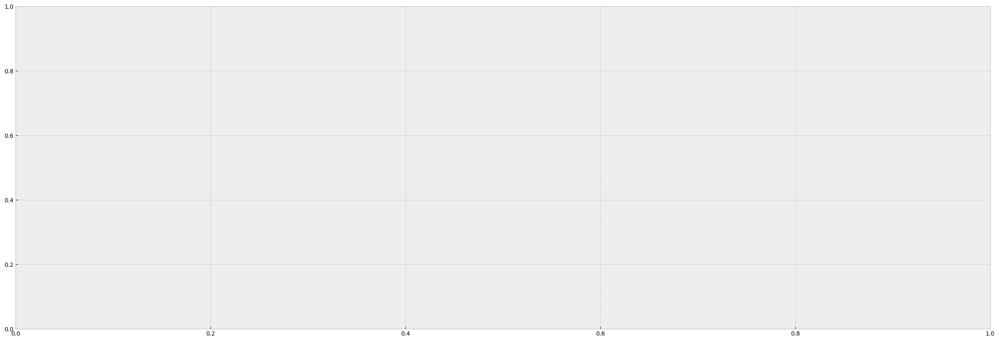

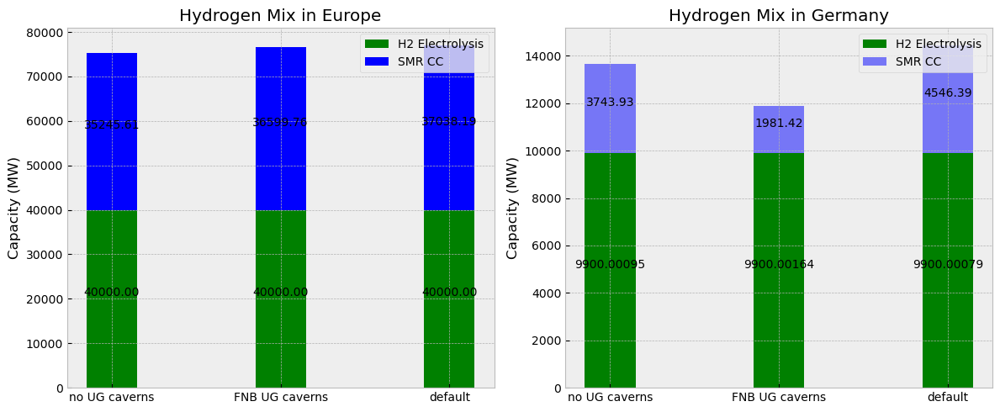

In [50]:

# Plotting Hydrogen mix

cases = ["no UG caverns", "FNB UG caverns", "default"]
H2_Electrolysis = [round(green_h2_c1,2), round(green_h2_c2,2), round(green_h2_c3,2)]
SMR_CC = [round(blue_h2_c1,2), round(blue_h2_c2,2), round(blue_h2_c3,2)]

H2_Electrolysis_DE = [round(green_h2_c1_DE,5), round(green_h2_c2_DE,5), round(green_h2_c3_DE,5)]
SMR_CC_DE = [round(blue_h2_c1_DE,2), round(blue_h2_c2_DE,2), round(blue_h2_c3_DE,5)]

fig, ax = plt.subplots()

# Calculate the total installed capacity for each case
total_h2_mix = [sum(capacities) for capacities in zip(H2_Electrolysis, SMR_CC)]
total_h2_mix_DE = [sum(capacities_DE) for capacities_DE in zip(H2_Electrolysis_DE, SMR_CC_DE)]



fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
# Plot Europe's hydrogen mix on the first subplot
bar_width = 0.3
bar_positions = np.arange(len(cases))

ax1.bar(bar_positions, H2_Electrolysis, bar_width, label='H2 Electrolysis', color='green')
ax1.bar(bar_positions, SMR_CC, bar_width, label='SMR CC', color='blue', bottom=H2_Electrolysis)
#ax1.set_xlabel("Cases")
ax1.set_ylabel("Capacity (MW)")
ax1.set_title("Hydrogen Mix in Europe")

# Add data labels for H2 Electrolysis and SMR CC in Europe
for i in range(len(cases)):
    ax1.text(bar_positions[i], H2_Electrolysis[i] / 2, f'{H2_Electrolysis[i]:.2f}', ha='center', va='bottom', fontsize=10)
    ax1.text(bar_positions[i], H2_Electrolysis[i] + (SMR_CC[i] / 2), f'{SMR_CC[i]:.2f}', ha='center', va='bottom', fontsize=10)

# Annotate "EU" over the bars in the Europe subplot
#for i, case in enumerate(cases):
#    ax1.annotate("EU", (bar_positions[i] + bar_width / 2, total_h2_mix[i] + 25), ha='center', va='bottom')

#ax1.legend(loc='upper left')

# Plot Germany's hydrogen mix on the second subplot
ax2.bar(bar_positions, H2_Electrolysis_DE, bar_width, label='H2 Electrolysis', color='green')
ax2.bar(bar_positions, SMR_CC_DE, bar_width, label='SMR CC', color='blue', alpha=0.5, bottom=H2_Electrolysis_DE)
#ax2.set_xlabel("Cases")
ax2.set_ylabel("Capacity (MW)")
ax2.set_title("Hydrogen Mix in Germany")

# Add data labels for H2 Electrolysis and SMR CC in Germany
for i in range(len(cases)):
    ax2.text(bar_positions[i], H2_Electrolysis_DE[i] / 2, f'{H2_Electrolysis_DE[i]:.5f}', ha='center', va='bottom', fontsize=10)
    ax2.text(bar_positions[i], H2_Electrolysis_DE[i] + (SMR_CC_DE[i] / 2), f'{SMR_CC_DE[i]:.2f}', ha='center', va='bottom', fontsize=10)

# Annotate "DE" over the bars in the Germany subplot
#for i, case in enumerate(cases):
#    ax2.annotate("DE", (bar_positions[i] + bar_width / 2, total_h2_mix_DE[i] + 25), ha='center', va='bottom')

ax1.legend(loc='upper right')
ax2.legend(loc='upper right')

plt.sca(ax1)
plt.xticks(bar_positions, cases)
plt.sca(ax2)
plt.xticks(bar_positions, cases)

plt.tight_layout()
plt.show()

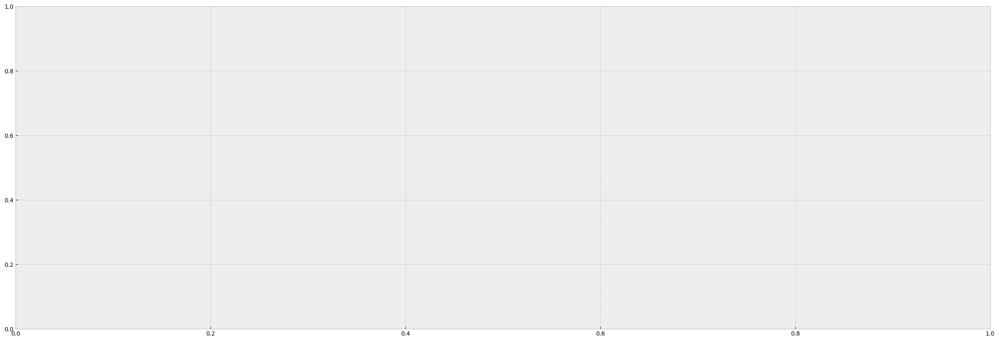

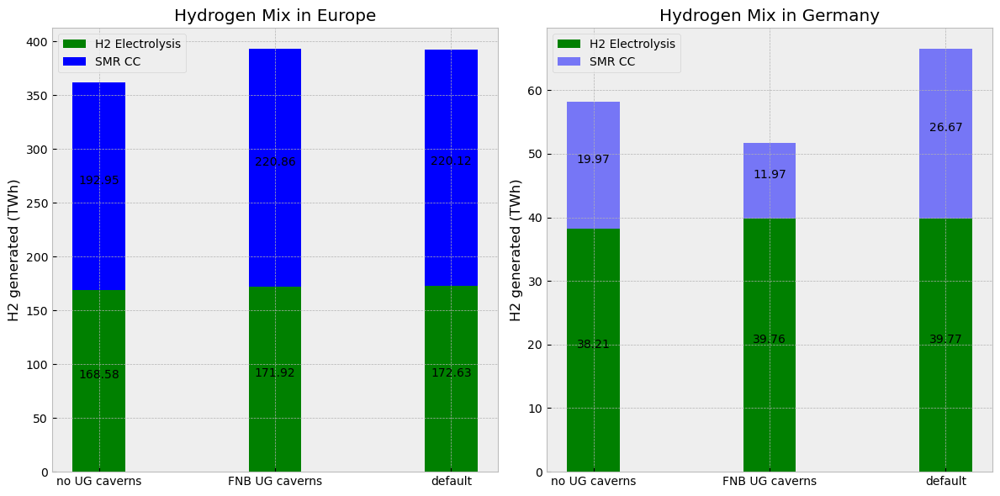

In [51]:

# Plotting Hydrogen mix by hydrogen generated from electrolyzer and SMR CC

cases = ["no UG caverns", "FNB UG caverns", "default"]
H2_Electrolysis_generated = [round(green_h2_c1_supply,2), round(green_h2_c2_supply,2), round(green_h2_c3_supply,2)]
SMR_CC_generated = [round(blue_h2_c1_supply,2), round(blue_h2_c2_supply,2), round(blue_h2_c3_supply,2)]

H2_Electrolysis_DE_generated = [round(green_h2_c1_DE_supply,2), round(green_h2_c2_DE_supply,2), round(green_h2_c3_DE_supply,2)]
SMR_CC_DE_generated = [round(blue_h2_c1_DE_supply,2), round(blue_h2_c2_DE_supply,2), round(blue_h2_c3_DE_supply,2)]

fig, ax = plt.subplots()

# Calculate the total h2 generated for each case
total_h2_generated_mix = [sum(capacities) for capacities in zip(H2_Electrolysis_generated, SMR_CC_generated)]
total_h2_generated_mix_DE = [sum(capacities_DE) for capacities_DE in zip(H2_Electrolysis_DE_generated, SMR_CC_DE_generated)]



fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
# Plot Europe's hydrogen mix on the first subplot
bar_width = 0.3
bar_positions = np.arange(len(cases))

ax1.bar(bar_positions, H2_Electrolysis_generated, bar_width, label='H2 Electrolysis', color='green')
ax1.bar(bar_positions, SMR_CC_generated, bar_width, label='SMR CC', color='blue', bottom=H2_Electrolysis_generated)
#ax1.set_xlabel("Cases")
ax1.set_ylabel("H2 generated (TWh)")
ax1.set_title("Hydrogen Mix in Europe")

# Add data labels for H2 Electrolysis and SMR CC in Europe
for i in range(len(cases)):
    ax1.text(bar_positions[i], H2_Electrolysis_generated[i] / 2, f'{H2_Electrolysis_generated[i]:.2f}', ha='center', va='bottom', fontsize=10)
    ax1.text(bar_positions[i], H2_Electrolysis_generated[i] + (SMR_CC_generated[i] / 2), f'{SMR_CC_generated[i]:.2f}', ha='center', va='bottom', fontsize=10)

# Annotate "EU" over the bars in the Europe subplot
#for i, case in enumerate(cases):
#    ax1.annotate("EU", (bar_positions[i] + bar_width / 2, total_h2_mix[i] + 25), ha='center', va='bottom')

#ax1.legend(loc='upper left')

# Plot Germany's hydrogen mix on the second subplot
ax2.bar(bar_positions, H2_Electrolysis_DE_generated, bar_width, label='H2 Electrolysis', color='green')
ax2.bar(bar_positions, SMR_CC_DE_generated, bar_width, label='SMR CC', color='blue', alpha=0.5, bottom=H2_Electrolysis_DE_generated)
#ax2.set_xlabel("Cases")
ax2.set_ylabel("H2 generated (TWh)")
ax2.set_title("Hydrogen Mix in Germany")

# Add data labels for H2 Electrolysis and SMR CC in Germany
for i in range(len(cases)):
    ax2.text(bar_positions[i], H2_Electrolysis_DE_generated[i] / 2, f'{H2_Electrolysis_DE_generated[i]:.2f}', ha='center', va='bottom', fontsize=10)
    ax2.text(bar_positions[i], H2_Electrolysis_DE_generated[i] + (SMR_CC_DE_generated[i] / 2), f'{SMR_CC_DE_generated[i]:.2f}', ha='center', va='bottom', fontsize=10)

# Annotate "DE" over the bars in the Germany subplot
#for i, case in enumerate(cases):
#    ax2.annotate("DE", (bar_positions[i] + bar_width / 2, total_h2_mix_DE[i] + 25), ha='center', va='bottom')

ax1.legend(loc='best')
ax2.legend(loc='best')

plt.sca(ax1)
plt.xticks(bar_positions, cases)
plt.sca(ax2)
plt.xticks(bar_positions, cases)

plt.tight_layout()
plt.show()

In [58]:
# optimal storage capacities
case1.storage_units.groupby("carrier").p_nom_opt.sum() / 1e3 #GW

carrier
PHS       54.333903
hydro    101.062892
Name: p_nom_opt, dtype: float64

In [59]:
case2.storage_units.groupby("carrier").p_nom_opt.sum() / 1e3 #GW

carrier
PHS       54.333903
hydro    101.062892
Name: p_nom_opt, dtype: float64

In [60]:
case3.storage_units.groupby("carrier").p_nom_opt.sum() / 1e3 #GW

carrier
PHS       54.333903
hydro    101.062892
Name: p_nom_opt, dtype: float64

In [61]:
case1_allstores=(case1.stores.groupby("carrier").e_nom_opt.sum() / 1e3) #GWh
allstore1=pd.DataFrame(case1_allstores).reset_index()
allstore1.rename(columns={'e_nom_opt': 'no_UG_caverns'}, inplace=True)
allstore1

,carrier,no_UG_caverns
0,H2 Store,5.435887e+01
1,battery,9.885961e+02
2,battery storage,1.600288e+03
3,biogas,3.455584e+05
4,co2,1.338093e+06
5,co2 stored,2.000000e+05
6,gas,1.824880e+06
7,home battery,1.291257e-03
8,methanol,5.752550e+06
9,oil,5.282274e+06


In [62]:
case2_allstores=(case2.stores.groupby("carrier").e_nom_opt.sum() / 1e3) #GWh
allstore2=pd.DataFrame(case2_allstores).reset_index()
allstore2.rename(columns={'e_nom_opt': 'FNB_UG_caverns'}, inplace=True)
allstore2

,carrier,FNB_UG_caverns
0,H2 Store,6.596103e+03
1,battery,9.909782e+02
2,battery storage,1.600288e+03
3,biogas,3.455584e+05
4,co2,1.338093e+06
5,co2 stored,2.000000e+05
6,gas,4.502679e+06
7,home battery,1.706162e-03
8,methanol,8.750103e+06
9,oil,8.480838e+06


In [64]:
case3_allstores=(case3.stores.groupby("carrier").e_nom_opt.sum() / 1e3) #GWh
allstore3=pd.DataFrame(case3_allstores).reset_index()
allstore3.rename(columns={'e_nom_opt': 'default'}, inplace=True)
allstore3

,carrier,default
0,H2 Store,2.023246e+03
1,battery,9.857618e+02
2,battery storage,1.600288e+03
3,biogas,3.455584e+05
4,co2,1.338093e+06
5,co2 stored,2.000000e+05
6,gas,3.556015e+06
7,home battery,1.137946e-03
8,methanol,7.739746e+06
9,oil,7.341425e+06


In [65]:
allstores_merged = allstore1.merge(allstore2, on='carrier').merge(allstore3, on='carrier')
allstores_merged

,carrier,no_UG_caverns,FNB_UG_caverns,default
0,H2 Store,5.435887e+01,6.596103e+03,2.023246e+03
1,battery,9.885961e+02,9.909782e+02,9.857618e+02
2,battery storage,1.600288e+03,1.600288e+03,1.600288e+03
3,biogas,3.455584e+05,3.455584e+05,3.455584e+05
4,co2,1.338093e+06,1.338093e+06,1.338093e+06
5,co2 stored,2.000000e+05,2.000000e+05,2.000000e+05
6,gas,1.824880e+06,4.502679e+06,3.556015e+06
7,home battery,1.291257e-03,1.706162e-03,1.137946e-03
8,methanol,5.752550e+06,8.750103e+06,7.739746e+06
9,oil,5.282274e+06,8.480838e+06,7.341425e+06


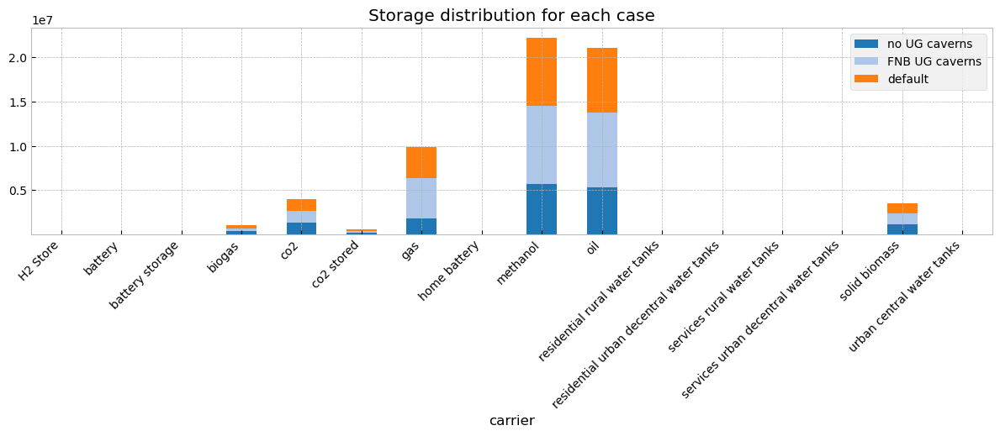

In [66]:
colors = plt.cm.tab20(np.linspace(0, 1, len(allstores_merged)))

# Plotting
fig, ax = plt.subplots(figsize=(12, 6))
allstores_merged.set_index('carrier').plot(kind='bar', stacked=True, color=colors, ax=ax)
#allstores_merged.set_ylabel('e_nom_opt (GWh)')
ax.set_title('Storage distribution for each case')
ax.set_facecolor('white')
ax.legend(["no UG caverns", "FNB UG caverns", "default"])

# Display the plot
plt.tight_layout()
plt.xticks(rotation=45, ha='right')
plt.show()

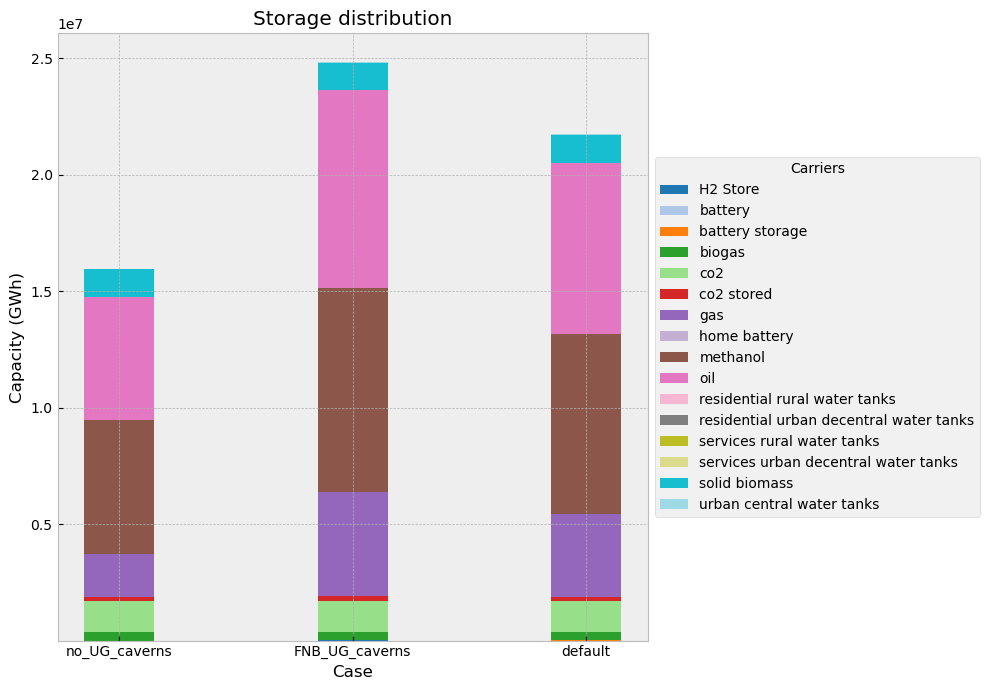

In [67]:
# Transpose the dataframe for plotting
allstores_merged_transposed = allstores_merged.set_index('carrier').T

# Define the colormap
colors = plt.cm.tab20(np.linspace(0, 1, len(allstores_merged_transposed.columns)))

# Create a new figure and axis
fig, ax = plt.subplots(figsize=(10, 7))

# Plot each carrier one by one in a stacked manner
bottom_values = np.zeros(len(allstores_merged_transposed))
for idx, column in enumerate(allstores_merged_transposed.columns):
    ax.bar(allstores_merged_transposed.index, allstores_merged_transposed[column], bottom=bottom_values, label=column, color=colors[idx], width=0.3)
    bottom_values += allstores_merged_transposed[column].values

ax.set_ylabel('Capacity (GWh)')
ax.set_xlabel('Case')
ax.set_title('Storage distribution')
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Carriers')

plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [68]:
cases = ["no UG caverns", "FNB UG caverns", "default"]


In [72]:
# optimal generator
gen1=case1.generators.groupby("carrier").p_nom_opt.sum() / 1e3 #GW
allgen1=pd.DataFrame(gen1).reset_index()
allgen1.rename(columns={'p_nom_opt': 'no_UG_caverns'}, inplace=True)
allgen1

,carrier,no_UG_caverns
0,gas,587.576761
1,offwind-ac,15.475643
2,offwind-dc,60.643199
3,oil,491.527608
4,onwind,991.349452
5,residential rural solar thermal,0.000139
6,residential urban decentral solar thermal,0.000179
7,ror,49.417591
8,services rural solar thermal,0.000134
9,services urban decentral solar thermal,0.000158


In [73]:
gen2=case2.generators.groupby("carrier").p_nom_opt.sum() / 1e3 #GW
allgen2=pd.DataFrame(gen2).reset_index()
allgen2.rename(columns={'p_nom_opt': 'FNB_UG_caverns'}, inplace=True)
allgen2

,carrier,FNB_UG_caverns
0,gas,592.903351
1,offwind-ac,15.564048
2,offwind-dc,61.098145
3,oil,604.444945
4,onwind,994.443089
5,residential rural solar thermal,0.000218
6,residential urban decentral solar thermal,0.000274
7,ror,49.417591
8,services rural solar thermal,0.000211
9,services urban decentral solar thermal,0.000246


In [74]:
gen3=case3.generators.groupby("carrier").p_nom_opt.sum() / 1e3 #GW
allgen3=pd.DataFrame(gen3).reset_index()
allgen3.rename(columns={'p_nom_opt': 'default'}, inplace=True)
allgen3

,carrier,default
0,gas,586.042701
1,offwind-ac,15.561250
2,offwind-dc,61.052678
3,oil,506.753266
4,onwind,995.680601
5,residential rural solar thermal,0.000144
6,residential urban decentral solar thermal,0.000184
7,ror,49.417591
8,services rural solar thermal,0.000139
9,services urban decentral solar thermal,0.000165


In [75]:
allgen_merged = allgen1.merge(allgen2, on='carrier').merge(allgen3, on='carrier')
allgen_merged

,carrier,no_UG_caverns,FNB_UG_caverns,default
0,gas,587.576761,592.903351,586.042701
1,offwind-ac,15.475643,15.564048,15.561250
2,offwind-dc,60.643199,61.098145,61.052678
3,oil,491.527608,604.444945,506.753266
4,onwind,991.349452,994.443089,995.680601
5,residential rural solar thermal,0.000139,0.000218,0.000144
6,residential urban decentral solar thermal,0.000179,0.000274,0.000184
7,ror,49.417591,49.417591,49.417591
8,services rural solar thermal,0.000134,0.000211,0.000139
9,services urban decentral solar thermal,0.000158,0.000246,0.000165


In [87]:
capex_store1=case1.statistics()["Capital Expenditure"].div(1e6).filter(like="Store").sort_values()#.dropna().plot.bar(ylabel="meuro/a", cmap="tab20c", figsize=(7,3))
capex_store1_df=pd.DataFrame(capex_store1).reset_index()
capex_store1_df.rename(columns={'Capital Expenditure': 'no_UG_caverns'}, inplace=True)
capex_store1_df

,level_0,carrier,no_UG_caverns
0,Store,battery storage,0.000000
1,Store,biogas,0.000000
2,Store,co2,0.000000
3,Store,methanol,0.000000
4,Store,oil,0.000000
5,Store,solid biomass,0.000000
6,Store,home battery,0.022482
7,Store,gas,25.548314
8,Store,H2 Store,223.830071
9,Store,services rural water tanks,351.329394


In [88]:
capex_store2=case2.statistics()["Capital Expenditure"].div(1e6).filter(like="Store").sort_values()
capex_store2_df=pd.DataFrame(capex_store2).reset_index()
capex_store2_df.rename(columns={'Capital Expenditure': 'FNB_UG_caverns'}, inplace=True)
capex_store2_df

,level_0,carrier,FNB_UG_caverns
0,Store,battery storage,0.000000
1,Store,biogas,0.000000
2,Store,co2,0.000000
3,Store,methanol,0.000000
4,Store,oil,0.000000
5,Store,solid biomass,0.000000
6,Store,home battery,0.029706
7,Store,gas,63.037504
8,Store,services rural water tanks,351.564364
9,Store,services urban decentral water tanks,440.914357


In [89]:
capex_store3=case3.statistics()["Capital Expenditure"].div(1e6).filter(like="Store").sort_values()
capex_store3_df=pd.DataFrame(capex_store3).reset_index()
capex_store3_df.rename(columns={'Capital Expenditure': 'default'}, inplace=True)
capex_store3_df

,level_0,carrier,default
0,Store,battery storage,0.000000
1,Store,biogas,0.000000
2,Store,co2,0.000000
3,Store,methanol,0.000000
4,Store,oil,0.000000
5,Store,solid biomass,0.000000
6,Store,home battery,0.019813
7,Store,gas,49.784212
8,Store,H2 Store,288.840851
9,Store,services rural water tanks,351.685082


In [90]:
capex_allstores = capex_store1_df.merge(capex_store2_df, on='carrier').merge(capex_store3_df, on='carrier')
capex_allstores_df=capex_allstores.drop(["level_0_x", "level_0_y", "level_0"], axis=1)
capex_allstores_df

,carrier,no_UG_caverns,FNB_UG_caverns,default
0,battery storage,0.000000,0.000000,0.000000
1,biogas,0.000000,0.000000,0.000000
2,co2,0.000000,0.000000,0.000000
3,methanol,0.000000,0.000000,0.000000
4,oil,0.000000,0.000000,0.000000
5,solid biomass,0.000000,0.000000,0.000000
6,home battery,0.022482,0.029706,0.019813
7,gas,25.548314,63.037504,49.784212
8,H2 Store,223.830071,927.395696,288.840851
9,services rural water tanks,351.329394,351.564364,351.685082


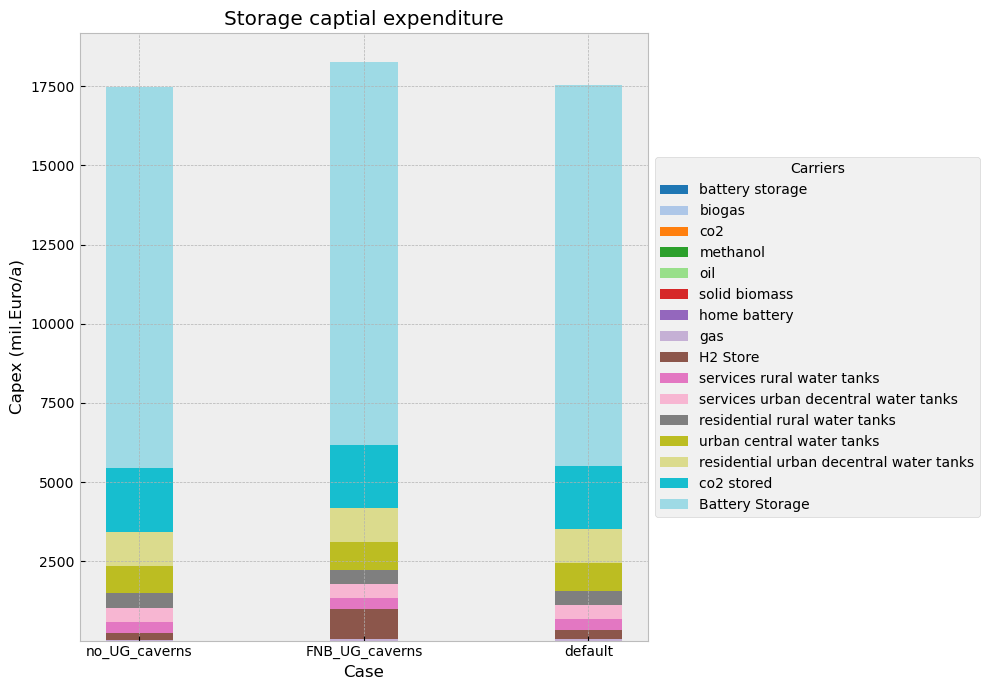

In [91]:
capex_allstores_df_transposed = capex_allstores_df.set_index('carrier').T

# Define the colormap
colors = plt.cm.tab20(np.linspace(0, 1, len(capex_allstores_df_transposed.columns)))

# Create a new figure and axis
fig, ax = plt.subplots(figsize=(10, 7))

# Plot each carrier one by one in a stacked manner
bottom_values = np.zeros(len(capex_allstores_df_transposed))
for idx, column in enumerate(capex_allstores_df_transposed.columns):
    ax.bar(capex_allstores_df_transposed.index, capex_allstores_df_transposed[column], bottom=bottom_values, label=column, color=colors[idx], width=0.3)
    bottom_values += capex_allstores_df_transposed[column].values

ax.set_ylabel('Capex (mil.Euro/a)')
ax.set_xlabel('Case')
ax.set_title('Storage captial expenditure')
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Carriers')

plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [109]:
wind_supply1 = (case1.snapshot_weightings.generators @ case1.generators_t.p.filter(like='wind').div(1e6))#.sum() # TWh, energy supply from wind
wind_supply1


Generator
AL1 0 offwind-ac    1.656286e-07
AL1 0 onwind        1.940258e-08
AT1 0 onwind        2.004988e+01
AT1 1 onwind        3.388807e-03
AT1 2 onwind        1.587898e-01
                        ...     
SE2 7 offwind-dc    5.636756e-06
SE2 7 onwind        2.277735e+00
SI1 0 offwind-ac    1.462854e-07
SI1 0 onwind        2.758301e-03
SK1 0 onwind        4.363390e-03
Name: generators, Length: 431, dtype: float64

In [110]:
onwind1 = (case1.generators.p_nom_opt.filter(like='onwind')).sum() # MW, wind power capacity
onwind1

991349.4521528977

In [111]:
offwind1 = (case1.generators.p_nom_opt.filter(like='offwind')).sum() # MW, wind power capacity
offwind1

76118.84246805377

In [112]:
solar1 = (case1.generators.p_nom_opt.filter(like='solar')).sum() # MW, wind power capacity
solar1

1649201.1674751348

In [118]:
case2.statistics()["Capital Expenditure"].div(1e6).filter(like="Store")

       carrier                                
Store  Battery Storage                            12075.162507
       H2 Store                                     927.395696
       battery storage                                0.000000
       biogas                                         0.000000
       co2                                            0.000000
       co2 stored                                  2000.000000
       gas                                           63.037504
       home battery                                   0.029706
       methanol                                       0.000000
       oil                                            0.000000
       residential rural water tanks                450.123467
       residential urban decentral water tanks     1069.161475
       services rural water tanks                   351.564364
       services urban decentral water tanks         440.914357
       solid biomass                                  0.000000
       u

In [119]:
case2.statistics.capex().filter(like="Store")

       carrier                                
Store  Battery Storage                            1.207516e+10
       H2 Store                                   9.273957e+08
       battery storage                            0.000000e+00
       biogas                                     0.000000e+00
       co2                                        0.000000e+00
       co2 stored                                 2.000000e+09
       gas                                        6.303750e+07
       home battery                               2.970591e+04
       methanol                                   0.000000e+00
       oil                                        0.000000e+00
       residential rural water tanks              4.501235e+08
       residential urban decentral water tanks    1.069161e+09
       services rural water tanks                 3.515644e+08
       services urban decentral water tanks       4.409144e+08
       solid biomass                              0.000000e+00
       u

In [120]:
case1.statistics()["Optimal Capacity"].filter(like="Store").div(1e6) #TWh


       carrier                                
Store  Battery Storage                               0.988596
       H2 Store                                      0.054359
       battery storage                               1.600288
       biogas                                      345.558371
       co2                                        1338.092536
       co2 stored                                  200.000000
       gas                                        1824.879548
       home battery                                  0.000001
       methanol                                   5752.550225
       oil                                        5282.273674
       residential rural water tanks                 0.293282
       residential urban decentral water tanks       0.696247
       services rural water tanks                    0.228695
       services urban decentral water tanks          0.287545
       solid biomass                              1185.644349
       urban central wa

In [121]:
case2.statistics()["Optimal Capacity"].filter(like="Store").div(1e6) #TWh

       carrier                                
Store  Battery Storage                               0.990978
       H2 Store                                      6.596103
       battery storage                               1.600288
       biogas                                      345.558371
       co2                                        1338.092536
       co2 stored                                  200.000000
       gas                                        4502.678878
       home battery                                  0.000002
       methanol                                   8750.102657
       oil                                        8480.837697
       residential rural water tanks                 0.293005
       residential urban decentral water tanks       0.695963
       services rural water tanks                    0.228848
       services urban decentral water tanks          0.287010
       solid biomass                              1185.644349
       urban central wa

In [122]:
case3.statistics()["Optimal Capacity"].filter(like="Store").div(1e6) #TWh

       carrier                                
Store  Battery Storage                               0.985762
       H2 Store                                      2.023246
       battery storage                               1.600288
       biogas                                      345.558371
       co2                                        1338.092536
       co2 stored                                  200.000000
       gas                                        3556.015128
       home battery                                  0.000001
       methanol                                   7739.746311
       oil                                        7341.424986
       residential rural water tanks                 0.292694
       residential urban decentral water tanks       0.694308
       services rural water tanks                    0.228927
       services urban decentral water tanks          0.285989
       solid biomass                              1185.644349
       urban central wa

In [123]:
case2.statistics()["Optimal Capacity"].filter(like='methanol') #MW

       carrier                    
Link   methanolisation                2.534981e+04
Load   shipping methanol                       NaN
       shipping methanol emissions             NaN
Store  methanol                       8.750103e+09
Name: Optimal Capacity, dtype: float64

In [124]:
case2.statistics()["Optimal Capacity"].filter(like='H2') #MW, store is in MWh

       carrier        
Link   H2 Electrolysis    4.000000e+04
       H2 Fuel Cell       7.013624e-02
       H2 pipeline        1.037970e+05
Load   H2 for industry             NaN
Store  H2 Store           6.596103e+06
Name: Optimal Capacity, dtype: float64

In [125]:
case2.statistics()["Optimal Capacity"].filter(like='battery') #MW

       carrier                
Link   battery charger            1.008320e+05
       battery discharger         1.029112e+05
       home battery charger       4.077138e-01
       home battery discharger    4.161211e-01
Store  battery storage            1.600288e+06
       home battery               1.706162e+00
Name: Optimal Capacity, dtype: float64

In [126]:
case2.statistics()["Capital Expenditure"].filter(like='H2')

       carrier        
Link   H2 Electrolysis    1.639880e+09
       H2 Fuel Cell       8.608301e+03
       H2 pipeline        3.168175e+08
Load   H2 for industry             NaN
Store  H2 Store           9.273957e+08
Name: Capital Expenditure, dtype: float64

In [127]:
case2.statistics()["Capital Expenditure"].filter(like='methanol')

       carrier                    
Link   methanolisation                1.803015e+09
Load   shipping methanol                       NaN
       shipping methanol emissions             NaN
Store  methanol                       0.000000e+00
Name: Capital Expenditure, dtype: float64

In [128]:
case2.statistics()["Capital Expenditure"].filter(like='Battery')

       carrier        
Store  Battery Storage    1.207516e+10
Name: Capital Expenditure, dtype: float64

In [129]:
case2.statistics()["Supply"].filter(like='methanol')

       carrier                    
Link   methanolisation                18711.117359
Load   shipping methanol                  0.000000
       shipping methanol emissions     4640.539015
Store  methanol                        1870.157162
Name: Supply, dtype: float64

In [130]:
case2.statistics()["Supply"].filter(like='H2') #MWh

       carrier        
Link   H2 Electrolysis    19625.655569
       H2 Fuel Cell           0.013478
       H2 pipeline        76269.195444
Load   H2 for industry       25.114155
Store  H2 Store            5796.439898
Name: Supply, dtype: float64

In [131]:
case2.links[case2.links.carrier=="methanolisation"]

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,...,efficiency4,p_nom_opt,type,build_year,p_nom_max,p_set,p_max_pu,terrain_factor,ramp_limit_up,ramp_limit_down
Link,,,,,,,,,,,,,,,,,,,,,
AL1 0 methanolisation,AL1 0 H2,EU methanol,methanolisation,,0.0,0.0,,NaN,NaN,0.5,...,NaN,0.002068,,0,inf,0.0,1.0,1.0,NaN,NaN
AT1 0 methanolisation,AT1 0 H2,EU methanol,methanolisation,,0.0,0.0,,NaN,NaN,0.5,...,NaN,0.001182,,0,inf,0.0,1.0,1.0,NaN,NaN
AT1 1 methanolisation,AT1 1 H2,EU methanol,methanolisation,,0.0,0.0,,NaN,NaN,0.5,...,NaN,0.001233,,0,inf,0.0,1.0,1.0,NaN,NaN
AT1 2 methanolisation,AT1 2 H2,EU methanol,methanolisation,,0.0,0.0,,NaN,NaN,0.5,...,NaN,0.001200,,0,inf,0.0,1.0,1.0,NaN,NaN
AT1 3 methanolisation,AT1 3 H2,EU methanol,methanolisation,,0.0,0.0,,NaN,NaN,0.5,...,NaN,0.001119,,0,inf,0.0,1.0,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SE2 5 methanolisation,SE2 5 H2,EU methanol,methanolisation,,0.0,0.0,,NaN,NaN,0.5,...,NaN,0.003333,,0,inf,0.0,1.0,1.0,NaN,NaN
SE2 6 methanolisation,SE2 6 H2,EU methanol,methanolisation,,0.0,0.0,,NaN,NaN,0.5,...,NaN,0.006168,,0,inf,0.0,1.0,1.0,NaN,NaN
SE2 7 methanolisation,SE2 7 H2,EU methanol,methanolisation,,0.0,0.0,,NaN,NaN,0.5,...,NaN,0.012850,,0,inf,0.0,1.0,1.0,NaN,NaN


In [157]:
# check shipping h2
(case1.snapshot_weightings.generators @ case1.loads_t.p.filter(like='H2 for shipping').div(1e6)).sum() #TWh

0.0

In [158]:
# check how much is 30% of shipping_methanol_share
(case1.snapshot_weightings.generators @ case1.loads_t.p.filter(like='shipping methanol').div(1e6)).sum() #TWh

123.25826632484717

In [159]:
# check how much is 70% of shipping_oil_share
(case1.snapshot_weightings.generators @ case1.loads_t.p.filter(like='shipping oil').div(1e6)).sum() #TWh

325.46940829761763

In [160]:
(case1.snapshot_weightings.generators @ case1.generators_t.p.filter(like='oil').div(1e6))#.sum() #TWh # oil suppy

Generator
EU oil    4007.868102
Name: generators, dtype: float64

In [161]:
case1.generators_t.p.filter(like="oil").sum().div(1e6)*8760 # oil supply

Generator
EU oil    5.851487e+06
dtype: float64

In [162]:
case1.loads.p_set.filter(like='oil')#.div(1e6)*8760 # shipping oil demand

Load
AL1 0 land transport oil                   0.000000
AT1 0 land transport oil                   0.000000
AT1 1 land transport oil                   0.000000
AT1 2 land transport oil                   0.000000
AT1 3 land transport oil                   0.000000
                                           ...     
EU oil shipping oil                    50208.164923
shipping oil emissions                -13054.122880
oil emissions                         -36889.371000
agriculture machinery oil               9888.803758
agriculture machinery oil emissions    -2571.088977
Name: p_set, Length: 262, dtype: float64

In [164]:
# check shipping h2
(case2.snapshot_weightings.generators @ case2.loads_t.p.filter(like='H2 for shipping').div(1e6)).sum() #TWh

0.0

In [165]:
# check how much is 30% of shipping_methanol_share
(case2.snapshot_weightings.generators @ case2.loads_t.p.filter(like='shipping methanol').div(1e6)).sum() #TWh

123.25826632484717

In [166]:
# check how much is 70% of shipping_oil_share
(case2.snapshot_weightings.generators @ case2.loads_t.p.filter(like='shipping oil').div(1e6)).sum() #TWh

325.46940829761763

In [167]:
# check shipping h2
(case3.snapshot_weightings.generators @ case3.loads_t.p.filter(like='H2 for shipping').div(1e6)).sum() #TWh

0.0

In [168]:
# check how much is 30% of shipping_methanol_share
(case3.snapshot_weightings.generators @ case3.loads_t.p.filter(like='shipping methanol').div(1e6)).sum() #TWh

123.25826632484717

In [169]:
case3.loads.p_set.filter(like="methanol")#.multiply(case3.snapshot_weightings.generators)

Load
EU methanol shipping methanol    18711.117363
shipping methanol emissions      -4640.539015
Name: p_set, dtype: float64

In [170]:
# check how much is 70% of shipping_oil_share
(case3.snapshot_weightings.generators @ case3.loads_t.p.filter(like='shipping oil').div(1e6)).sum() #TWh

325.46940829761763

In [171]:
# check how much methanol is produced from h2
(case1.snapshot_weightings.generators @ case1.links_t.p1.filter(like='methanolisation').abs().div(1e6)).sum() #TWh

163.9093880707794

In [172]:
# check how much methanol is produced from h2
(case2.snapshot_weightings.generators @ case2.links_t.p1.filter(like='methanolisation').abs().div(1e6)).sum() #TWh

163.90938806143137

In [173]:
# check how much methanol is produced from h2
(case3.snapshot_weightings.generators @ case3.links_t.p1.filter(like='methanolisation').abs().div(1e6)).sum() #TWh

163.90938807975073

In [211]:
wind1=case1.generators_t.p.filter(like='wind').filter(like="DE").div(1e3).sum(axis=1)
solar1=case1.generators_t.p.filter(like='solar').filter(like="DE").div(1e3).sum(axis=1)
ror1=case1.generators_t.p.filter(like='ror').filter(like="DE").div(1e3).sum(axis=1)

load1=case1.loads_t.p_set.filter(like="DE").div(1e3).sum(axis=1)
h2_demand1=case1.loads_t.p.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_supply1=case1.links_t.p1.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)

h2_dispatch1=case1.stores_t.p.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_store_level1=case1.stores_t.e.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_store_max1=case1.stores.e_nom_opt.filter(like="H2").filter(like="DE").div(1e3).sum()
h2_SOC1=h2_store_level1/h2_store_max1*100

battery_dispatch1=case1.stores_t.p.filter(like="battery").filter(like="DE").div(1e3).sum(axis=1)# GW
battery_level1=case1.stores_t.e.filter(like="battery").filter(like="DE").div(1e3).sum(axis=1)
battery_max1=case1.stores.e_nom_opt.filter(like="battery").filter(like="DE").div(1e3).sum()
battery_SOC1=battery_level1/battery_max1*100

watertank_dispatch1=case1.stores_t.p.filter(like="water tanks").filter(like="DE").div(1e3).sum(axis=1)# GW
watertank_level1=case1.stores_t.e.filter(like="water tanks").filter(like="DE").div(1e3).sum(axis=1)
watertank_max1=case1.stores.e_nom_opt.filter(like="water tanks").filter(like="DE").div(1e3).sum()
watertank_SOC1=watertank_level1/watertank_max1*100


hydro_dispatch2=case2.storage_units_t.p.filter(like="hydro").filter(like="DE").div(1e3).sum(axis=1)# GW
hydro_level2=case2.storage_units_t.state_of_charge.filter(like="hydro").filter(like="DE").div(1e3).sum(axis=1)
hydro_max2=hydro_level2.max()
hydro_SOC2=hydro_level2/hydro_max2*100

PHS_dispatch2=case2.storage_units_t.p.filter(like="PHS").filter(like="DE").div(1e3).sum(axis=1)# GW
PHS_level2=case2.storage_units_t.state_of_charge.filter(like="PHS").filter(like="DE").div(1e3).sum(axis=1)
PHS_max2=PHS_level2.max()
PHS_SOC2=PHS_level2/PHS_max2*100


In [212]:
case1.stores.e_nom_opt.filter(like="H2").filter(like="DE").div(1e3).sum() # maximum storage capacity


9.438867052034233

In [213]:
case1.stores_t.e.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1).describe()

count    1.460000e+03
mean     4.933998e+00
std      3.314004e+00
min      5.485252e-07
25%      1.834599e+00
50%      5.053523e+00
75%      8.141073e+00
max      9.438866e+00
dtype: float64

In [214]:
h2_store_level1/h2_store_max1

snapshot
2013-01-01 00:00:00    0.998185
2013-01-01 06:00:00    0.902638
2013-01-01 12:00:00    0.000620
2013-01-01 18:00:00    0.449309
2013-01-02 00:00:00    0.965276
                         ...   
2013-12-30 18:00:00    0.456400
2013-12-31 00:00:00    0.878390
2013-12-31 06:00:00    0.596535
2013-12-31 12:00:00    0.218945
2013-12-31 18:00:00    0.560204
Length: 1460, dtype: float64

In [215]:
case1.buses_t.marginal_price.filter(like="H2").filter(like="DE").describe()


Bus,DE1 0 H2,DE1 1 H2,DE1 10 H2,DE1 100 H2,DE1 101 H2,DE1 11 H2,DE1 12 H2,DE1 13 H2,DE1 14 H2,DE1 15 H2,...,DE1 90 H2,DE1 91 H2,DE1 92 H2,DE1 93 H2,DE1 94 H2,DE1 95 H2,DE1 96 H2,DE1 97 H2,DE1 98 H2,DE1 99 H2
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,96.774754,96.775869,96.324562,96.740204,96.450656,96.775652,96.775363,96.775380,95.960083,96.005052,...,96.531075,96.775298,96.775794,96.777102,96.739589,96.777628,96.776675,96.777381,96.777920,96.243471
std,50.145233,50.006221,50.350684,50.165705,50.228757,50.170971,49.161208,49.968722,50.752911,50.787643,...,50.169209,50.009918,49.406214,50.046640,49.992369,49.684651,50.049578,49.512174,50.032571,50.733949
min,84.401240,84.399631,25.410349,57.609623,25.408999,84.408705,84.408233,84.408401,0.057872,0.232974,...,29.966212,84.418304,84.409033,84.410460,31.458711,84.410186,84.410732,84.417076,84.396111,0.254390
25%,84.420208,84.410673,84.390986,84.411904,84.395557,84.409178,84.412284,84.410052,84.389881,84.378712,...,84.411482,84.429569,84.419359,84.427198,84.420251,84.419448,84.429765,84.428785,84.427883,84.409733
50%,89.513070,89.510247,89.330117,89.497043,89.488592,89.510686,89.485982,89.442715,89.385492,87.638277,...,89.515764,89.434725,89.488982,89.503147,89.426288,89.500277,89.516843,89.487924,89.514568,89.516931
75%,89.585581,90.205733,90.181678,89.596019,90.854701,89.595483,89.580067,89.604357,90.313352,89.699084,...,90.360013,89.622050,89.594200,89.583207,89.616850,89.611001,89.594289,89.604116,89.596458,89.622876
max,1003.639550,1003.638968,1003.629896,1003.649038,1003.638465,1003.651529,998.487334,1003.651025,1003.631689,1003.649042,...,1003.649375,1003.657806,1003.590510,1003.637555,1003.660357,1003.660673,1003.648327,1003.657974,1003.639374,1003.670245


In [216]:
# create time series dataframe in Germany for case 1
ts1 = pd.DataFrame(wind1)
ts1 = ts1.rename(columns={0:'wind [GW]'})
ts1["solar [GW]"] = solar1
ts1["load [GW]"] = load1
ts1["h2 demand [GW]"] = h2_demand1
ts1["h2 supply [GW]"] = h2_supply1
ts1["h2 dispatch [GW]"] = h2_dispatch1
ts1["h2 SOC [%]"] = h2_SOC1
ts1["battery dispatch [GW]"] = battery_dispatch1
ts1["battery SOC [%]"] = battery_SOC1

ts1["solar residual load"] = ts1["load [GW]"] - ts1["solar [GW]"]
ts1["wind residual load"] = ts1["load [GW]"] - ts1["wind [GW]"]
ts1.index = pd.to_datetime(ts1.index)
ts1.index = ts1.index.map(lambda x: x.replace(year=2030))
ts1

,wind [GW],solar [GW],load [GW],h2 demand [GW],h2 supply [GW],h2 dispatch [GW],h2 SOC [%],battery dispatch [GW],battery SOC [%],solar residual load,wind residual load
snapshot,,,,,,,,,,,
2030-01-01 00:00:00,115.874641,0.000000,179.087971,2.155251,-7.529146,-0.689007,99.818485,-12.173764,78.771053,179.087971,63.213330
2030-01-01 06:00:00,88.551864,14.331906,247.126318,2.155251,-8.030371,0.150309,90.263816,-9.040676,98.677973,232.794412,158.574454
2030-01-01 12:00:00,70.941100,6.832412,251.806775,2.155251,-7.584495,1.419005,0.062005,2.243845,93.737187,244.974363,180.865675
2030-01-01 18:00:00,78.500720,0.000000,188.813060,2.155251,-7.775160,-0.705852,44.930879,2.549871,88.122553,188.813060,110.312340
2030-01-02 00:00:00,84.521068,0.000000,193.367929,2.155251,-7.820645,-0.811691,96.527620,1.770469,84.224108,193.367929,108.846861
...,...,...,...,...,...,...,...,...,...,...,...
2030-12-30 18:00:00,91.816186,0.000000,214.679529,2.155251,-7.455596,-0.562342,45.640034,7.869063,60.064331,214.679529,122.863343
2030-12-31 00:00:00,75.302230,0.000000,208.075157,2.155251,-7.475786,-0.663851,87.839014,2.451636,54.666004,208.075157,132.772927
2030-12-31 06:00:00,59.024763,42.574836,287.021460,2.155251,-7.384691,0.443399,59.653464,-9.660522,75.937779,244.446624,227.996696


In [219]:
# maximum load
max_load1=ts1["load [GW]"].max()
# renewable capacity
ts1["RE"] = ts1["solar [GW]"] + ts1["wind [GW]"]
# capacity deficit
ts1["deficit [GW]"] = max_load1 - ts1["RE"] 

In [220]:
# find the time when load is max
ts1["load [GW]"].idxmax()

Timestamp('2030-01-25 12:00:00')

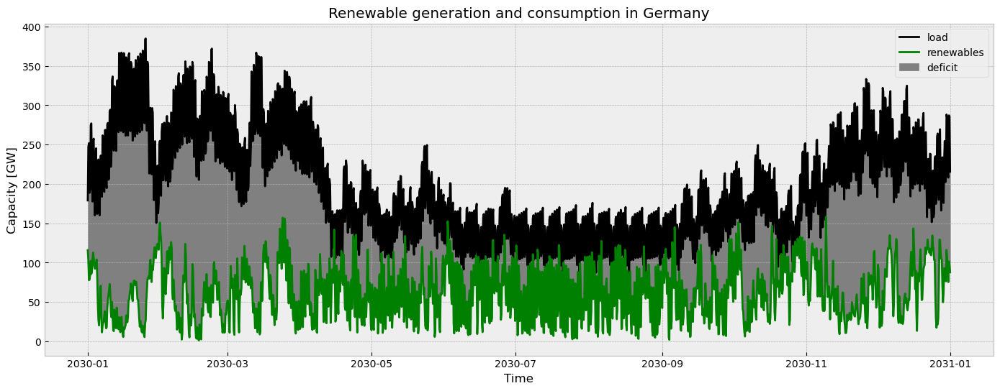

In [221]:
plt.figure(figsize=(17, 6))
plt.plot(ts1["load [GW]"], color="black", label="load")
plt.plot(ts1["RE"], color="green", label="renewables")
plt.fill_between(ts1["deficit [GW]"].index, ts1["load [GW]"], ts1["RE"], color="grey", label="deficit")
#plt.fill_between(ts2.index, ts2["load [TW]"].loc["2013-01"], ts2["RE"].loc["2013-01"], color="grey", label="deficit")

plt.xlabel("Time")
plt.ylabel("Capacity [GW]")
plt.title("Renewable generation and consumption in Germany")
plt.legend()
plt.show()

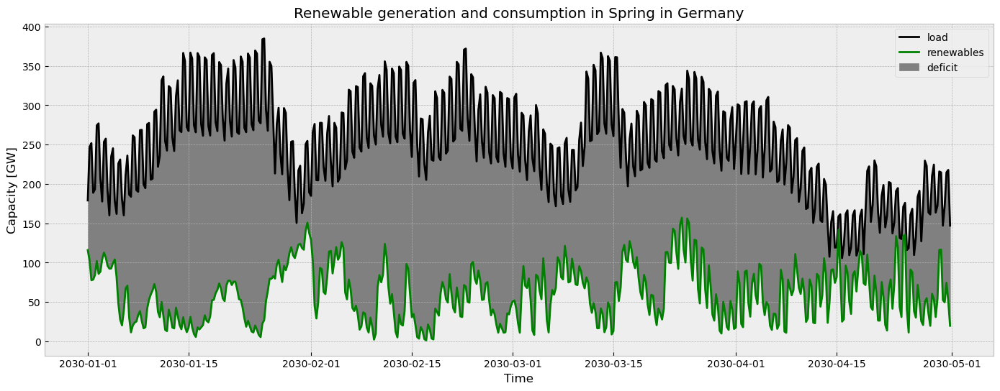

In [222]:
plt.figure(figsize=(17, 6))
plt.plot(ts1["load [GW]"].loc["2030-01":"2030-04"], color="black", label="load")
plt.plot(ts1["RE"].loc["2030-01":"2030-04"], color="green", label="renewables")
plt.fill_between(ts1["deficit [GW]"].loc["2030-01":"2030-04"].index, ts1["load [GW]"].loc["2030-01":"2030-04"], ts1["RE"].loc["2030-01":"2030-04"], color="grey", label="deficit")
#plt.fill_between(ts2.index, ts2["load [TW]"].loc["2013-01"], ts2["RE"].loc["2013-01"], color="grey", label="deficit")

plt.xlabel("Time")
plt.ylabel("Capacity [GW]")
plt.title("Renewable generation and consumption in Spring in Germany")
plt.legend()
plt.show()

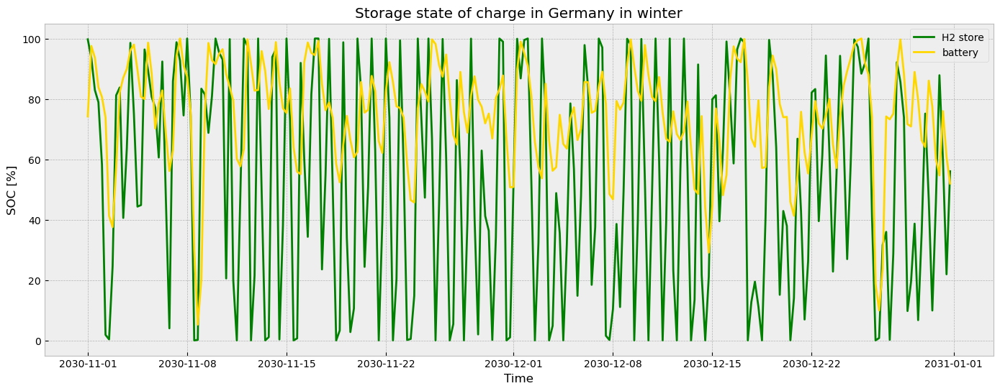

In [225]:

plt.figure(figsize=(17, 6))
plt.plot(ts1["h2 SOC [%]"].loc["2030-11":"2030-12"], color="green", label="H2 store")
plt.plot(ts1["battery SOC [%]"].loc["2030-11":"2030-12"], color="gold", label="battery")
plt.xlabel("Time")
plt.ylabel("SOC [%]")
plt.title("Storage state of charge in Germany in winter")
plt.legend()
plt.show()

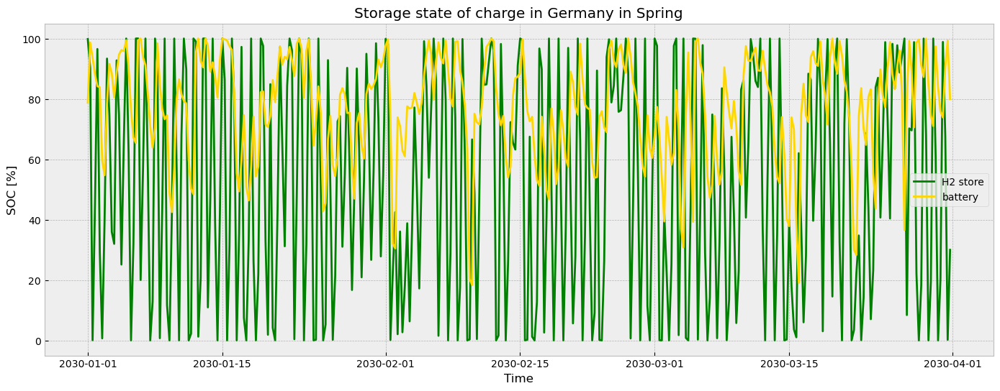

In [226]:
plt.figure(figsize=(17, 6))
plt.plot(ts1["h2 SOC [%]"].loc["2030-01":"2030-03"], color="green", label="H2 store")
plt.plot(ts1["battery SOC [%]"].loc["2030-01":"2030-03"], color="gold", label="battery")
plt.xlabel("Time")
plt.ylabel("SOC [%]")
plt.title("Storage state of charge in Germany in Spring")
plt.legend()
plt.show()

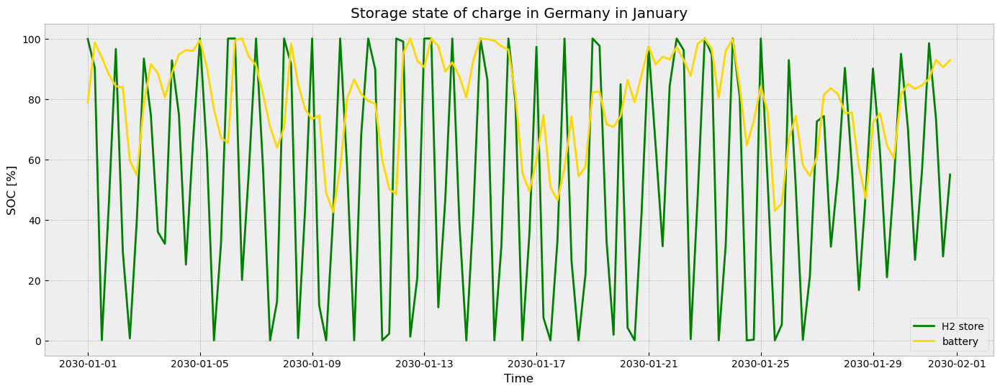

In [227]:
plt.figure(figsize=(17, 6))
plt.plot(ts1["h2 SOC [%]"].loc["2030-01"], color="green", label="H2 store")
plt.plot(ts1["battery SOC [%]"].loc["2030-01"], color="gold", label="battery")
plt.xlabel("Time")
plt.ylabel("SOC [%]")
plt.title("Storage state of charge in Germany in January")
plt.legend()
plt.show()

In [73]:
wind2=case2.generators_t.p.filter(like='wind').filter(like="DE").div(1e3).sum(axis=1)
solar2=case2.generators_t.p.filter(like='solar').filter(like="DE").div(1e3).sum(axis=1)
ror2=case2.generators_t.p.filter(like='ror').filter(like="DE").div(1e3).sum(axis=1)

load2=case2.loads_t.p_set.filter(like="DE").div(1e3).sum(axis=1)
h2_demand2=case2.loads_t.p.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_supply2=case2.links_t.p1.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)

h2_dispatch2=case2.stores_t.p.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_store_level2=case2.stores_t.e.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_store_max2=case2.stores.e_nom_opt.filter(like="H2").filter(like="DE").div(1e3).sum()
h2_SOC2=h2_store_level2/h2_store_max2*100

battery_dispatch2=case2.stores_t.p.filter(like="battery").filter(like="DE").div(1e3).sum(axis=1)# GW
battery_level2=case2.stores_t.e.filter(like="battery").filter(like="DE").div(1e3).sum(axis=1)
battery_max2=case2.stores.e_nom_opt.filter(like="battery").filter(like="DE").div(1e3).sum()
battery_SOC2=battery_level2/battery_max2*100

watertank_dispatch2=case2.stores_t.p.filter(like="water tanks").filter(like="DE").div(1e3).sum(axis=1)# GW
watertank_level2=case2.stores_t.e.filter(like="water tanks").filter(like="DE").div(1e3).sum(axis=1)
watertank_max2=case2.stores.e_nom_opt.filter(like="water tanks").filter(like="DE").div(1e3).sum()
watertank_SOC2=watertank_level2/watertank_max2*100


hydro_dispatch2=case2.storage_units_t.p.filter(like="hydro").filter(like="DE").div(1e3).sum(axis=1)# GW
hydro_level2=case2.storage_units_t.state_of_charge.filter(like="hydro").filter(like="DE").div(1e3).sum(axis=1)
hydro_max2=hydro_level2.max()
hydro_SOC2=hydro_level2/hydro_max2*100

PHS_dispatch2=case2.storage_units_t.p.filter(like="PHS").filter(like="DE").div(1e3).sum(axis=1)# GW
PHS_level2=case2.storage_units_t.state_of_charge.filter(like="PHS").filter(like="DE").div(1e3).sum(axis=1)
PHS_max2=PHS_level2.max()
PHS_SOC2=PHS_level2/PHS_max2*100

In [74]:
# create time series dataframe in Germany for case 2
ts2 = pd.DataFrame(wind2)
ts2 = ts2.rename(columns={0:'wind [GW]'})
ts2["solar [GW]"] = solar2
ts2["ror [GW]"] = ror2
ts2["load [GW]"] = load2
ts2["h2 demand [GW]"] = h2_demand2
ts2["h2 supply [GW]"] = h2_supply2
ts2["h2 dispatch [GW]"] = h2_dispatch2
ts2["h2 SOC [%]"] = h2_SOC2
ts2["battery dispatch [GW]"] = battery_dispatch2
ts2["battery SOC [%]"] = battery_SOC2

ts2["hot water disptach [GW]"] = watertank_dispatch2
ts2["hot water SOC [%]"] = watertank_SOC2

ts2["hydro disptach [GW]"] = hydro_dispatch2
ts2["hydro SOC [%]"] = hydro_SOC2

ts2["PHS dispatch [GW]"] = PHS_dispatch2
ts2["PHS SOC [%]"] = PHS_SOC2
#ts2["solar residual load"] = ts2["load [GW]"] - ts2["solar [GW]"]
#ts2["wind residual load"] = ts2["load [GW]"] - ts2["wind [GW]"]

ts2["solar residual load"] = ts2["h2 demand [GW]"] - ts2["solar [GW]"]
ts2["wind residual load"] = ts2["h2 demand [GW]"] - ts2["wind [GW]"]

ts2.index = pd.to_datetime(ts2.index)
ts2.index = ts2.index.map(lambda x: x.replace(year=2030))
ts2


,wind [GW],solar [GW],ror [GW],load [GW],h2 demand [GW],h2 supply [GW],h2 dispatch [GW],h2 SOC [%],battery dispatch [GW],battery SOC [%],hot water disptach [GW],hot water SOC [%],hydro disptach [GW],hydro SOC [%],PHS dispatch [GW],PHS SOC [%],solar residual load,wind residual load
snapshot,,,,,,,,,,,,,,,,,,
2030-01-01 00:00:00,116.102733,0.000000,2.241712,133.316986,2.155251,-10.443175,-2.769061,69.268811,-12.217521,78.515397,-2.752475,10.501205,0.1695,15.508450,-4.062641,86.513270,2.155251,-113.947482
2030-01-01 06:00:00,88.856011,14.301853,2.295932,201.355333,2.155251,-8.594807,-1.747536,71.014334,-9.024182,98.373099,3.271307,9.633973,0.1695,15.421785,-0.911773,99.063370,-12.146602,-86.700760
2030-01-01 12:00:00,71.155142,6.819307,2.414874,206.035790,2.155251,-5.433501,1.268620,69.747176,2.144719,93.653646,1.991741,9.107348,0.1695,15.350678,-0.000007,99.063396,-4.664056,-68.999891
2030-01-01 18:00:00,78.669272,0.000000,2.449836,143.042075,2.155251,-10.460146,-2.705204,72.449262,2.426785,88.313508,-0.135061,9.102872,0.1695,15.284032,0.350109,92.637945,2.155251,-76.514021
2030-01-02 00:00:00,84.703378,0.000000,2.436448,147.596943,2.155251,-10.464600,-2.771929,75.217996,1.510406,84.989863,2.055063,8.523323,0.1695,15.215562,1.294404,68.882151,2.155251,-82.548127
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2030-12-30 18:00:00,96.697782,0.000000,2.163027,168.908543,2.155251,-10.442704,-2.706416,57.878467,7.804214,59.943900,-0.759319,11.367862,0.1695,16.012571,0.946789,15.716903,2.155251,-94.542531
2030-12-31 00:00:00,75.673048,0.000000,2.168611,162.304172,2.155251,-10.439372,-2.754967,60.630259,2.402044,54.658205,-0.313582,11.422705,0.1695,15.909195,0.680670,3.224728,2.155251,-73.517796
2030-12-31 06:00:00,58.775140,42.450721,2.173535,241.250474,2.155251,-8.424456,-1.636782,62.265155,-9.690841,75.982889,4.175317,10.365151,0.1695,15.806510,-1.252662,20.053122,-40.295470,-56.619889


In [8]:
# maximum load
max_load2=ts2["load [GW]"].max()
# renewable capacity
ts2["RE"] = ts2["solar [GW]"] + ts2["wind [GW]"] + ts2["ror [GW]"]
# capacity deficit
ts2["deficit [GW]"] = max_load2 - ts2["RE"] 

In [26]:
# find the time when load is max
ts2["load [GW]"].idxmax()

Timestamp('2030-01-25 12:00:00')

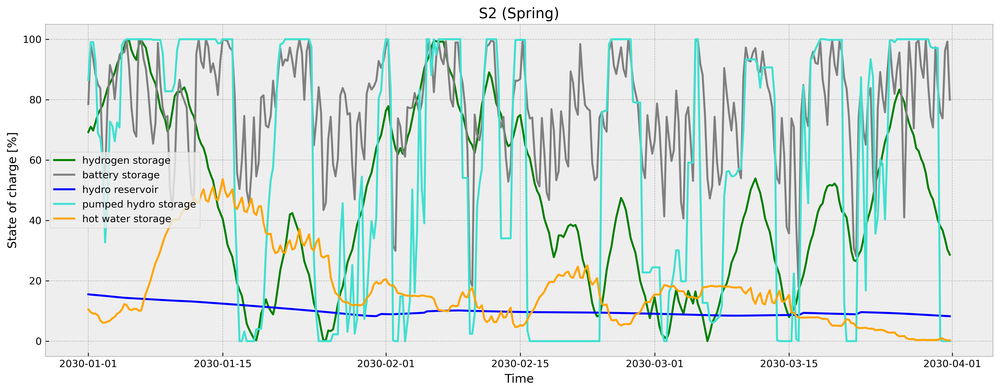

In [84]:
plt.figure(figsize=(17, 6),dpi=300)
plt.plot(ts2["h2 SOC [%]"].loc["2030-01":"2030-03"], color="green", label="hydrogen storage")
plt.plot(ts2["battery SOC [%]"].loc["2030-01":"2030-03"], color="grey", label="battery storage")
plt.plot(ts2["hydro SOC [%]"].loc["2030-01":"2030-03"], color="blue", label="hydro reservoir")
plt.plot(ts2["PHS SOC [%]"].loc["2030-01":"2030-03"], color="turquoise", label="pumped hydro storage")
plt.plot(ts2["hot water SOC [%]"].loc["2030-01":"2030-03"], color="orange", label="hot water storage")


#plt.fill_between(ts2["deficit [GW]"].loc["2030-01"].index, ts2["load [GW]"].loc["2030-01"], ts2["RE"].loc["2030-01"], color="grey", label="deficit")
#plt.fill_between(ts2.index, ts2["load [TW]"].loc["2013-01"], ts2["RE"].loc["2013-01"], color="grey", label="deficit")

plt.xlabel("Time")
plt.ylabel("State of charge [%]")
plt.title("S2 (Spring)")
plt.legend()
plt.show()

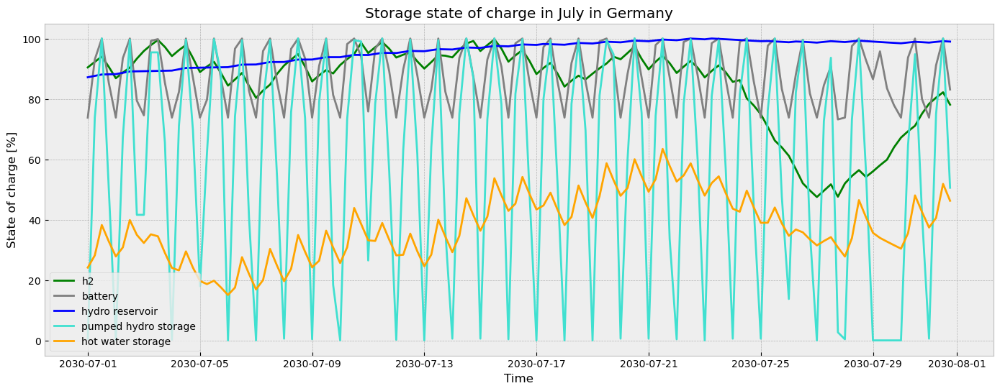

In [29]:
plt.figure(figsize=(17, 6),dpi=300)
plt.plot(ts2["h2 SOC [%]"].loc["2030-07"], color="green", label="h2")
plt.plot(ts2["battery SOC [%]"].loc["2030-07"], color="grey", label="battery")
plt.plot(ts2["hydro SOC [%]"].loc["2030-07"], color="blue", label="hydro reservoir")
plt.plot(ts2["PHS SOC [%]"].loc["2030-07"], color="turquoise", label="pumped hydro storage")
plt.plot(ts2["hot water SOC [%]"].loc["2030-07"], color="orange", label="hot water storage")
#plt.fill_between(ts2["deficit [GW]"].loc["2030-01"].index, ts2["load [GW]"].loc["2030-01"], ts2["RE"].loc["2030-01"], color="grey", label="deficit")
#plt.fill_between(ts2.index, ts2["load [TW]"].loc["2013-01"], ts2["RE"].loc["2013-01"], color="grey", label="deficit")

plt.xlabel("Time")
plt.ylabel("State of charge [%]")
plt.title("Storage state of charge in July in Germany")
plt.legend()
plt.show()

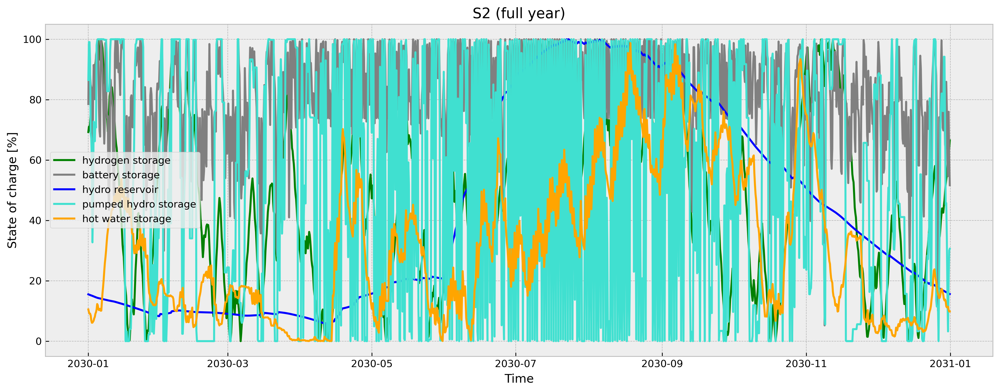

In [85]:
plt.figure(figsize=(17, 6),dpi=300)
plt.plot(ts2["h2 SOC [%]"], color="green", label="hydrogen storage")
plt.plot(ts2["battery SOC [%]"], color="grey", label="battery storage")
plt.plot(ts2["hydro SOC [%]"], color="blue", label="hydro reservoir")
plt.plot(ts2["PHS SOC [%]"], color="turquoise", label="pumped hydro storage")
plt.plot(ts2["hot water SOC [%]"], color="orange", label="hot water storage")
#plt.fill_between(ts2["deficit [GW]"].loc["2030-01"].index, ts2["load [GW]"].loc["2030-01"], ts2["RE"].loc["2030-01"], color="grey", label="deficit")
#plt.fill_between(ts2.index, ts2["load [TW]"].loc["2013-01"], ts2["RE"].loc["2013-01"], color="grey", label="deficit")

plt.xlabel("Time")
plt.ylabel("State of charge [%]")
plt.title("S2 (full year)")
plt.legend()
plt.show()

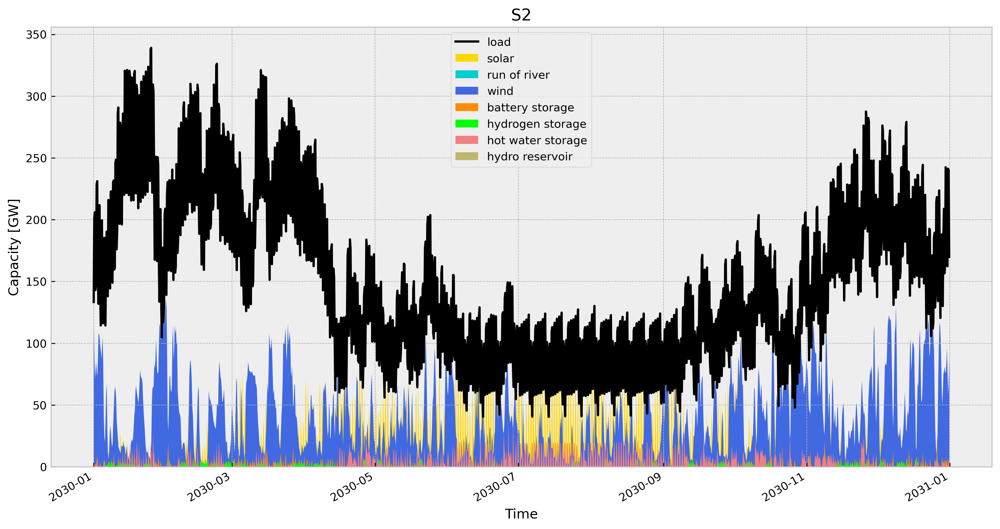

In [89]:
fig, ax = plt.subplots(figsize=(15, 8),dpi=300)
plt.plot(ts2["load [GW]"], color="black", label="load")
ts2["solar [GW]"].plot.area(ax=ax,linewidth=0,color="gold",label="solar")
ts2["ror [GW]"].plot.area(ax=ax,linewidth=0,color="darkturquoise",label="run of river")
ts2["wind [GW]"].plot.area(ax=ax,linewidth=0,color="royalblue",label="wind")
ts2["battery dispatch [GW]"].where(ts2["battery dispatch [GW]"]>0).plot.area(ax=ax,linewidth=0,color="darkorange",label="battery storage")
ts2["h2 dispatch [GW]"].where(ts2["h2 dispatch [GW]"]>0).plot.area(ax=ax,linewidth=0,color="lime",label="hydrogen storage")
ts2["hot water disptach [GW]"].where(ts2["hot water disptach [GW]"]>0).plot.area(ax=ax,linewidth=0,color="lightcoral",label="hot water storage")
ts2["hydro disptach [GW]"].where(ts2["hydro disptach [GW]"]>0).plot.area(ax=ax,linewidth=0,color="darkkhaki",label="hydro reservoir")
#ts2["PHS disptach [GW]"].where(ts2["PHS disptach [GW]"]>0).plot.area(ax=ax,linewidth=0,color="darkkhaki",label="pumped hydro storage")


#plt.plot(ts2["load [GW]"], color="black", label="load")

plt.xlabel("Time")
plt.ylabel("Capacity [GW]")
plt.title("S2")
plt.legend()
plt.show()

In [ ]:
ts2["solar [GW]"] = solar2
ts2["ror [GW]"] = ror2
ts2["load [GW]"] = load2
ts2["h2 demand [GW]"] = h2_demand2
ts2["h2 supply [GW]"] = h2_supply2
ts2["h2 dispatch [GW]"] = h2_dispatch2
ts2["h2 SOC [%]"] = h2_SOC2
ts2["battery dispatch [GW]"] = battery_dispatch2
ts2["battery SOC [%]"] = battery_SOC2

ts2["hot water disptach [GW]"] = watertank_dispatch2
ts2["hot water SOC [%]"] = watertank_SOC2

ts2["hydro disptach [GW]"] = hydro_dispatch2
ts2["hydro SOC [%]"] = hydro_SOC2

ts2["PHS dispatch [GW]"] = PHS_dispatch2
ts2["PHS SOC [%]"] = PHS_SOC2

In [240]:
wind3=case3.generators_t.p.filter(like='wind').filter(like="DE").div(1e3).sum(axis=1)
solar3=case3.generators_t.p.filter(like='solar').filter(like="DE").div(1e3).sum(axis=1)
load3=case3.loads_t.p.filter(like="DE").div(1e3).sum(axis=1)
h2_demand3=case3.loads_t.p.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_supply3=case3.links_t.p1.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)

h2_dispatch3=case3.stores_t.p.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_store_level3=case3.stores_t.e.filter(like="H2").filter(like="DE").div(1e3).sum(axis=1)
h2_store_max3=case3.stores.e_nom_opt.filter(like="H2").filter(like="DE").div(1e3).sum()
h2_SOC3=h2_store_level3/h2_store_max3*100

battery_dispatch3=case3.stores_t.p.filter(like="battery").filter(like="DE").div(1e3).sum(axis=1)# GW
battery_level3=case3.stores_t.e.filter(like="battery").filter(like="DE").div(1e3).sum(axis=1)
battery_max3=case3.stores.e_nom_opt.filter(like="battery").filter(like="DE").div(1e3).sum()
battery_SOC3=battery_level3/battery_max3*100


In [241]:
# create time series dataframe in Germany for case 3
ts3 = pd.DataFrame(wind3)
ts3 = ts3.rename(columns={0:'wind [GW]'})
ts3["solar [GW]"] = solar3
ts3["load [GW]"] = load3
ts3["h2 demand [GW]"] = h2_demand3
ts3["h2 supply [GW]"] = h2_supply3
ts3["h2 dispatch [GW]"] = h2_dispatch3
ts3["h2 SOC [%]"] = h2_SOC3
ts3["battery dispatch [GW]"] = battery_dispatch3
ts3["battery SOC [%]"] = battery_SOC3

ts3["solar residual load"] = ts3["load [GW]"] - ts3["solar [GW]"]
ts3["wind residual load"] = ts3["load [GW]"] - ts3["wind [GW]"]

ts3.index = pd.to_datetime(ts3.index)
ts3.index = ts3.index.map(lambda x: x.replace(year=2030))
ts3

,wind [GW],solar [GW],load [GW],h2 demand [GW],h2 supply [GW],h2 dispatch [GW],h2 SOC [%],battery dispatch [GW],battery SOC [%],solar residual load,wind residual load
snapshot,,,,,,,,,,,
2030-01-01 00:00:00,116.102733,0.000000,179.087971,2.155251,-10.443175,-2.769061,69.268811,-12.217521,78.515397,179.087971,62.985239
2030-01-01 06:00:00,88.856011,14.301853,247.126318,2.155251,-8.594807,-1.747536,71.014334,-9.024182,98.373099,232.824465,158.270307
2030-01-01 12:00:00,71.155142,6.819307,251.806775,2.155251,-5.433501,1.268620,69.747176,2.144719,93.653646,244.987468,180.651632
2030-01-01 18:00:00,78.669272,0.000000,188.813060,2.155251,-10.460146,-2.705204,72.449262,2.426785,88.313508,188.813060,110.143788
2030-01-02 00:00:00,84.703378,0.000000,193.367929,2.155251,-10.464600,-2.771929,75.217996,1.510406,84.989863,193.367929,108.664550
...,...,...,...,...,...,...,...,...,...,...,...
2030-12-30 18:00:00,96.697782,0.000000,214.679529,2.155251,-10.442704,-2.706416,57.878467,7.804214,59.943900,214.679529,117.981746
2030-12-31 00:00:00,75.673048,0.000000,208.075157,2.155251,-10.439372,-2.754967,60.630259,2.402044,54.658205,208.075157,132.402109
2030-12-31 06:00:00,58.775140,42.450721,287.021460,2.155251,-8.424456,-1.636782,62.265155,-9.690841,75.982889,244.570738,228.246320


In [243]:
# maximum load
max_load3=ts3["load [GW]"].max()
# renewable capacity
ts3["RE"] = ts3["solar [GW]"] + ts3["wind [GW]"]
# capacity deficit
ts3["deficit [GW]"] = max_load3 - ts3["RE"] 

In [244]:
# find the time when load is max (deficit)
ts3["load [GW]"].idxmax()

Timestamp('2030-01-25 12:00:00')

In [245]:
# find the time when load is min (surplus supply)
ts3["load [GW]"].idxmin()

Timestamp('2030-07-14 00:00:00')

In [267]:
case2.statistics()["Capital Expenditure"].div(1e9).filter(like="Generator")

           carrier                                  
Generator  Offshore Wind (AC)                             2.930067
           Offshore Wind (DC)                            13.065366
           Onshore Wind                                 108.779313
           Run of River                                  14.782789
           Solar                                         54.519953
           gas                                            0.000000
           oil                                            0.000000
           residential rural solar thermal                0.000005
           residential urban decentral solar thermal      0.000006
           services rural solar thermal                   0.000005
           services urban decentral solar thermal         0.000006
           solar rooftop                                 20.690562
           urban central solar thermal                    0.168461
Name: Capital Expenditure, dtype: float64

In [268]:
case3.statistics()["Capital Expenditure"].div(1e9).filter(like="Store")

       carrier                                
Store  Battery Storage                            12.011600
       H2 Store                                    0.288841
       battery storage                             0.000000
       biogas                                      0.000000
       co2                                         0.000000
       co2 stored                                  2.000000
       gas                                         0.049784
       home battery                                0.000020
       methanol                                    0.000000
       oil                                         0.000000
       residential rural water tanks               0.449646
       residential urban decentral water tanks     1.066618
       services rural water tanks                  0.351685
       services urban decentral water tanks        0.439346
       solid biomass                               0.000000
       urban central water tanks                   0.

In [5]:
import matplotlib.pyplot as plt
import cartopy
import cartopy.crs as ccrs
import pandas as pd
import numpy as np
import matplotlib.colors as mcolors
import matplotlib.cm as cm

In [6]:
def assign_location(n):
    for c in n.iterate_components(n.one_port_components | n.branch_components):
        ifind = pd.Series(c.df.index.str.find(" ", start=4), c.df.index)
        for i in ifind.value_counts().index:
            # these have already been assigned defaults
            if i == -1: continue
            names = ifind.index[ifind == i]
            c.df.loc[names, 'location'] = names.str[:i]

In [7]:
def add_legend_patch(ax, colors, labels, patch_kw={}, legend_kw={}):
    handles = [Patch(facecolor=c, **patch_kw) for c in colors]

    legend = ax.legend(handles, labels, **legend_kw)

    ax.add_artist(legend)

In [68]:
# flow by net transported (MWh)
def plot_h2_flow(
    network, regions=None, series=None, min_energy=1e6, lim=100, fn=None
):  # MWh net transported
    crs = ccrs.EqualEarth()

    n = network.copy()

    assign_location(n)

    linewidth_factor = 5e3 # more/less flow directions can be seen by modified this factor: 7e3 or 8e5
    # MW below which not drawn
    line_lower_threshold = 1e2 #1e2
    link_color = "blue"
    
    # Drop non-electric buses so they don't clutter the plot
    n.buses.drop(n.buses.index[n.buses.carrier != "AC"], inplace=True)

    n.mremove("Link", n.links[~n.links.carrier.str.contains("H2 pipeline")].index) # remove multiple links that their carriers not containing H2 pips

    n.links.bus0 = n.links.bus0.str.replace(" H2", "")
    n.links.bus1 = n.links.bus1.str.replace(" H2", "")

    n.links["flow"] = n.snapshot_weightings.generators @ n.links_t.p0 # calculate and create h2 flow column for n2.links

    positive_order = n.links.bus0 < n.links.bus1
    for idx in n.links.loc[~positive_order].index:
        n.links.at[idx, 'bus0'], n.links.at[idx, 'bus1'] = n.links.at[idx, 'bus1'], n.links.at[idx, 'bus0']
        n.links.at[idx, 'flow'] = -n.links.at[idx, 'flow']
    #n.links.loc[~positive_order, "flow"] = -n.links.loc[~positive_order, "flow"] # for flow capactity where bus0 > bus1, negative this value
    n.links.index = n.links.apply(lambda x: f"H2 pipeline {x.bus0} -> {x.bus1}", axis=1)
    n.links = n.links.groupby(n.links.index).agg(
        dict(flow="sum", bus0="first", bus1="first", carrier="first", p_nom_opt="sum")
    )

    n.links.flow = n.links.flow.where(n.links.flow.abs() > min_energy) # where to define min_energy? define flow where its abs bigger than min_energy (but this min_energy does not affect the plot here)

    fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={"projection": crs},dpi=300)

    n.plot(
        bus_sizes=0,
        link_colors=link_color, 
        #link_colors=link_colors, # use the color map for link colors
        #link_widths=line_widths, # Use the calculated line widths
        link_widths=0.2,
        branch_components=["Link"],
        ax=ax,
        geomap=True,
        #flow=pd.concat({"Link": n.links.flow.div(linewidth_factor)}),
        flow=pd.concat({"Link": n.links.flow.div(10000)}), # GWh, this show flow arrow by its capacity
        #flow=flow_series, 
        #flow=False,  # Disable flow arrows as we're using line thickness for capacity
        #flow=pd.concat({"Link": n.links.flow.where(n.links.flow.abs())}),
    )



    if regions is not None:
        regions = regions.to_crs(crs.proj4_init)

        regions.plot(
            ax=ax,
            column=-series.reindex(regions.index),
            cmap="PRGn",
            linewidths=0,
            legend=True,
            vmax=lim,
            vmin=-lim,
            legend_kwds={
                "label": "Hydrogen balance [TWh]",
                "shrink": 0.7,
                "extend": "both",
            },
        )

    colors = [link_color]
    labels = ["Hydrogen flows [GWh]"]
    add_legend_patch(
        ax,
        colors,
        labels,
        patch_kw=dict(edgecolor="k"),
        legend_kw=dict(loc="upper left"),
    )

    plt.show()

In [9]:
import matplotlib.patches as mpatches
import matplotlib.lines as mlines

In [52]:
from cartopy.io import shapereader


def plot_h2_network1(
    network, regions=None, series=None, lim=100, fn=None
):  # MWh net transported
    crs = ccrs.PlateCarree()

    n = network.copy()

    assign_location(n)

    linewidth_factor = 8e5 
    # MW below which not drawn
    line_lower_threshold = 1e2 #1e2
    link_color = "green"
    
    # Drop non-electric buses so they don't clutter the plot
    n.buses.drop(n.buses.index[n.buses.carrier != "AC"], inplace=True)

    n.mremove("Link", n.links[~n.links.carrier.str.contains("H2 pipeline")].index) # remove multiple links that their carriers not containing H2 pips

    n.links.bus0 = n.links.bus0.str.replace(" H2", "")
    n.links.bus1 = n.links.bus1.str.replace(" H2", "")


    positive_order = n.links.bus0 < n.links.bus1
    for idx in n.links.loc[~positive_order].index:
        n.links.at[idx, 'bus0'], n.links.at[idx, 'bus1'] = n.links.at[idx, 'bus1'], n.links.at[idx, 'bus0']
        #n.links.at[idx, 'flow'] = -n.links.at[idx, 'flow']
    #n.links.loc[~positive_order, "flow"] = -n.links.loc[~positive_order, "flow"] # for flow capactity where bus0 > bus1, negative this value
    n.links.index = n.links.apply(lambda x: f"H2 pipeline {x.bus0} -> {x.bus1}", axis=1)
    n.links = n.links.groupby(n.links.index).agg(
        dict(bus0="first", bus1="first", carrier="first", p_nom_opt="sum")
    )

    fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={"projection": crs},dpi=300)

    n.plot(
        bus_sizes=0.02,
        link_colors=link_color, 
        #link_colors=link_colors, # use the color map for link colors
        #link_widths=line_widths, # Use the calculated line widths
        link_widths=n.links.p_nom_opt/(5e2),
        #link_widths=0.2,
        branch_components=["Link"],
        ax=ax,
        geomap=True,
        #flow=pd.concat({"Link": n.links.flow.div(linewidth_factor)}),
        #flow=pd.concat({"Link": n.links.flow.div(10000)}), # GWh, this show flow arrow by its capacity
        #flow=flow_series, 
        #flow=False,  # Disable flow arrows as we're using line thickness for capacity
        #flow=pd.concat({"Link": n.links.flow.where(n.links.flow.abs())}),
    )

# Additional code to add country names
    # This requires the natural_earth package which contains shapefiles with country names and borders
    # Assuming the shapefile is at the 50m resolution which is commonly used for maps at this scale
    countries = shapereader.natural_earth(resolution='50m',
                                        category='cultural',
                                        name='admin_0_countries')
    reader = shapereader.Reader(countries)

    # List of countries for which you want to display the full name
    full_name_countries = ['Germany', 'Sweden', 'Denmark', 'Spain', 'France', 'Netherlands', 'Poland',
                        'Portugal', 'United Kingdom', 'Ireland', 'Italy', 'Greece', 'Belgium']

    # Define a function to check if a point is within the Europe bounds
    def is_in_europe(x, y):
        lon_min, lon_max, lat_min, lat_max = EUROPE_BOUNDS
        return lon_min <= x <= lon_max and lat_min <= y <= lat_max

    # Correct coordinates for France's label
    france_label_coords = (2.2137, 46.2276) 

    # Adding country names to the plot, but only for the specified European countries
    for country in reader.records():
        geometry = country.geometry
        name_long = country.attributes['NAME_LONG']
        # Manually set France's label coordinates
        if name_long == 'France':
            x, y = france_label_coords
        else:
            x, y = geometry.centroid.x, geometry.centroid.y
        # Check if the country is in the list of specific countries
        if name_long in full_name_countries:
            ax.text(x, y, name_long, ha='center', va='center', fontsize=12, transform=ccrs.PlateCarree())


    if regions is not None:
        regions = regions.to_crs(crs.proj4_init)

        regions.plot(
            ax=ax,
            column=-series.reindex(regions.index),
            cmap="PRGn",
            linewidths=0,
            legend=True,
            vmax=lim,
            vmin=-lim,
            legend_kwds={
                "label": "Hydrogen balance [TWh]",
                "shrink": 0.7,
                "extend": "both",
            },
        )

   
    sizes = [10, 20]
    labels = [f"{s} GW" for s in sizes]
    scale = 1e3 / linewidth_factor
    sizes = [s * scale for s in sizes]
    
    # Create the legend manually
    legend_lines = [
        mlines.Line2D([], [], color=link_color, linewidth=1, label='1 GW'),
        mlines.Line2D([], [], color=link_color, linewidth=4, label='3 GW'),
    ]
    # Create a legend for line thickness
    legend1 = ax.legend(handles=legend_lines, loc='upper left', frameon=False, 
                        title='Hydrogen network [GW]', title_fontsize='medium', 
                        labelspacing=1.5, handletextpad=2, borderpad=1)

    # Add the legend to the plot
    ax.add_artist(legend1)
    ax.gridlines()

    plt.show()

In [70]:
from cartopy.io import shapereader

def plot_h2_network2(
    network, regions=None, series=None, lim=100, fn=None
):  # MWh net transported
    crs = ccrs.PlateCarree()

    n = network.copy()

    assign_location(n)

    linewidth_factor = 8e5 
    # MW below which not drawn
    line_lower_threshold = 50 #1e2
    link_color = "green"
    
    # Drop non-electric buses so they don't clutter the plot
    n.buses.drop(n.buses.index[n.buses.carrier != "AC"], inplace=True)

    n.mremove("Link", n.links[~n.links.carrier.str.contains("H2 pipeline")].index) # remove multiple links that their carriers not containing H2 pips

    n.links.bus0 = n.links.bus0.str.replace(" H2", "")
    n.links.bus1 = n.links.bus1.str.replace(" H2", "")


    positive_order = n.links.bus0 < n.links.bus1
    for idx in n.links.loc[~positive_order].index:
        n.links.at[idx, 'bus0'], n.links.at[idx, 'bus1'] = n.links.at[idx, 'bus1'], n.links.at[idx, 'bus0']
        #n.links.at[idx, 'flow'] = -n.links.at[idx, 'flow']
    #n.links.loc[~positive_order, "flow"] = -n.links.loc[~positive_order, "flow"] # for flow capactity where bus0 > bus1, negative this value
    n.links.index = n.links.apply(lambda x: f"H2 pipeline {x.bus0} -> {x.bus1}", axis=1)
    n.links = n.links.groupby(n.links.index).agg(
        dict(bus0="first", bus1="first", carrier="first", p_nom_opt="sum")
    )

    fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={"projection": crs},dpi=300)

    n.plot(
        bus_sizes=0.02,
        link_colors=link_color, 
        #link_colors=link_colors, # use the color map for link colors
        #link_widths=line_widths, # Use the calculated line widths
        link_widths=n.links.p_nom_opt/(5e2),
        #link_widths=0.2,
        branch_components=["Link"],
        ax=ax,
        geomap=True,
        #flow=pd.concat({"Link": n.links.flow.div(linewidth_factor)}),
        #flow=pd.concat({"Link": n.links.flow.div(10000)}), # GWh, this show flow arrow by its capacity
        #flow=flow_series, 
        #flow=False,  # Disable flow arrows as we're using line thickness for capacity
        #flow=pd.concat({"Link": n.links.flow.where(n.links.flow.abs())}),
    )

   

# Additional code to add country names
    # This requires the natural_earth package which contains shapefiles with country names and borders
    # Assuming the shapefile is at the 50m resolution which is commonly used for maps at this scale
    countries = shapereader.natural_earth(resolution='50m',
                                        category='cultural',
                                        name='admin_0_countries')
    reader = shapereader.Reader(countries)

    # List of countries for which you want to display the full name
    full_name_countries = ['Germany', 'Sweden', 'Denmark', 'Spain', 'France', 'Netherlands', 'Poland',
                        'Portugal', 'United Kingdom', 'Ireland', 'Italy', 'Greece', 'Belgium']

    # Define a function to check if a point is within the Europe bounds
    def is_in_europe(x, y):
        lon_min, lon_max, lat_min, lat_max = EUROPE_BOUNDS
        return lon_min <= x <= lon_max and lat_min <= y <= lat_max

    # Correct coordinates for France's label
    france_label_coords = (2.2137, 46.2276) 

    # Adding country names to the plot, but only for the specified European countries
    for country in reader.records():
        geometry = country.geometry
        name_long = country.attributes['NAME_LONG']
        # Manually set France's label coordinates
        if name_long == 'France':
            x, y = france_label_coords
        else:
            x, y = geometry.centroid.x, geometry.centroid.y
        # Check if the country is in the list of specific countries
        if name_long in full_name_countries:
            ax.text(x, y, name_long, ha='center', va='center', fontsize=12, transform=ccrs.PlateCarree())


    if regions is not None:
        regions = regions.to_crs(crs.proj4_init)

        regions.plot(
            ax=ax,
            column=-series.reindex(regions.index),
            cmap="PRGn",
            linewidths=0,
            legend=True,
            vmax=lim,
            vmin=-lim,
            legend_kwds={
                "label": "Hydrogen balance [TWh]",
                "shrink": 0.7,
                "extend": "both",
            },
        )

    
    sizes = [10, 20]
    labels = [f"{s} GW" for s in sizes]
    scale = 1e3 / linewidth_factor
    sizes = [s * scale for s in sizes]
    

    # Create the legend manually
    legend_lines = [
        mlines.Line2D([], [], color=link_color, linewidth=2, label='1 GW'),
        mlines.Line2D([], [], color=link_color, linewidth=6, label='3 GW'),
    ]
    # Create a legend for line thickness
    legend2 = ax.legend(handles=legend_lines, loc='upper left', frameon=False, 
                        title='Hydrogen network [GW]', title_fontsize='medium', 
                        labelspacing=1.5, handletextpad=2, borderpad=1)

    # Add the legend to the plot
    ax.add_artist(legend2)
    ax.gridlines()

    plt.show()

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


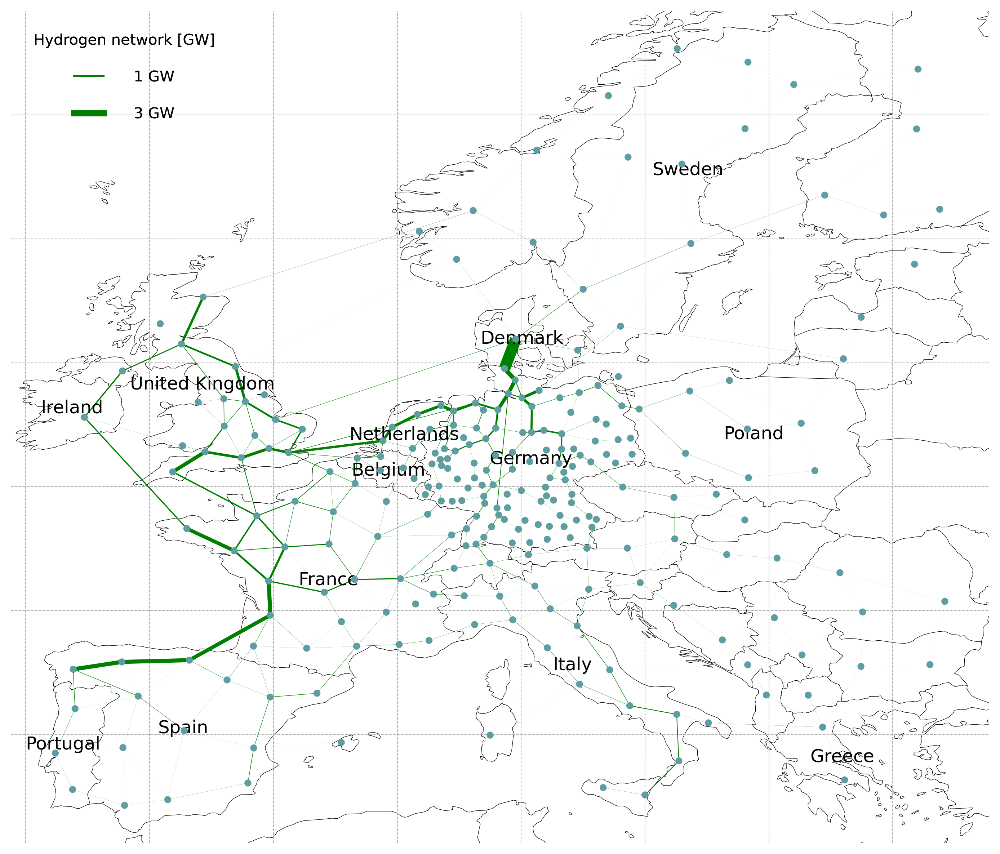

In [53]:
plot_h2_network1(case1)

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


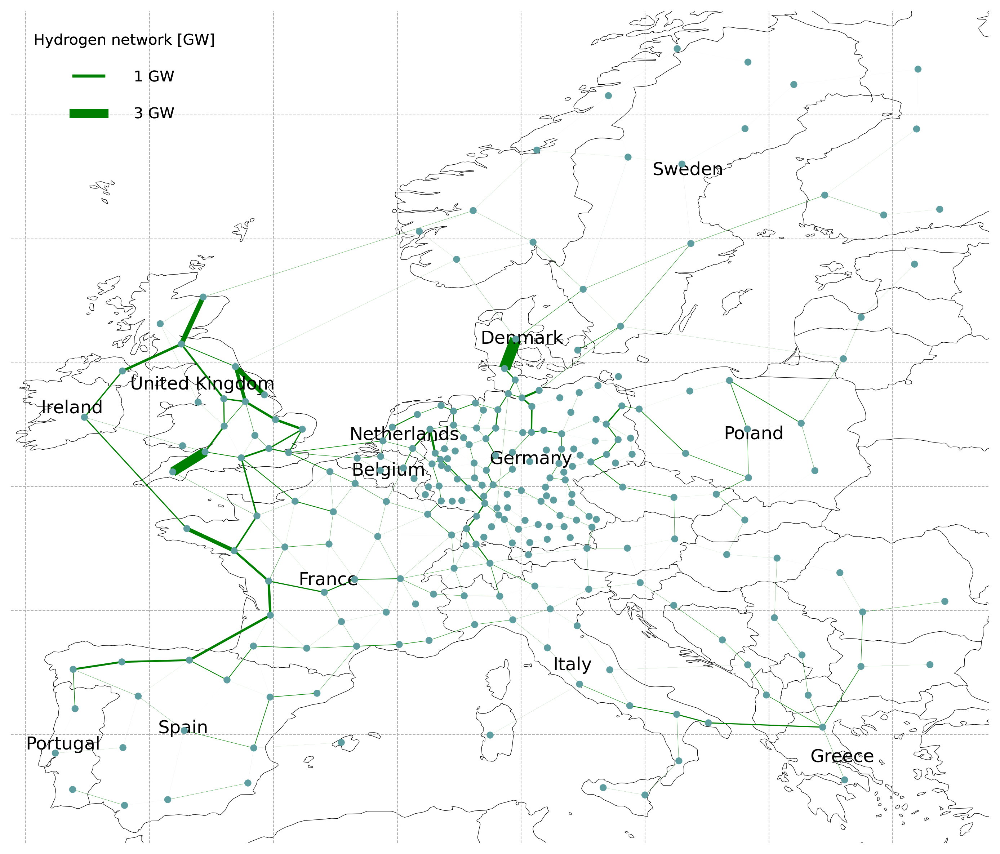

In [34]:
plot_h2_network2(case2)

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


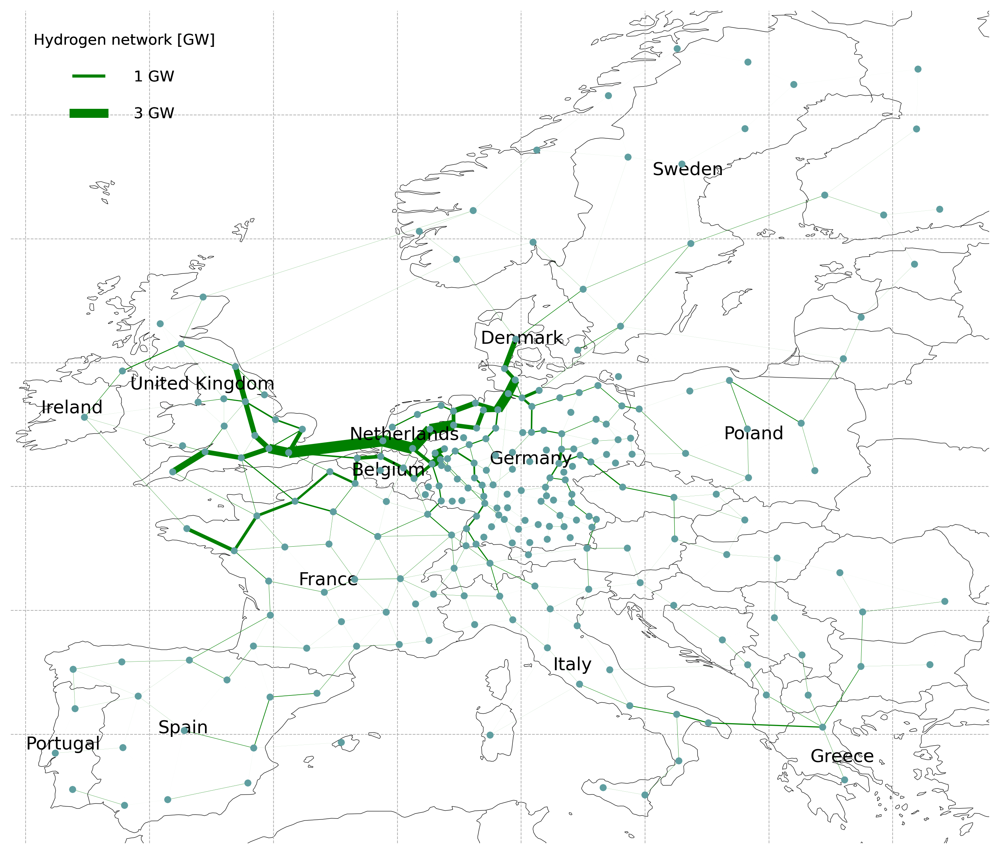

In [33]:
plot_h2_network2(case3)

In [43]:
DE_regions = gpd.read_file(r"./gadm_410-levels-ADM_1-DEU.gpkg")
DE_regions = DE_regions.drop(["GID_0", "GID_1", "COUNTRY"],axis=1)
DE_regions["centroid"] = DE_regions["geometry"].centroid

DE_regions

/var/folders/2b/17ddx8s13fb7jb4wkn0p31b80000gn/T/ipykernel_47507/3774344237.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  DE_regions["centroid"] = DE_regions["geometry"].centroid


,NAME_1,geometry,centroid
0,Baden-Württemberg,"MULTIPOLYGON (((8.35002 47.57062, 8.34778 47.5...",POINT (9.04909 48.53753)
1,Bayern,"MULTIPOLYGON (((11.41009 47.49540, 11.41005 47...",POINT (11.42000 48.94784)
2,Berlin,"MULTIPOLYGON (((13.50022 52.61379, 13.49855 52...",POINT (13.40185 52.50153)
3,Brandenburg,"MULTIPOLYGON (((13.32220 51.43674, 13.32402 51...",POINT (13.39777 52.47288)
4,Bremen,"MULTIPOLYGON (((8.67501 53.17805, 8.67532 53.1...",POINT (8.74464 53.19772)
5,Hamburg,"MULTIPOLYGON (((10.17575 53.71111, 10.17562 53...",POINT (10.02079 53.54638)
6,Hessen,"MULTIPOLYGON (((8.88614 49.41698, 8.88546 49.4...",POINT (9.03105 50.60322)
7,Mecklenburg-Vorpommern,"MULTIPOLYGON (((11.56936 53.16780, 11.56944 53...",POINT (12.55396 53.75402)
8,Niedersachsen,"MULTIPOLYGON (((10.36772 51.55516, 10.36846 51...",POINT (9.15923 52.76588)
9,Nordrhein-Westfalen,"MULTIPOLYGON (((6.57956 50.37709, 6.57518 50.3...",POINT (7.56208 51.47971)


In [72]:
from cartopy.io import shapereader

def plot_h2_network2_DE(
    network, regions=None, series=None, lim=100, fn=None
):  # MWh net transported
    crs = ccrs.PlateCarree()

    n = network.copy()

    assign_location(n)

    linewidth_factor = 8e5 
    # MW below which not drawn
    line_lower_threshold = 50 #1e2
    link_color = "green"
    
    # Drop non-electric buses so they don't clutter the plot
    n.buses.drop(n.buses.index[n.buses.carrier != "AC"], inplace=True)

    n.mremove("Link", n.links[~n.links.carrier.str.contains("H2 pipeline")].index) # remove multiple links that their carriers not containing H2 pips

    n.links.bus0 = n.links.bus0.str.replace(" H2", "")
    n.links.bus1 = n.links.bus1.str.replace(" H2", "")

    positive_order = n.links.bus0 < n.links.bus1
    for idx in n.links.loc[~positive_order].index:
        n.links.at[idx, 'bus0'], n.links.at[idx, 'bus1'] = n.links.at[idx, 'bus1'], n.links.at[idx, 'bus0']
        #n.links.at[idx, 'flow'] = -n.links.at[idx, 'flow']
    #n.links.loc[~positive_order, "flow"] = -n.links.loc[~positive_order, "flow"] # for flow capactity where bus0 > bus1, negative this value
    n.links.index = n.links.apply(lambda x: f"H2 pipeline {x.bus0} -> {x.bus1}", axis=1)
    n.links = n.links.groupby(n.links.index).agg(
        dict(bus0="first", bus1="first", carrier="first", p_nom_opt="sum")
    )

    """
    # Set up the line widths based on flow capacity
    # The line widths will be proportional to the log of the flow to ensure a wide range of widths
    min_line_width = 0.1  # Minimum line width
    max_line_width = 5.0  # Maximum line width
    line_widths = n.links.flow.abs().apply(np.log1p)  # Apply a log function to get a better distribution of line widths
    line_widths = line_widths / line_widths.max() * (max_line_width - min_line_width) + min_line_width
    """

    fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={"projection": crs},dpi=300)

    # Define the boundary style once, since it will be the same for each subplot
    boundary_style = {'edgecolor': 'darkgray', 'linestyle': ':', 'linewidth': 1}

    n.plot(
        bus_sizes=0.0002,
        link_colors=link_color, 
        #link_colors=link_colors, # use the color map for link colors
        #link_widths=line_widths, # Use the calculated line widths
        link_widths=n.links.p_nom_opt/(5e2),
        #link_widths=0.2,
        branch_components=["Link"],
        ax=ax,
        geomap=True,
        #flow=pd.concat({"Link": n.links.flow.div(linewidth_factor)}),
        #flow=pd.concat({"Link": n.links.flow.div(10000)}), # GWh, this show flow arrow by its capacity
        #flow=flow_series, 
        #flow=False,  # Disable flow arrows as we're using line thickness for capacity
        #flow=pd.concat({"Link": n.links.flow.where(n.links.flow.abs())}),
    )


# Plot the German states boundaries
    DE_regions.boundary.plot(ax=ax, **boundary_style)  

    # Add state names to the plot
    for idx, row in DE_regions.iterrows(): 
        name = row['NAME_1']
        centroid = row['centroid']
        ax.text(centroid.x, centroid.y, name, ha='center', va='center', fontsize=12, transform=ccrs.PlateCarree())

    #ax.add_feature(cfeature.COASTLINE, linewidth=0.1)
    #ax.add_feature(cfeature.BORDERS, linestyle=':', color="darkgrey", linewidth=1)

    # Set the extent of the map to Germany
    ax.set_extent([5.5, 15, 47, 55], crs=ccrs.PlateCarree())



    if regions is not None:
        regions = regions.to_crs(crs.proj4_init)

        regions.plot(
            ax=ax,
            column=-series.reindex(regions.index),
            cmap="PRGn",
            linewidths=0,
            legend=True,
            vmax=lim,
            vmin=-lim,
            legend_kwds={
                "label": "Hydrogen balance [TWh]",
                "shrink": 0.7,
                "extend": "both",
            },
        )

    sizes = [10, 20]
    labels = [f"{s} GW" for s in sizes]
    scale = 1e3 / linewidth_factor
    sizes = [s * scale for s in sizes]
    
    # Create the legend manually
    legend_lines = [
        mlines.Line2D([], [], color=link_color, linewidth=2, label='1 GW'),
        mlines.Line2D([], [], color=link_color, linewidth=6, label='3 GW'),
    ]
    # Create a legend for line thickness
    legend2 = ax.legend(handles=legend_lines, loc='upper left', frameon=False, 
                        title='Hydrogen network [GW]', title_fontsize='medium', 
                        labelspacing=1.5, handletextpad=2, borderpad=1)

    # Add the legend to the plot
    ax.add_artist(legend2)
    ax.gridlines()

    plt.show()

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


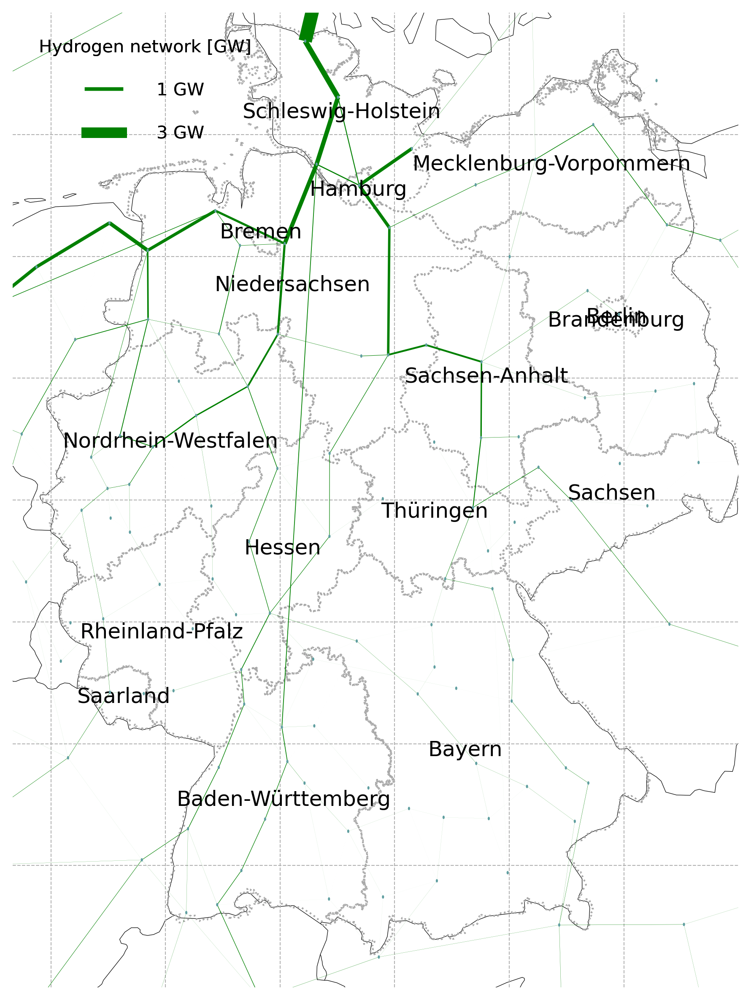

In [49]:
plot_h2_network2_DE(case1)

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


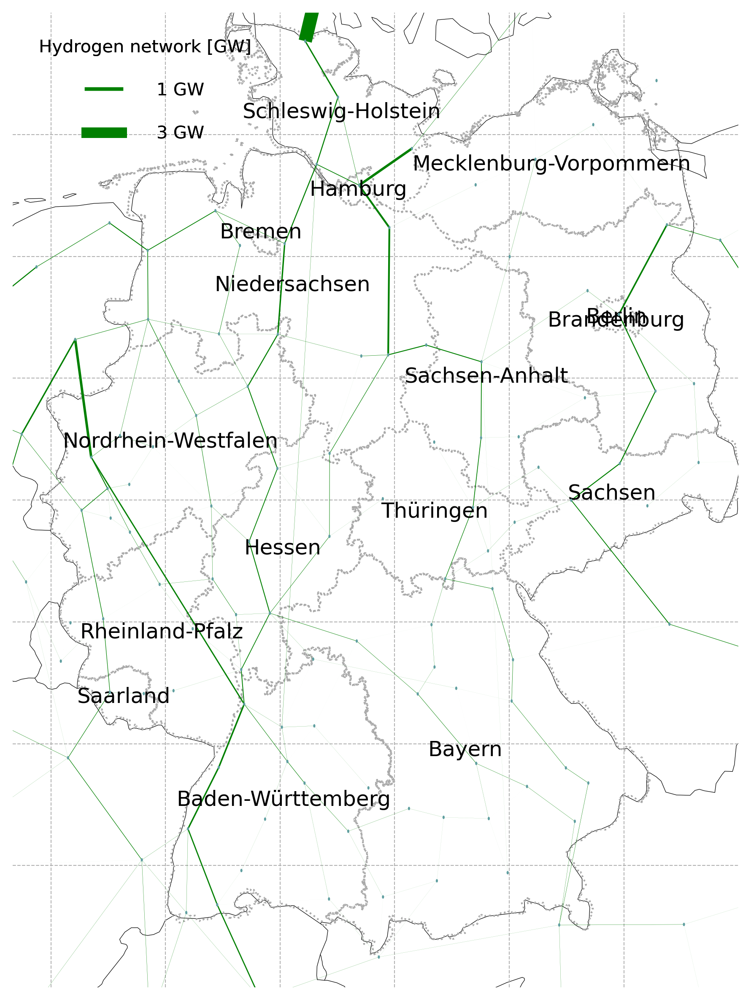

In [50]:
plot_h2_network2_DE(case2)

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


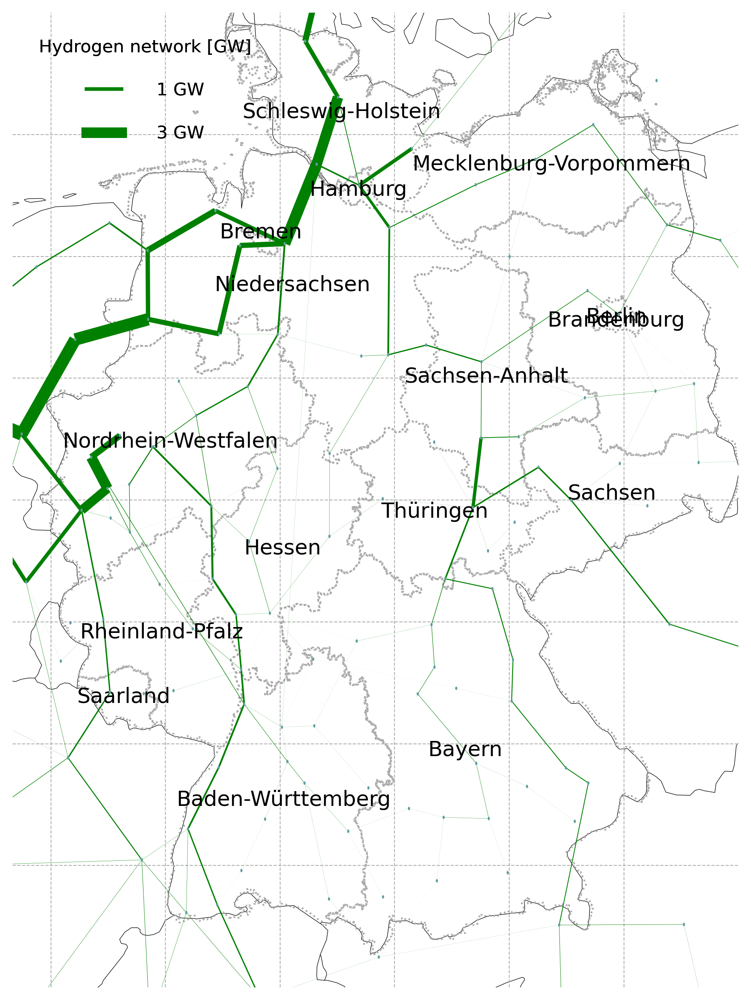

In [73]:
plot_h2_network2_DE(case3)

In [64]:
# flow by net transported (MWh)
def plot_h2_flow_DE(
    network, regions=None, series=None, min_energy=1e6, lim=100, fn=None
):  # MWh net transported
    crs = ccrs.EqualEarth()

    n = network.copy()

    assign_location(n)

    linewidth_factor = 7e3 
    line_lower_threshold = 1e2 #1e2
    link_color = "blue"
    
    # Drop non-electric buses so they don't clutter the plot
    n.buses.drop(n.buses.index[n.buses.carrier != "AC"], inplace=True)

    n.mremove("Link", n.links[~n.links.carrier.str.contains("H2 pipeline")].index) # remove multiple links that their carriers not containing H2 pips

    n.links.bus0 = n.links.bus0.str.replace(" H2", "")
    n.links.bus1 = n.links.bus1.str.replace(" H2", "")

    n.links["flow"] = n.snapshot_weightings.generators @ n.links_t.p0 # calculate and create h2 flow column for n2.links

   
    positive_order = n.links.bus0 < n.links.bus1
    for idx in n.links.loc[~positive_order].index:
        n.links.at[idx, 'bus0'], n.links.at[idx, 'bus1'] = n.links.at[idx, 'bus1'], n.links.at[idx, 'bus0']
        n.links.at[idx, 'flow'] = -n.links.at[idx, 'flow']
    #n.links.loc[~positive_order, "flow"] = -n.links.loc[~positive_order, "flow"] # for flow capactity where bus0 > bus1, negative this value
    n.links.index = n.links.apply(lambda x: f"H2 pipeline {x.bus0} -> {x.bus1}", axis=1)
    n.links = n.links.groupby(n.links.index).agg(
        dict(flow="sum", bus0="first", bus1="first", carrier="first", p_nom_opt="sum")
    )

    n.links.flow = n.links.flow.where(n.links.flow.abs() > min_energy) # where to define min_energy? define flow where its abs bigger than min_energy (but this min_energy does not affect the plot here)
    ### the min_energy above show flow that > 700 GWh

    """
    # Set up the line widths based on flow capacity
    # The line widths will be proportional to the log of the flow to ensure a wide range of widths
    min_line_width = 0.1  # Minimum line width
    max_line_width = 5.0  # Maximum line width
    line_widths = n.links.flow.abs().apply(np.log1p)  # Apply a log function to get a better distribution of line widths
    line_widths = line_widths / line_widths.max() * (max_line_width - min_line_width) + min_line_width
    """

    fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={"projection": crs},dpi=300)

    # Define the boundary style once, since it will be the same for each subplot
    boundary_style = {'edgecolor': 'darkgray', 'linestyle': ':', 'linewidth': 1}

    n.plot(
        bus_sizes=0,
        link_colors=link_color, 
        #link_colors=link_colors, # use the color map for link colors
        #link_widths=line_widths, # Use the calculated line widths
        link_widths=0.2,
        branch_components=["Link"],
        ax=ax,
        geomap=True,
        #flow=pd.concat({"Link": n.links.flow.div(linewidth_factor)}),
        flow=pd.concat({"Link": n.links.flow.div(10000)}), # GWh, this show flow arrow by its capacity
        #flow=flow_series, 
        #flow=False,  # Disable flow arrows as we're using line thickness for capacity
        #flow=pd.concat({"Link": n.links.flow.where(n.links.flow.abs())}),
    )


# Plot the German states boundaries
    DE_regions.boundary.plot(ax=ax, **boundary_style)  

    # Add state names to the plot
    for idx, row in DE_regions.iterrows():  
        name = row['NAME_1']
        centroid = row['centroid']
        ax.text(centroid.x, centroid.y, name, ha='center', va='center', fontsize=12, transform=ccrs.PlateCarree())

    #ax.add_feature(cfeature.COASTLINE, linewidth=0.1)
    #ax.add_feature(cfeature.BORDERS, linestyle=':', color="darkgrey", linewidth=1)

    # Set the extent of the map to Germany
    ax.set_extent([5.5, 15, 47, 55], crs=ccrs.PlateCarree())


    if regions is not None:
        regions = regions.to_crs(crs.proj4_init)

        regions.plot(
            ax=ax,
            column=-series.reindex(regions.index),
            cmap="PRGn",
            linewidths=0,
            legend=True,
            vmax=lim,
            vmin=-lim,
            legend_kwds={
                "label": "Hydrogen balance [TWh]",
                "shrink": 0.7,
                "extend": "both",
            },
        )

    colors = [link_color]
    labels = ["Hydrogen flows [GWh]"]
    add_legend_patch(
        ax,
        colors,
        labels,
        patch_kw=dict(edgecolor="k"),
        legend_kw=dict(loc="upper left"),
    )

    plt.show()

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


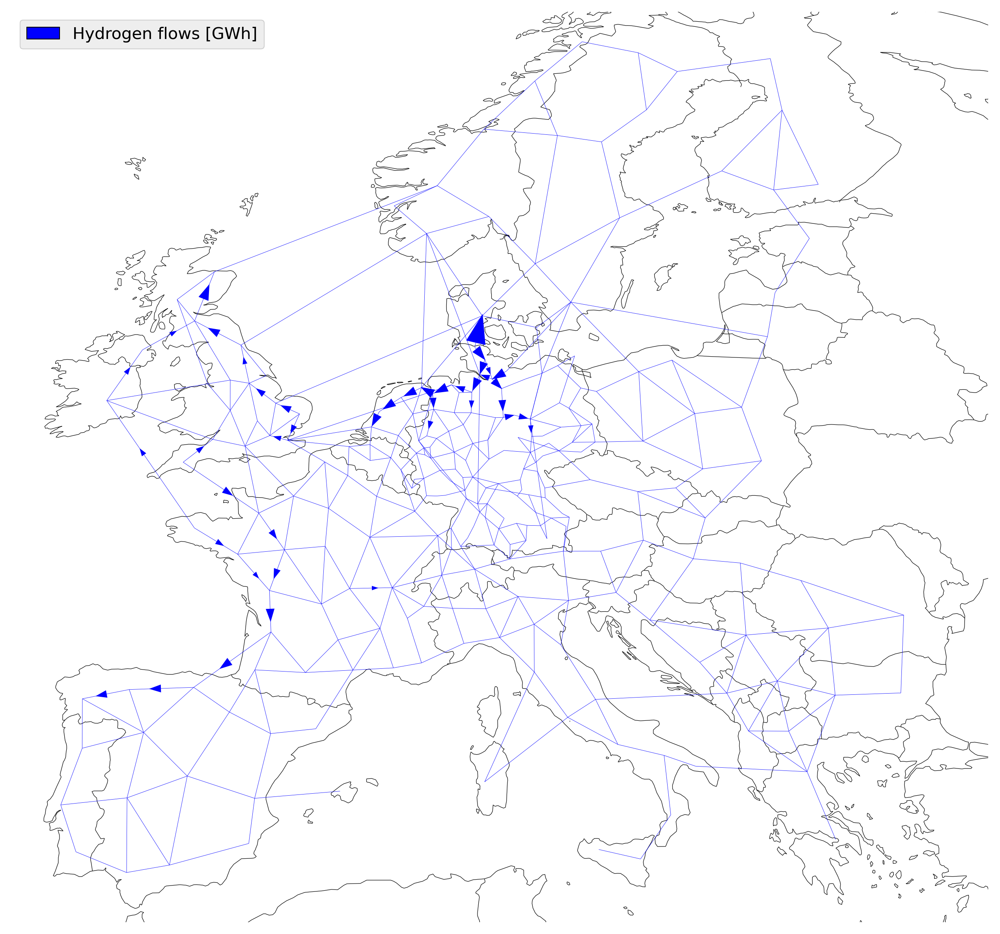

In [59]:
plot_h2_flow(network=case1)

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


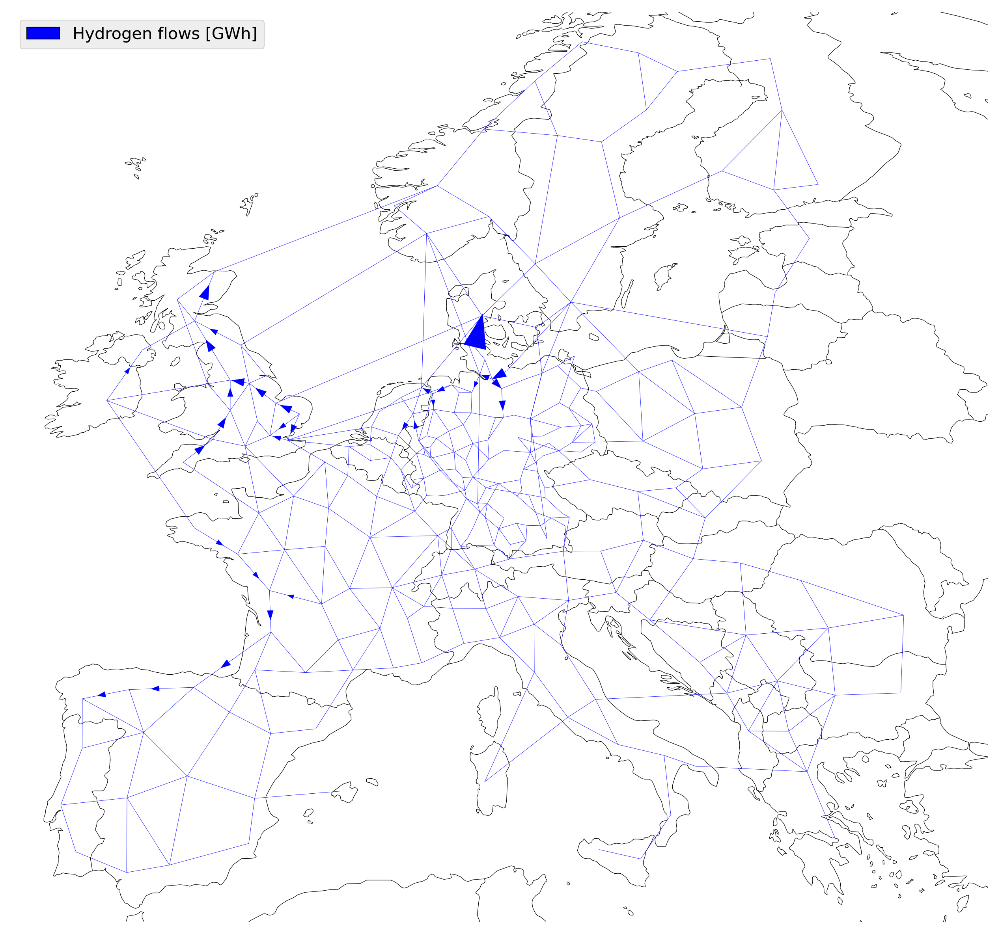

In [60]:
plot_h2_flow(network=case2)

/Users/e7_qpham/miniconda3/envs/pypsa-eur/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


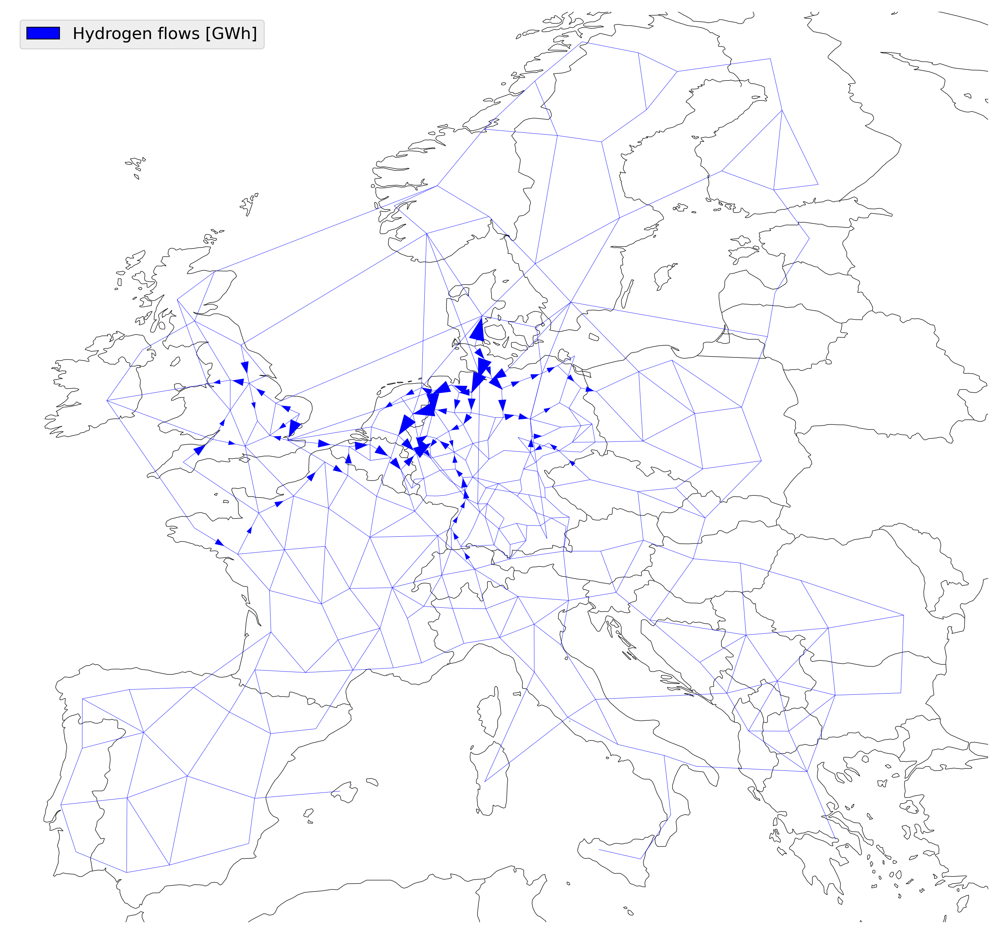

In [69]:
plot_h2_flow(network=case3)

In [255]:
source1 = case1.generators.groupby("carrier").p_nom_opt.sum()
source1


carrier
gas                                          5.875768e+05
offwind-ac                                   1.547564e+04
offwind-dc                                   6.064320e+04
oil                                          4.915276e+05
onwind                                       9.913495e+05
residential rural solar thermal              1.389357e-01
residential urban decentral solar thermal    1.789267e-01
ror                                          4.941759e+04
services rural solar thermal                 1.343394e-01
services urban decentral solar thermal       1.582031e-01
solar                                        1.135743e+06
solar rooftop                                5.021145e+05
urban central solar thermal                  1.134297e+04
Name: p_nom_opt, dtype: float64

C:\Users\quy43055\AppData\Local\Temp\ipykernel_18948\1334825603.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'carrier': 'solar thermal', 'p_nom_opt': solar_thermal}, ignore_index=True)


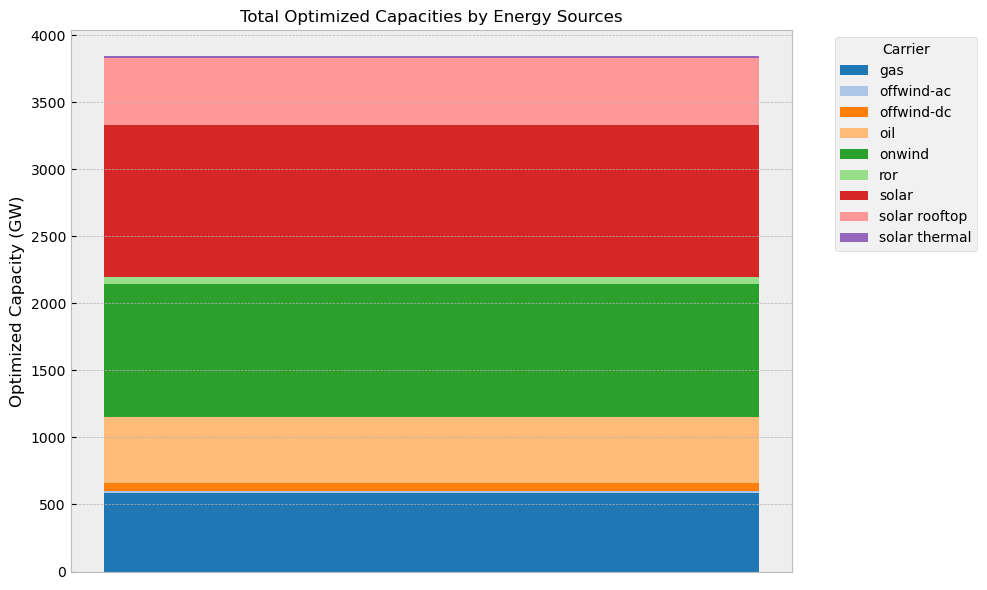

In [258]:
df = pd.DataFrame(source1).reset_index()

# Aggregating all solar thermal values into one carrier
solar_thermal = df[df['carrier'].str.contains('solar thermal')]['p_nom_opt'].sum()

# Replacing the individual solar thermal values with the total and updating the carrier name
df = df[~df['carrier'].str.contains('solar thermal')]
df = df.append({'carrier': 'solar thermal', 'p_nom_opt': solar_thermal}, ignore_index=True)
df['p_nom_opt (GW)'] = df['p_nom_opt'] / (1e3)
df.set_index("carrier", inplace=True)

fig, ax = plt.subplots(figsize=(10,6))
# The bottom parameter for the stacking of bars
cumulative_capacity = 0
color_map = plt.get_cmap('tab20').colors
bar_width = 0.05
#legend_labels = df["carrier"]

# Loop through each renewable source and plot
for idx, (carrier, row) in enumerate(df.iterrows()):
    ax.bar('sources', row['p_nom_opt (GW)'], bottom=cumulative_capacity, color=color_map[idx % len(color_map)], label=carrier, width=bar_width)
    cumulative_capacity += row['p_nom_opt (GW)']

ax.set_ylabel('Optimized Capacity (GW)', fontsize=12)
ax.set_title('Total Optimized Capacities by Energy Sources', fontsize=12)
plt.xticks([]) # Hide x-axis labels
plt.legend(title='Carrier', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()



In [252]:
#df.set_index("carrier", inplace=True)
df['p_nom_opt (GW)']

carrier
gas               587.576761
offwind-ac         15.475643
offwind-dc         60.643199
oil               491.527608
onwind            991.349452
ror                49.417591
solar            1135.743046
solar rooftop     502.114543
solar thermal      11.343578
Name: p_nom_opt (GW), dtype: float64

In [253]:
df

,p_nom_opt,p_nom_opt (GW)
carrier,,
gas,5.875768e+05,587.576761
offwind-ac,1.547564e+04,15.475643
offwind-dc,6.064320e+04,60.643199
oil,4.915276e+05,491.527608
onwind,9.913495e+05,991.349452
ror,4.941759e+04,49.417591
solar,1.135743e+06,1135.743046
solar rooftop,5.021145e+05,502.114543
solar thermal,1.134358e+04,11.343578


### The analysis of the renewables profile shows that:

The total optimized capacity from renewable sources is approximately 2,766,087 MW.
This represents about 71.94% of the total optimized capacity of the system, which is 3,845,191 MW.
The individual contributions of renewable sources to the total optimized capacity are as follows:
Onshore wind (onwind): 25.78%
Offshore wind (AC) (offwind-ac): 0.40%
Offshore wind (DC) (offwind-dc): 1.58%
Solar (excluding thermal): 29.54%
Solar rooftop: 13.06%
Solar thermal total: 0.30%
Run-of-the-river hydro (ror): 1.29%
The renewables profile indicates a strong reliance on renewable energy sources, with solar and wind power leading the contributions. The high percentage of renewables in the energy mix is a positive sign for sustainability and reducing carbon emissions. The system relies significantly on solar power, which includes both utility-scale and rooftop installations, followed by onshore wind power.

The analysis demonstrates a diversified renewable energy portfolio, which is beneficial for the stability and reliability of the energy system since it reduces dependence on a single source of energy and can balance the variability of each renewable resource

In [56]:
# The installed capacity of wind power plant
wind_capacity1 = case1.generators[case1.generators.carrier.isin(['onwind', 'offwind-ac', 'offwind-dc'])].p_nom_opt.sum()
wind_capacity1


1067468.2946209514

In [57]:
# The installed capacity of wind power plant
wind_capacity2 = case2.generators[case2.generators.carrier.isin(['onwind', 'offwind-ac', 'offwind-dc'])].p_nom_opt.sum()
wind_capacity2


1071105.2825549764

In [58]:
# The installed capacity of wind power plant
wind_capacity3 = case3.generators[case3.generators.carrier.isin(['onwind', 'offwind-ac', 'offwind-dc'])].p_nom_opt.sum()
wind_capacity3


1072294.5295123586

In [59]:
# The installed capacity of solar power plant
solar_capacity1 = case1.generators[case1.generators.carrier.isin(['solar'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solar_capacity1


1135743.0455930582

In [60]:
# The installed capacity of solar power plant
solar_capacity2 = case2.generators[case2.generators.carrier.isin(['solar'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solar_capacity2

1136046.6918342973

In [61]:
# The installed capacity of solar power plant
solar_capacity3 = case3.generators[case3.generators.carrier.isin(['solar'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solar_capacity3

1132550.3243379563

In [62]:
# The installed capacity of solar rooftop
solarrooftop_capacity1 = case1.generators[case1.generators.carrier.isin(['solar rooftop'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solarrooftop_capacity1

502114.5434137452

In [63]:
# The installed capacity of solar rooftop
solarrooftop_capacity2 = case2.generators[case2.generators.carrier.isin(['solar rooftop'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solarrooftop_capacity2

502114.540643828

In [64]:
# The installed capacity of solar rooftop
solarrooftop_capacity3 = case3.generators[case3.generators.carrier.isin(['solar rooftop'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solarrooftop_capacity3

502114.5341808127

In [65]:
# The installed capacity of solar thermal
solarthermal_capacity1 = case1.generators[case1.generators.carrier.isin(['residential rural solar thermal', 'services rural solar thermal',
       'residential urban decentral solar thermal',
       'services urban decentral solar thermal',
       'urban central solar thermal'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solarthermal_capacity1

11343.578468331483

In [66]:
# The installed capacity of solar thermal
solarthermal_capacity2 = case2.generators[case2.generators.carrier.isin(['residential rural solar thermal', 'services rural solar thermal',
       'residential urban decentral solar thermal',
       'services urban decentral solar thermal',
       'urban central solar thermal'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solarthermal_capacity2

11102.167492289278

In [67]:
# The installed capacity of solar thermal
solarthermal_capacity3 = case3.generators[case3.generators.carrier.isin(['residential rural solar thermal', 'services rural solar thermal',
       'residential urban decentral solar thermal',
       'services urban decentral solar thermal',
       'urban central solar thermal'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
solarthermal_capacity3

11529.340067662464

In [68]:
# The installed capacity of ror
ror_capacity1 = case1.generators[case1.generators.carrier.isin(['ror'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
ror_capacity1

49417.59091661393

In [69]:
# The installed capacity of ror
ror_capacity2 = case2.generators[case2.generators.carrier.isin(['ror'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
ror_capacity2

49417.59091661393

In [70]:
# The installed capacity of ror
ror_capacity3 = case3.generators[case3.generators.carrier.isin(['ror'])].p_nom_opt.sum() # do I need 'solar thermal' as 'solar power plant'???
ror_capacity3

49417.59091661393

In [71]:
# The installed capacity of electrolysis

electrolysis_capacity1 = case1.links[case1.links.carrier == 'H2 Electrolysis'].p_nom_opt.sum()
electrolysis_capacity1


39999.999926786695

In [72]:
electrolysis_capacity2 = case2.links[case2.links.carrier == 'H2 Electrolysis'].p_nom_opt.sum()
electrolysis_capacity2


39999.999865283346

In [73]:
electrolysis_capacity3 = case3.links[case3.links.carrier == 'H2 Electrolysis'].p_nom_opt.sum()
electrolysis_capacity3


39999.99992063893

In [74]:
# The installed capacity of SMR CC

SMRCC_capacity1 = case1.links[case1.links.carrier == 'SMR CC'].p_nom_opt.sum()
SMRCC_capacity1

35245.61197960891

In [75]:
# The installed capacity of SMR CC

SMRCC_capacity2 = case2.links[case2.links.carrier == 'SMR CC'].p_nom_opt.sum()
SMRCC_capacity2

36599.76097412824

In [76]:
# The installed capacity of SMR CC

SMRCC_capacity3= case3.links[case3.links.carrier == 'SMR CC'].p_nom_opt.sum()
SMRCC_capacity3

37038.185952483735

In [77]:
# The installed capacity of SMR 

SMR_capacity1= case1.links[case1.links.carrier == 'SMR'].p_nom_opt.sum()
SMR_capacity1

11538.557647976408

In [78]:
# The installed capacity of SMR 

SMR_capacity2= case2.links[case2.links.carrier == 'SMR'].p_nom_opt.sum()
SMR_capacity2


0.4124110940589507

In [79]:
# The installed capacity of SMR 

SMR_capacity3= case3.links[case3.links.carrier == 'SMR'].p_nom_opt.sum()
SMR_capacity3


9.793629783411328

In [80]:
# The installed capacity of H2 storage 

H2storage_capacity1= case1.stores[case1.stores.carrier == 'H2 Store'].e_nom_opt.sum()
H2storage_capacity1


54358.872521509424

In [81]:
# The installed capacity of H2 storage 

H2storage_capacity2= case2.stores[case2.stores.carrier == 'H2 Store'].e_nom_opt.sum()
H2storage_capacity2


6596103.080294806

In [82]:
# The installed capacity of H2 storage 

H2storage_capacity3= case3.stores[case3.stores.carrier == 'H2 Store'].e_nom_opt.sum()
H2storage_capacity3


2023245.7564510205

In [83]:
wind_capacity_by_location1 = case1.generators[case1.generators.carrier.isin(['onwind', 'offwind-ac', 'offwind-dc'])].groupby('bus').p_nom_opt.sum()
wind_capacity_by_location1


bus
AL1 0        0.000339
AT1 0    14488.114572
AT1 1       47.292178
AT1 2      308.333932
AT1 3     1031.675057
             ...     
SE2 5    11566.279481
SE2 6     1071.290001
SE2 7     1333.042171
SI1 0        5.350187
SK1 0        3.636215
Name: p_nom_opt, Length: 256, dtype: float64

In [84]:
wind_capacity_by_location2 = case2.generators[case2.generators.carrier.isin(['onwind', 'offwind-ac', 'offwind-dc'])].groupby('bus').p_nom_opt.sum()
wind_capacity_by_location2


bus
AL1 0        0.000411
AT1 0    14525.484970
AT1 1       47.292178
AT1 2      308.333931
AT1 3     1031.675067
             ...     
SE2 5    11578.975972
SE2 6     1071.290001
SE2 7     1333.042537
SI1 0        5.350277
SK1 0        3.636215
Name: p_nom_opt, Length: 256, dtype: float64

In [85]:
wind_capacity_by_location3 = case3.generators[case3.generators.carrier.isin(['onwind', 'offwind-ac', 'offwind-dc'])].groupby('bus').p_nom_opt.sum()
wind_capacity_by_location3


bus
AL1 0        0.000276
AT1 0    14535.117077
AT1 1       47.292178
AT1 2      308.333935
AT1 3     1031.675059
             ...     
SE2 5    11678.280548
SE2 6     1071.290001
SE2 7     1333.041552
SI1 0        5.350161
SK1 0        3.636215
Name: p_nom_opt, Length: 256, dtype: float64

In [86]:
solar_capacity_by_location1 = case1.generators[case1.generators.carrier.isin(['solar'])].groupby('bus').p_nom_opt.sum()
solar_capacity_by_location1

bus
AL1 0    10748.699407
AT1 0      774.636969
AT1 1    20466.622310
AT1 2    26964.669279
AT1 3    10044.306998
             ...     
SE2 5     8151.506750
SE2 6       36.290462
SE2 7       31.925081
SI1 0      266.810005
SK1 0    22191.252124
Name: p_nom_opt, Length: 253, dtype: float64

In [87]:
solar_capacity_by_location2 = case2.generators[case2.generators.carrier.isin(['solar'])].groupby('bus').p_nom_opt.sum()
solar_capacity_by_location2

bus
AL1 0    10717.325995
AT1 0      774.636971
AT1 1    20466.621931
AT1 2    26839.263055
AT1 3    10049.087156
             ...     
SE2 5     8312.625690
SE2 6       36.290464
SE2 7       31.925082
SI1 0      266.810007
SK1 0    22367.236096
Name: p_nom_opt, Length: 253, dtype: float64

In [88]:
solar_capacity_by_location3 = case3.generators[case3.generators.carrier.isin(['solar'])].groupby('bus').p_nom_opt.sum()
solar_capacity_by_location3

bus
AL1 0    10758.990327
AT1 0      774.636969
AT1 1    20466.622230
AT1 2    27053.401006
AT1 3    10057.550465
             ...     
SE2 5     8224.042650
SE2 6       36.290462
SE2 7       31.925081
SI1 0      266.810005
SK1 0    22235.803273
Name: p_nom_opt, Length: 253, dtype: float64

In [89]:
solarrooftop_capacity_by_location1 = case1.generators[case1.generators.carrier.isin(['solar rooftop'])].groupby('bus').p_nom_opt.sum()
solarrooftop_capacity_by_location1.index = solarrooftop_capacity_by_location1.index.str.replace(' low voltage', '')

solarrooftop_capacity_by_location1

bus
AL1 0    2635.169024
AT1 0    4069.464986
AT1 1     559.468257
AT1 2    1544.037075
AT1 3    2457.614479
            ...     
SE2 5    1946.677318
SE2 6       0.004389
SE2 7     139.756294
SI1 0    2277.093705
SK1 0    5427.568724
Name: p_nom_opt, Length: 253, dtype: float64

In [90]:
solarrooftop_capacity_by_location2 = case2.generators[case2.generators.carrier.isin(['solar rooftop'])].groupby('bus').p_nom_opt.sum()
solarrooftop_capacity_by_location2.index = solarrooftop_capacity_by_location2.index.str.replace(' low voltage', '')

solarrooftop_capacity_by_location2

bus
AL1 0    2635.168996
AT1 0    4069.464942
AT1 1     559.468209
AT1 2    1544.037033
AT1 3    2457.614448
            ...     
SE2 5    1946.677295
SE2 6       0.005465
SE2 7     139.756270
SI1 0    2277.093653
SK1 0    5427.568697
Name: p_nom_opt, Length: 253, dtype: float64

In [91]:
solarrooftop_capacity_by_location3 = case3.generators[case3.generators.carrier.isin(['solar rooftop'])].groupby('bus').p_nom_opt.sum()
solarrooftop_capacity_by_location3.index = solarrooftop_capacity_by_location3.index.str.replace(' low voltage', '')

solarrooftop_capacity_by_location3

bus
AL1 0    2635.169014
AT1 0    4069.464979
AT1 1     559.468254
AT1 2    1544.037073
AT1 3    2457.614474
            ...     
SE2 5    1946.677315
SE2 6       0.003531
SE2 7     139.756285
SI1 0    2277.093699
SK1 0    5427.568715
Name: p_nom_opt, Length: 253, dtype: float64

In [92]:
ror_capacity_by_location1 = case1.generators[case1.generators.carrier.isin(['ror'])].groupby('bus').p_nom_opt.sum()

ror_capacity_by_location1

bus
AL1 0      48.200
AT1 0    1130.000
AT1 1     303.000
AT1 2     894.600
AT1 3    2469.900
           ...   
SE2 3     912.000
SE2 6      88.000
SE2 7     212.000
SI1 0     912.275
SK1 0    1363.460
Name: p_nom_opt, Length: 156, dtype: float64

In [93]:
ror_capacity_by_location2 = case2.generators[case2.generators.carrier.isin(['ror'])].groupby('bus').p_nom_opt.sum()

ror_capacity_by_location2

bus
AL1 0      48.200
AT1 0    1130.000
AT1 1     303.000
AT1 2     894.600
AT1 3    2469.900
           ...   
SE2 3     912.000
SE2 6      88.000
SE2 7     212.000
SI1 0     912.275
SK1 0    1363.460
Name: p_nom_opt, Length: 156, dtype: float64

In [94]:
ror_capacity_by_location3 = case3.generators[case3.generators.carrier.isin(['ror'])].groupby('bus').p_nom_opt.sum()

ror_capacity_by_location3

bus
AL1 0      48.200
AT1 0    1130.000
AT1 1     303.000
AT1 2     894.600
AT1 3    2469.900
           ...   
SE2 3     912.000
SE2 6      88.000
SE2 7     212.000
SI1 0     912.275
SK1 0    1363.460
Name: p_nom_opt, Length: 156, dtype: float64

In [95]:
wind_locations1 = case1.buses.loc[wind_capacity_by_location1.index][['x', 'y']]
wind_locations1


,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [96]:
wind_locations2 = case2.buses.loc[wind_capacity_by_location2.index][['x', 'y']]
wind_locations2


,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [97]:
wind_locations3 = case3.buses.loc[wind_capacity_by_location3.index][['x', 'y']]
wind_locations3


,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [98]:
solar_locations1 = case1.buses.loc[solar_capacity_by_location1.index][['x', 'y']]
solar_locations1


,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [99]:
solar_locations2 = case2.buses.loc[solar_capacity_by_location2.index][['x', 'y']]
solar_locations2


,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [100]:
solar_locations3 = case3.buses.loc[solar_capacity_by_location3.index][['x', 'y']]
solar_locations3


,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [101]:
solarrooftop_locations1 = case1.buses.loc[solarrooftop_capacity_by_location1.index][['x', 'y']]
solarrooftop_locations1

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [102]:
solarrooftop_locations2 = case2.buses.loc[solarrooftop_capacity_by_location2.index][['x', 'y']]
solarrooftop_locations2

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [103]:
solarrooftop_locations3 = case3.buses.loc[solarrooftop_capacity_by_location3.index][['x', 'y']]
solarrooftop_locations3

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [104]:
ror_locations1 = case1.buses.loc[ror_capacity_by_location1.index][['x', 'y']]
ror_locations1

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 3,16.490805,63.022760
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [105]:
ror_locations2 = case2.buses.loc[ror_capacity_by_location2.index][['x', 'y']]
ror_locations2

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 3,16.490805,63.022760
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [106]:
ror_locations3 = case3.buses.loc[ror_capacity_by_location3.index][['x', 'y']]
ror_locations3

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 3,16.490805,63.022760
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [107]:
wind_info1 = wind_capacity_by_location1.to_frame(name='capacity_MW').join(wind_locations1)
wind_info1


,capacity_MW,x,y
bus,,,
AL1 0,0.000339,19.897914,41.587568
AT1 0,14488.114572,16.198929,47.889033
AT1 1,47.292178,10.293250,47.248827
AT1 2,308.333932,12.653961,47.511998
AT1 3,1031.675057,14.286742,47.516333
...,...,...,...
SE2 5,11566.279481,14.011055,56.476353
SE2 6,1071.290001,14.314407,63.302363
SE2 7,1333.042171,21.006840,66.234641


In [108]:
wind_info2 = wind_capacity_by_location2.to_frame(name='capacity_MW').join(wind_locations2)
wind_info2


,capacity_MW,x,y
bus,,,
AL1 0,0.000411,19.897914,41.587568
AT1 0,14525.484970,16.198929,47.889033
AT1 1,47.292178,10.293250,47.248827
AT1 2,308.333931,12.653961,47.511998
AT1 3,1031.675067,14.286742,47.516333
...,...,...,...
SE2 5,11578.975972,14.011055,56.476353
SE2 6,1071.290001,14.314407,63.302363
SE2 7,1333.042537,21.006840,66.234641


In [109]:
wind_info3 = wind_capacity_by_location3.to_frame(name='capacity_MW').join(wind_locations3)
wind_info3


,capacity_MW,x,y
bus,,,
AL1 0,0.000276,19.897914,41.587568
AT1 0,14535.117077,16.198929,47.889033
AT1 1,47.292178,10.293250,47.248827
AT1 2,308.333935,12.653961,47.511998
AT1 3,1031.675059,14.286742,47.516333
...,...,...,...
SE2 5,11678.280548,14.011055,56.476353
SE2 6,1071.290001,14.314407,63.302363
SE2 7,1333.041552,21.006840,66.234641


In [110]:
solar_info1 = solar_capacity_by_location1.to_frame(name='capacity_MW').join(solar_locations1)
solar_info1


,capacity_MW,x,y
bus,,,
AL1 0,10748.699407,19.897914,41.587568
AT1 0,774.636969,16.198929,47.889033
AT1 1,20466.622310,10.293250,47.248827
AT1 2,26964.669279,12.653961,47.511998
AT1 3,10044.306998,14.286742,47.516333
...,...,...,...
SE2 5,8151.506750,14.011055,56.476353
SE2 6,36.290462,14.314407,63.302363
SE2 7,31.925081,21.006840,66.234641


In [111]:
solar_info2 = solar_capacity_by_location2.to_frame(name='capacity_MW').join(solar_locations2)
solar_info2


,capacity_MW,x,y
bus,,,
AL1 0,10717.325995,19.897914,41.587568
AT1 0,774.636971,16.198929,47.889033
AT1 1,20466.621931,10.293250,47.248827
AT1 2,26839.263055,12.653961,47.511998
AT1 3,10049.087156,14.286742,47.516333
...,...,...,...
SE2 5,8312.625690,14.011055,56.476353
SE2 6,36.290464,14.314407,63.302363
SE2 7,31.925082,21.006840,66.234641


In [112]:
solar_info3 = solar_capacity_by_location3.to_frame(name='capacity_MW').join(solar_locations3)
solar_info3


,capacity_MW,x,y
bus,,,
AL1 0,10758.990327,19.897914,41.587568
AT1 0,774.636969,16.198929,47.889033
AT1 1,20466.622230,10.293250,47.248827
AT1 2,27053.401006,12.653961,47.511998
AT1 3,10057.550465,14.286742,47.516333
...,...,...,...
SE2 5,8224.042650,14.011055,56.476353
SE2 6,36.290462,14.314407,63.302363
SE2 7,31.925081,21.006840,66.234641


In [113]:
solarrooftop_info1 = solarrooftop_capacity_by_location1.to_frame(name='capacity_MW').join(solarrooftop_locations1)
solarrooftop_info1


,capacity_MW,x,y
bus,,,
AL1 0,2635.169024,19.897914,41.587568
AT1 0,4069.464986,16.198929,47.889033
AT1 1,559.468257,10.293250,47.248827
AT1 2,1544.037075,12.653961,47.511998
AT1 3,2457.614479,14.286742,47.516333
...,...,...,...
SE2 5,1946.677318,14.011055,56.476353
SE2 6,0.004389,14.314407,63.302363
SE2 7,139.756294,21.006840,66.234641


In [114]:
solarrooftop_info2 = solarrooftop_capacity_by_location2.to_frame(name='capacity_MW').join(solarrooftop_locations2)
solarrooftop_info2


,capacity_MW,x,y
bus,,,
AL1 0,2635.168996,19.897914,41.587568
AT1 0,4069.464942,16.198929,47.889033
AT1 1,559.468209,10.293250,47.248827
AT1 2,1544.037033,12.653961,47.511998
AT1 3,2457.614448,14.286742,47.516333
...,...,...,...
SE2 5,1946.677295,14.011055,56.476353
SE2 6,0.005465,14.314407,63.302363
SE2 7,139.756270,21.006840,66.234641


In [115]:
solarrooftop_info3 = solarrooftop_capacity_by_location3.to_frame(name='capacity_MW').join(solarrooftop_locations3)
solarrooftop_info3


,capacity_MW,x,y
bus,,,
AL1 0,2635.169014,19.897914,41.587568
AT1 0,4069.464979,16.198929,47.889033
AT1 1,559.468254,10.293250,47.248827
AT1 2,1544.037073,12.653961,47.511998
AT1 3,2457.614474,14.286742,47.516333
...,...,...,...
SE2 5,1946.677315,14.011055,56.476353
SE2 6,0.003531,14.314407,63.302363
SE2 7,139.756285,21.006840,66.234641


In [116]:
ror_info1 = ror_capacity_by_location1.to_frame(name='capacity_MW').join(ror_locations1)
ror_info1


,capacity_MW,x,y
bus,,,
AL1 0,48.200,19.897914,41.587568
AT1 0,1130.000,16.198929,47.889033
AT1 1,303.000,10.293250,47.248827
AT1 2,894.600,12.653961,47.511998
AT1 3,2469.900,14.286742,47.516333
...,...,...,...
SE2 3,912.000,16.490805,63.022760
SE2 6,88.000,14.314407,63.302363
SE2 7,212.000,21.006840,66.234641


In [117]:
ror_info2 = ror_capacity_by_location2.to_frame(name='capacity_MW').join(ror_locations2)
ror_info2


,capacity_MW,x,y
bus,,,
AL1 0,48.200,19.897914,41.587568
AT1 0,1130.000,16.198929,47.889033
AT1 1,303.000,10.293250,47.248827
AT1 2,894.600,12.653961,47.511998
AT1 3,2469.900,14.286742,47.516333
...,...,...,...
SE2 3,912.000,16.490805,63.022760
SE2 6,88.000,14.314407,63.302363
SE2 7,212.000,21.006840,66.234641


In [118]:
ror_info3 = ror_capacity_by_location3.to_frame(name='capacity_MW').join(ror_locations3)
ror_info3


,capacity_MW,x,y
bus,,,
AL1 0,48.200,19.897914,41.587568
AT1 0,1130.000,16.198929,47.889033
AT1 1,303.000,10.293250,47.248827
AT1 2,894.600,12.653961,47.511998
AT1 3,2469.900,14.286742,47.516333
...,...,...,...
SE2 3,912.000,16.490805,63.022760
SE2 6,88.000,14.314407,63.302363
SE2 7,212.000,21.006840,66.234641


In [119]:
electrolysis_capacity_by_location1 = case1.links[case1.links.carrier == 'H2 Electrolysis'].groupby('bus1').p_nom_opt.sum()
electrolysis_capacity_by_location1.index = electrolysis_capacity_by_location1.index.str.replace(' H2', '')
electrolysis_capacity_by_location1

bus1
AL1 0    0.000658
AT1 0    0.000292
AT1 1    0.000277
AT1 2    0.000282
AT1 3    0.000269
           ...   
SE2 5    0.000471
SE2 6    0.000515
SE2 7    0.000553
SI1 0    0.000305
SK1 0    0.000301
Name: p_nom_opt, Length: 256, dtype: float64

In [120]:
electrolysis_capacity_by_location2 = case2.links[case2.links.carrier == 'H2 Electrolysis'].groupby('bus1').p_nom_opt.sum()
electrolysis_capacity_by_location2.index = electrolysis_capacity_by_location2.index.str.replace(' H2', '')

electrolysis_capacity_by_location2

bus1
AL1 0    0.000510
AT1 0    0.000337
AT1 1    0.000316
AT1 2    0.000318
AT1 3    0.000311
           ...   
SE2 5    0.000613
SE2 6    0.000572
SE2 7    0.000594
SI1 0    0.000328
SK1 0    0.000340
Name: p_nom_opt, Length: 256, dtype: float64

In [121]:
electrolysis_capacity_by_location3 = case3.links[case3.links.carrier == 'H2 Electrolysis'].groupby('bus1').p_nom_opt.sum()
electrolysis_capacity_by_location3.index = electrolysis_capacity_by_location3.index.str.replace(' H2', '')

electrolysis_capacity_by_location3

bus1
AL1 0    0.000339
AT1 0    0.000224
AT1 1    0.000211
AT1 2    0.000213
AT1 3    0.000208
           ...   
SE2 5    0.000413
SE2 6    0.000393
SE2 7    0.000421
SI1 0    0.000222
SK1 0    0.000226
Name: p_nom_opt, Length: 256, dtype: float64

In [122]:
H2storage_capacity_by_location1 = case1.stores[case1.stores.carrier == 'H2 Store'].groupby('bus').e_nom_opt.sum()
H2storage_capacity_by_location1.index = H2storage_capacity_by_location1.index.str.replace(' H2', '')

H2storage_capacity_by_location1

bus
AL1 0    168.400824
AT1 0    600.343629
AT1 1     60.778800
AT1 2    129.783406
AT1 3    633.703863
            ...    
SE2 5    309.794442
SE2 6     12.798203
SE2 7     29.249077
SI1 0    319.357827
SK1 0    567.114290
Name: e_nom_opt, Length: 221, dtype: float64

In [123]:
H2storage_capacity_by_location2 = case2.stores[case2.stores.carrier == 'H2 Store'].groupby('bus').e_nom_opt.sum()
H2storage_capacity_by_location2.index = H2storage_capacity_by_location2.index.str.replace(' H2', '')

H2storage_capacity_by_location2

bus
AL1 0     0.009281
AT1 0     0.028255
AT1 1     0.015796
AT1 2     0.015691
AT1 3     0.025425
           ...    
SE2 5     0.007907
SE2 6     0.096440
SE2 7    13.506375
SI1 0     0.053942
SK1 0     0.026642
Name: e_nom_opt, Length: 248, dtype: float64

In [124]:
H2storage_capacity_by_location3 = case3.stores[case3.stores.carrier == 'H2 Store'].groupby('bus').e_nom_opt.sum()
H2storage_capacity_by_location3.index = H2storage_capacity_by_location3.index.str.replace(' H2', '')

H2storage_capacity_by_location3

bus
AL1 0     0.006377
AT1 0     0.072901
AT1 1     0.018041
AT1 2     0.036987
AT1 3    42.799125
           ...    
SE2 5     0.005330
SE2 6     0.056137
SE2 7    12.891130
SI1 0     0.480441
SK1 0     0.027069
Name: e_nom_opt, Length: 256, dtype: float64

In [125]:
SMRCC_capacity_by_location1 = case1.links[case1.links.carrier == 'SMR CC'].groupby('bus1').p_nom_opt.sum()
SMRCC_capacity_by_location1.index = SMRCC_capacity_by_location1.index.str.replace(' H2', '')

SMRCC_capacity_by_location1

bus1
AL1 0     34.598482
AT1 0    225.512237
AT1 1     25.875518
AT1 2     64.317544
AT1 3    616.030775
            ...    
SE2 5     47.094711
SE2 6      7.138941
SE2 7      4.990073
SI1 0     65.918992
SK1 0    667.364836
Name: p_nom_opt, Length: 256, dtype: float64

In [126]:
SMRCC_capacity_by_location2 = case2.links[case2.links.carrier == 'SMR CC'].groupby('bus1').p_nom_opt.sum()
SMRCC_capacity_by_location2.index = SMRCC_capacity_by_location2.index.str.replace(' H2', '')

SMRCC_capacity_by_location2

bus1
AL1 0     37.704753
AT1 0    250.440677
AT1 1     23.721733
AT1 2     72.685509
AT1 3    641.707587
            ...    
SE2 5      0.009704
SE2 6      2.172701
SE2 7      7.424356
SI1 0     98.243796
SK1 0    690.493635
Name: p_nom_opt, Length: 256, dtype: float64

In [127]:
SMRCC_capacity_by_location3 = case3.links[case3.links.carrier == 'SMR CC'].groupby('bus1').p_nom_opt.sum()
SMRCC_capacity_by_location3.index = SMRCC_capacity_by_location3.index.str.replace(' H2', '')

SMRCC_capacity_by_location3

bus1
AL1 0     37.625947
AT1 0    263.459162
AT1 1     24.713202
AT1 2     78.675980
AT1 3    639.634465
            ...    
SE2 5      0.078951
SE2 6      2.682666
SE2 7      6.888162
SI1 0     93.865156
SK1 0    694.371035
Name: p_nom_opt, Length: 256, dtype: float64

In [128]:
SMR_capacity_by_location1 = case1.links[case1.links.carrier == 'SMR'].groupby('bus1').p_nom_opt.sum()
SMR_capacity_by_location1.index = SMR_capacity_by_location1.index.str.replace(' H2', '')

SMR_capacity_by_location1

bus1
AL1 0     0.209935
AT1 0    26.553147
AT1 1     0.111917
AT1 2    26.963151
AT1 3     3.356446
           ...    
SE2 5     3.009084
SE2 6     1.066860
SE2 7     0.245616
SI1 0    30.997029
SK1 0     5.282010
Name: p_nom_opt, Length: 256, dtype: float64

In [129]:
SMR_capacity_by_location2 = case2.links[case2.links.carrier == 'SMR'].groupby('bus1').p_nom_opt.sum()
SMR_capacity_by_location2.index = SMR_capacity_by_location2.index.str.replace(' H2', '')

SMR_capacity_by_location2

bus1
AL1 0    0.001760
AT1 0    0.001747
AT1 1    0.001673
AT1 2    0.001682
AT1 3    0.001737
           ...   
SE2 5    0.001414
SE2 6    0.001919
SE2 7    0.002329
SI1 0    0.001826
SK1 0    0.001779
Name: p_nom_opt, Length: 256, dtype: float64

In [130]:
SMR_capacity_by_location3 = case3.links[case3.links.carrier == 'SMR'].groupby('bus1').p_nom_opt.sum()
SMR_capacity_by_location3.index = SMR_capacity_by_location3.index.str.replace(' H2', '')

SMR_capacity_by_location3

bus1
AL1 0    0.005631
AT1 0    0.016616
AT1 1    0.007957
AT1 2    0.010875
AT1 3    0.016237
           ...   
SE2 5    0.004597
SE2 6    0.006866
SE2 7    0.047420
SI1 0    0.011502
SK1 0    0.024751
Name: p_nom_opt, Length: 256, dtype: float64

In [131]:
electrolysis_locations2 = case2.buses.loc[electrolysis_capacity_by_location2.index.str.replace(' H2', '')][['x', 'y']]
electrolysis_locations2

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [132]:
electrolysis_locations1 = case1.buses.loc[electrolysis_capacity_by_location1.index.str.replace(' H2', '')][['x', 'y']]
electrolysis_locations1

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [133]:
electrolysis_locations3 = case3.buses.loc[electrolysis_capacity_by_location3.index.str.replace(' H2', '')][['x', 'y']]
electrolysis_locations3

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [134]:
H2storage_locations1 = case1.buses.loc[H2storage_capacity_by_location1.index.str.replace(' H2', '')][['x', 'y']]
H2storage_locations1

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [135]:
H2storage_locations2 = case2.buses.loc[H2storage_capacity_by_location2.index.str.replace(' H2', '')][['x', 'y']]
H2storage_locations2

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [136]:
H2storage_locations3 = case3.buses.loc[H2storage_capacity_by_location3.index.str.replace(' H2', '')][['x', 'y']]
H2storage_locations3

,x,y
bus,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [137]:
SMRCC_locations1 = case1.buses.loc[SMRCC_capacity_by_location1.index.str.replace(' H2', '')][['x', 'y']]
SMRCC_locations1

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [138]:
SMRCC_locations2 = case2.buses.loc[SMRCC_capacity_by_location2.index.str.replace(' H2', '')][['x', 'y']]
SMRCC_locations2

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [139]:
SMRCC_locations3 = case3.buses.loc[SMRCC_capacity_by_location3.index.str.replace(' H2', '')][['x', 'y']]
SMRCC_locations3

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [140]:
SMR_locations1 = case1.buses.loc[SMR_capacity_by_location1.index.str.replace(' H2', '')][['x', 'y']]
SMR_locations1

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [141]:
SMR_locations2 = case2.buses.loc[SMR_capacity_by_location2.index.str.replace(' H2', '')][['x', 'y']]
SMR_locations2

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [142]:
SMR_locations3 = case3.buses.loc[SMR_capacity_by_location3.index.str.replace(' H2', '')][['x', 'y']]
SMR_locations3

,x,y
bus1,,
AL1 0,19.897914,41.587568
AT1 0,16.198929,47.889033
AT1 1,10.293250,47.248827
AT1 2,12.653961,47.511998
AT1 3,14.286742,47.516333
...,...,...
SE2 5,14.011055,56.476353
SE2 6,14.314407,63.302363
SE2 7,21.006840,66.234641


In [143]:
electrolysis_info1 = electrolysis_capacity_by_location1.to_frame(name='capacity_MW').join(electrolysis_locations1)
electrolysis_info1

,capacity_MW,x,y
bus1,,,
AL1 0,0.000658,19.897914,41.587568
AT1 0,0.000292,16.198929,47.889033
AT1 1,0.000277,10.293250,47.248827
AT1 2,0.000282,12.653961,47.511998
AT1 3,0.000269,14.286742,47.516333
...,...,...,...
SE2 5,0.000471,14.011055,56.476353
SE2 6,0.000515,14.314407,63.302363
SE2 7,0.000553,21.006840,66.234641


In [144]:
electrolysis_info2 = electrolysis_capacity_by_location2.to_frame(name='capacity_MW').join(electrolysis_locations2)
electrolysis_info2

,capacity_MW,x,y
bus1,,,
AL1 0,0.000510,19.897914,41.587568
AT1 0,0.000337,16.198929,47.889033
AT1 1,0.000316,10.293250,47.248827
AT1 2,0.000318,12.653961,47.511998
AT1 3,0.000311,14.286742,47.516333
...,...,...,...
SE2 5,0.000613,14.011055,56.476353
SE2 6,0.000572,14.314407,63.302363
SE2 7,0.000594,21.006840,66.234641


In [145]:
electrolysis_info3 = electrolysis_capacity_by_location3.to_frame(name='capacity_MW').join(electrolysis_locations3)
electrolysis_info3

,capacity_MW,x,y
bus1,,,
AL1 0,0.000339,19.897914,41.587568
AT1 0,0.000224,16.198929,47.889033
AT1 1,0.000211,10.293250,47.248827
AT1 2,0.000213,12.653961,47.511998
AT1 3,0.000208,14.286742,47.516333
...,...,...,...
SE2 5,0.000413,14.011055,56.476353
SE2 6,0.000393,14.314407,63.302363
SE2 7,0.000421,21.006840,66.234641


In [146]:
H2storage_info1 = H2storage_capacity_by_location1.to_frame(name='capacity_MWh').join(H2storage_locations1)
H2storage_info1

,capacity_MWh,x,y
bus,,,
AL1 0,168.400824,19.897914,41.587568
AT1 0,600.343629,16.198929,47.889033
AT1 1,60.778800,10.293250,47.248827
AT1 2,129.783406,12.653961,47.511998
AT1 3,633.703863,14.286742,47.516333
...,...,...,...
SE2 5,309.794442,14.011055,56.476353
SE2 6,12.798203,14.314407,63.302363
SE2 7,29.249077,21.006840,66.234641


In [147]:
H2storage_info2 = H2storage_capacity_by_location2.to_frame(name='capacity_MWh').join(H2storage_locations2)
H2storage_info2

,capacity_MWh,x,y
bus,,,
AL1 0,0.009281,19.897914,41.587568
AT1 0,0.028255,16.198929,47.889033
AT1 1,0.015796,10.293250,47.248827
AT1 2,0.015691,12.653961,47.511998
AT1 3,0.025425,14.286742,47.516333
...,...,...,...
SE2 5,0.007907,14.011055,56.476353
SE2 6,0.096440,14.314407,63.302363
SE2 7,13.506375,21.006840,66.234641


In [148]:
H2storage_info3 = H2storage_capacity_by_location3.to_frame(name='capacity_MWh').join(H2storage_locations3)
H2storage_info3

,capacity_MWh,x,y
bus,,,
AL1 0,0.006377,19.897914,41.587568
AT1 0,0.072901,16.198929,47.889033
AT1 1,0.018041,10.293250,47.248827
AT1 2,0.036987,12.653961,47.511998
AT1 3,42.799125,14.286742,47.516333
...,...,...,...
SE2 5,0.005330,14.011055,56.476353
SE2 6,0.056137,14.314407,63.302363
SE2 7,12.891130,21.006840,66.234641


In [149]:
SMRCC_info1 = SMRCC_capacity_by_location1.to_frame(name='capacity_MW').join(SMRCC_locations1)
SMRCC_info1

,capacity_MW,x,y
bus1,,,
AL1 0,34.598482,19.897914,41.587568
AT1 0,225.512237,16.198929,47.889033
AT1 1,25.875518,10.293250,47.248827
AT1 2,64.317544,12.653961,47.511998
AT1 3,616.030775,14.286742,47.516333
...,...,...,...
SE2 5,47.094711,14.011055,56.476353
SE2 6,7.138941,14.314407,63.302363
SE2 7,4.990073,21.006840,66.234641


In [150]:
SMRCC_info2 = SMRCC_capacity_by_location2.to_frame(name='capacity_MW').join(SMRCC_locations2)
SMRCC_info2

,capacity_MW,x,y
bus1,,,
AL1 0,37.704753,19.897914,41.587568
AT1 0,250.440677,16.198929,47.889033
AT1 1,23.721733,10.293250,47.248827
AT1 2,72.685509,12.653961,47.511998
AT1 3,641.707587,14.286742,47.516333
...,...,...,...
SE2 5,0.009704,14.011055,56.476353
SE2 6,2.172701,14.314407,63.302363
SE2 7,7.424356,21.006840,66.234641


In [151]:
SMRCC_info3 = SMRCC_capacity_by_location3.to_frame(name='capacity_MW').join(SMRCC_locations3)
SMRCC_info3

,capacity_MW,x,y
bus1,,,
AL1 0,37.625947,19.897914,41.587568
AT1 0,263.459162,16.198929,47.889033
AT1 1,24.713202,10.293250,47.248827
AT1 2,78.675980,12.653961,47.511998
AT1 3,639.634465,14.286742,47.516333
...,...,...,...
SE2 5,0.078951,14.011055,56.476353
SE2 6,2.682666,14.314407,63.302363
SE2 7,6.888162,21.006840,66.234641


In [152]:
SMR_info1 = SMR_capacity_by_location1.to_frame(name='capacity_MW').join(SMR_locations1)
SMR_info1

,capacity_MW,x,y
bus1,,,
AL1 0,0.209935,19.897914,41.587568
AT1 0,26.553147,16.198929,47.889033
AT1 1,0.111917,10.293250,47.248827
AT1 2,26.963151,12.653961,47.511998
AT1 3,3.356446,14.286742,47.516333
...,...,...,...
SE2 5,3.009084,14.011055,56.476353
SE2 6,1.066860,14.314407,63.302363
SE2 7,0.245616,21.006840,66.234641


In [153]:
SMR_info2 = SMR_capacity_by_location2.to_frame(name='capacity_MW').join(SMR_locations2)
SMR_info2

,capacity_MW,x,y
bus1,,,
AL1 0,0.001760,19.897914,41.587568
AT1 0,0.001747,16.198929,47.889033
AT1 1,0.001673,10.293250,47.248827
AT1 2,0.001682,12.653961,47.511998
AT1 3,0.001737,14.286742,47.516333
...,...,...,...
SE2 5,0.001414,14.011055,56.476353
SE2 6,0.001919,14.314407,63.302363
SE2 7,0.002329,21.006840,66.234641


In [154]:
SMR_info3 = SMR_capacity_by_location3.to_frame(name='capacity_MW').join(SMR_locations3)
SMR_info3

,capacity_MW,x,y
bus1,,,
AL1 0,0.005631,19.897914,41.587568
AT1 0,0.016616,16.198929,47.889033
AT1 1,0.007957,10.293250,47.248827
AT1 2,0.010875,12.653961,47.511998
AT1 3,0.016237,14.286742,47.516333
...,...,...,...
SE2 5,0.004597,14.011055,56.476353
SE2 6,0.006866,14.314407,63.302363
SE2 7,0.047420,21.006840,66.234641


In [173]:
import cartopy.feature as cfeature

C:\Users\quy43055\AppData\Local\Temp\ipykernel_18948\987061867.py:23: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(sc1, ax=ax, orientation='horizontal', shrink=0.5)


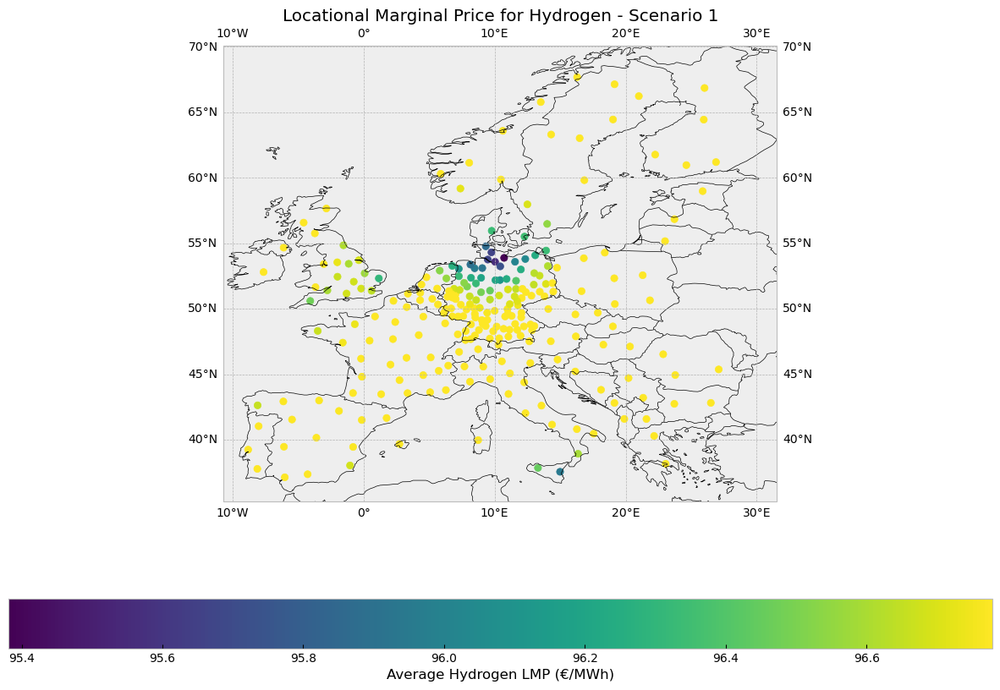

In [174]:
df_AC_1 = case1.buses[case1.buses.carrier == 'AC'].copy()
df_H2_1 = case1.buses[case1.buses.carrier == 'H2'].copy()
df_H2_1.loc[:,'x'] = df_AC_1['x'].values
df_H2_1.loc[:,'y'] = df_AC_1['y'].values

# find LMPs for hydrogen buses
h2_prices1 = case1.buses_t.marginal_price.filter(like="H2")
#h2_price_by_location1 = case1.buses_t[case1.buses_t.carrier == ''].groupby('bus1').p_nom_opt.sum()
#h2_price_by_location1.index = h2_price_by_location1.index.str.replace(' H2', '')

#h2_price_by_location1

# Aggregate the data to get a single price value per bus
mean_h2_prices1 = h2_prices1.mean(axis=0)

fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()})
sc1 = ax.scatter(df_H2_1.x, df_H2_1.y, c=mean_h2_prices1, cmap='viridis', label='H2 LMP')

ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.COASTLINE)

# Add a colorbar to interpret the prices
cbar = plt.colorbar(sc1, ax=ax, orientation='horizontal', shrink=0.5)
cbar.set_label('Average Hydrogen LMP (€/MWh)')

# Set the extent of the map to Europe, or adjust to your specific region
ax.set_extent([-10.67, 31.55, 35.29, 70.09], crs=ccrs.PlateCarree())

ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
plt.title('Locational Marginal Price for Hydrogen - Scenario 1')

plt.show()

C:\Users\quy43055\AppData\Local\Temp\ipykernel_18948\1160445258.py:25: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(sc2, ax=ax, orientation='vertical', shrink=0.5)


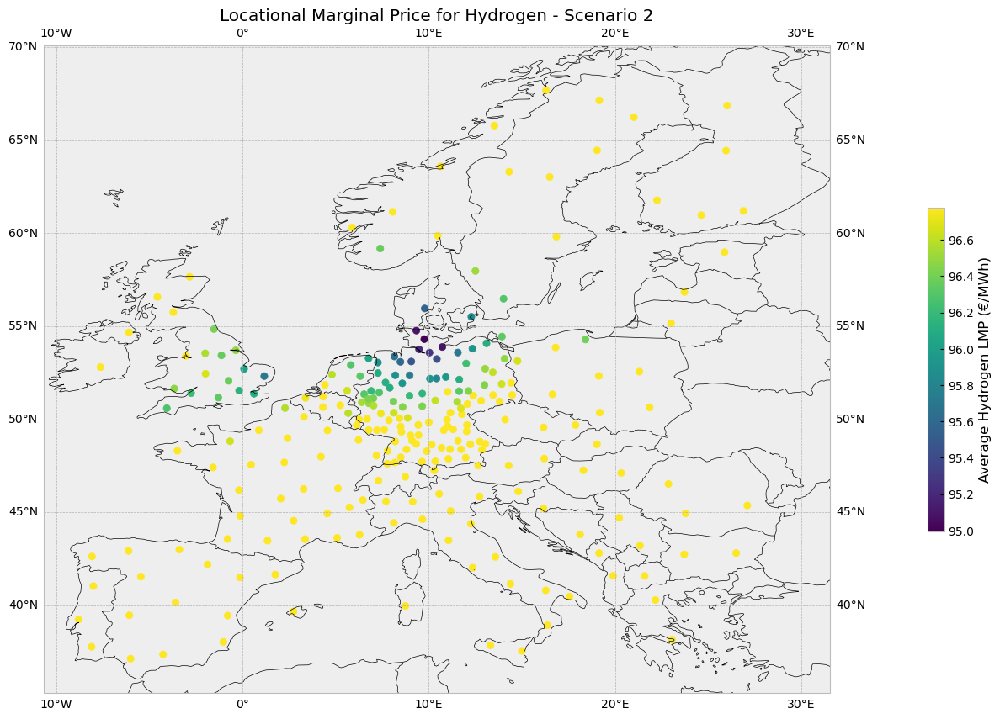

In [175]:
df_AC_2 = case2.buses[case2.buses.carrier == 'AC'].copy()
df_H2_2 = case2.buses[case2.buses.carrier == 'H2'].copy()
df_H2_2.drop(df_H2_2.tail(1).index,inplace=True) # to drop last row (due to unrelated)
df_H2_2.loc[:,'x'] = df_AC_2['x'].values
df_H2_2.loc[:,'y'] = df_AC_2['y'].values

# find LMPs for hydrogen buses
h2_prices2 = case2.buses_t.marginal_price.filter(like="H2")
#h2_price_by_location1 = case1.buses_t[case1.buses_t.carrier == ''].groupby('bus1').p_nom_opt.sum()
#h2_price_by_location1.index = h2_price_by_location1.index.str.replace(' H2', '')

#h2_price_by_location1

# Aggregate the data to get a single price value per bus
mean_h2_prices2 = h2_prices2.mean(axis=0)
mean_h2_prices2.drop(mean_h2_prices2.index[212], inplace=True) # drop unrelated row

fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()})
sc2 = ax.scatter(df_H2_2.x, df_H2_2.y, c=mean_h2_prices2, cmap='viridis', label='H2 LMP')

ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.COASTLINE)

# Add a colorbar to interpret the prices
cbar = plt.colorbar(sc2, ax=ax, orientation='vertical', shrink=0.5)
cbar.set_label('Average Hydrogen LMP (€/MWh)')

# Set the extent of the map to Europe, or adjust to your specific region
ax.set_extent([-10.67, 31.55, 35.29, 70.09], crs=ccrs.PlateCarree())

ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
plt.title('Locational Marginal Price for Hydrogen - Scenario 2')

plt.show()

C:\Users\quy43055\AppData\Local\Temp\ipykernel_18948\2340035238.py:25: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(sc3, ax=ax, orientation='vertical', shrink=0.5)


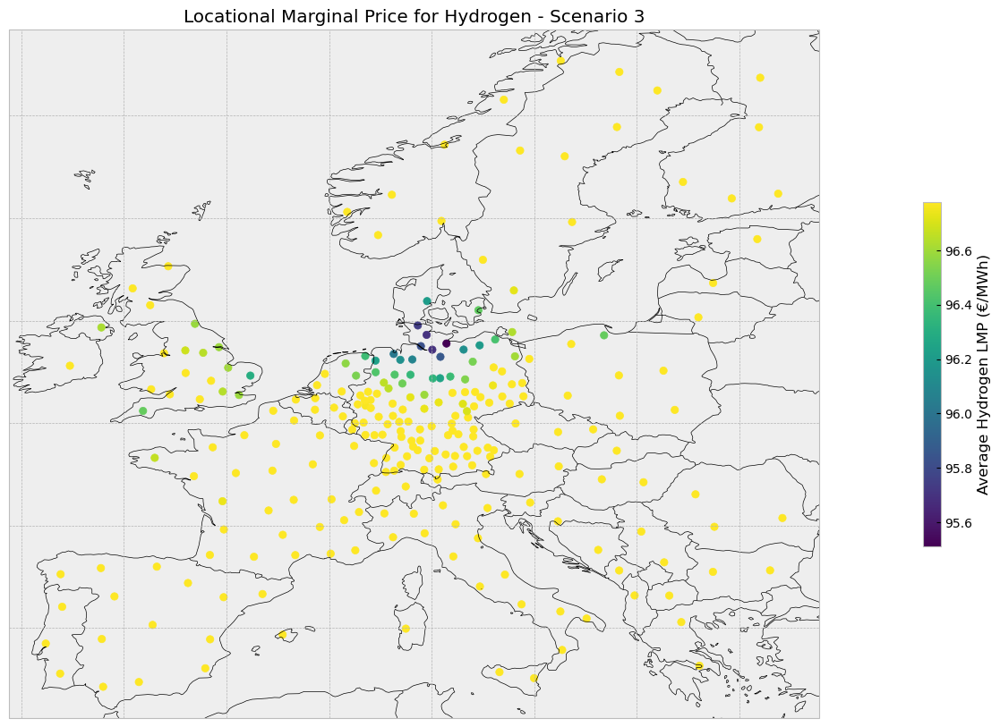

In [176]:
df_AC_3 = case3.buses[case3.buses.carrier == 'AC'].copy()
df_H2_3 = case3.buses[case3.buses.carrier == 'H2'].copy()
#df_H2_2.drop(df_H2_2.tail(1).index,inplace=True) # to drop last row (due to unrelated)
df_H2_3.loc[:,'x'] = df_AC_3['x'].values
df_H2_3.loc[:,'y'] = df_AC_3['y'].values

# find LMPs for hydrogen buses
h2_prices3 = case3.buses_t.marginal_price.filter(like="H2")
#h2_price_by_location1 = case1.buses_t[case1.buses_t.carrier == ''].groupby('bus1').p_nom_opt.sum()
#h2_price_by_location1.index = h2_price_by_location1.index.str.replace(' H2', '')

#h2_price_by_location1

# Aggregate the data to get a single price value per bus
mean_h2_prices3 = h2_prices3.mean(axis=0)
#mean_h2_prices2.drop(mean_h2_prices2.index[212], inplace=True) # drop unrelated row

fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()})
sc3 = ax.scatter(df_H2_3.x, df_H2_3.y, c=mean_h2_prices3, cmap='viridis', label='H2 LMP')

ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.COASTLINE)

# Add a colorbar to interpret the prices
cbar = plt.colorbar(sc3, ax=ax, orientation='vertical', shrink=0.5)
cbar.set_label('Average Hydrogen LMP (€/MWh)')

# Set the extent of the map to Europe, or adjust to your specific region
#ax.set_extent([-10.67, 31.55, 35.29, 70.09], crs=ccrs.PlateCarree())

#ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
ax.gridlines()
plt.title('Locational Marginal Price for Hydrogen - Scenario 3')

plt.show()

C:\Users\quy43055\AppData\Local\Temp\ipykernel_18948\4241530098.py:42: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cbar = plt.colorbar(sc3, ax=axs, orientation='vertical', shrink=0.5, pad=0.1)


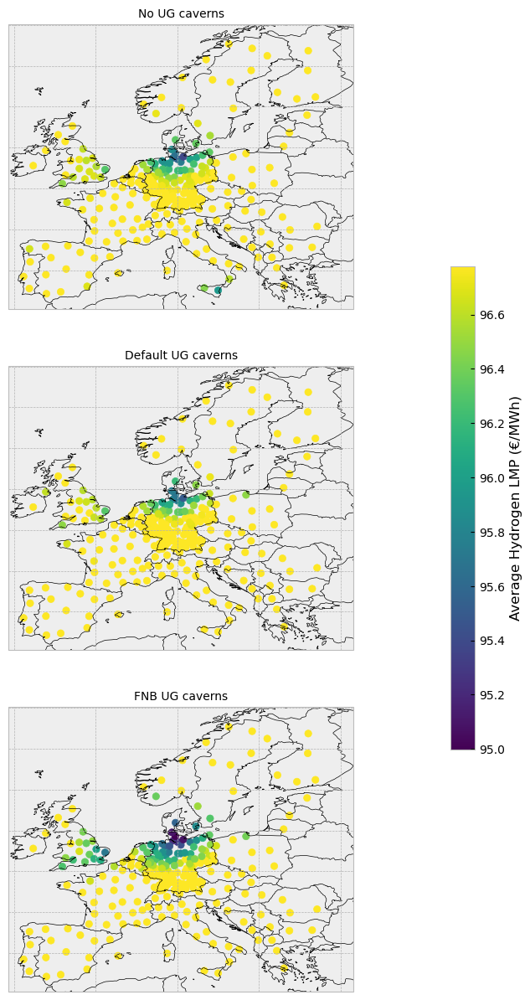

In [181]:


# Create a 1x3 subplot grid for the three cases
fig, axs = plt.subplots(3, 1, figsize=(15, 15), subplot_kw={"projection": ccrs.PlateCarree()})

# Define a common extent for all subplots if needed
common_extent = [-10.67, 31.55, 35.29, 70.09]

# Define a common colorbar scale if needed
# You'll need to know the minimum and maximum values that make sense for your data
vmin = min(mean_h2_prices1.min(), mean_h2_prices2.min(), mean_h2_prices3.min())
vmax = max(mean_h2_prices1.max(), mean_h2_prices2.max(), mean_h2_prices3.max())

# Plot Case 1
sc1 = axs[0].scatter(df_H2_1.x, df_H2_1.y, c=mean_h2_prices1, cmap='viridis', vmin=vmin, vmax=vmax, label='H2 LMP')
axs[0].add_feature(cfeature.BORDERS)
axs[0].add_feature(cfeature.COASTLINE)
axs[0].set_extent(common_extent, crs=ccrs.PlateCarree())
#axs[0].gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
axs[0].gridlines()
axs[0].set_title('No UG caverns', fontsize=10)

# Plot Case 3
sc2 = axs[1].scatter(df_H2_3.x, df_H2_3.y, c=mean_h2_prices3, cmap='viridis', vmin=vmin, vmax=vmax, label='H2 LMP')
axs[1].add_feature(cfeature.BORDERS)
axs[1].add_feature(cfeature.COASTLINE)
axs[1].set_extent(common_extent, crs=ccrs.PlateCarree())
#axs[1].gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
axs[1].gridlines()
axs[1].set_title('Default UG caverns', fontsize=10)

# Plot Case 2
sc3 = axs[2].scatter(df_H2_2.x, df_H2_2.y, c=mean_h2_prices2, cmap='viridis', vmin=vmin, vmax=vmax, label='H2 LMP')
axs[2].add_feature(cfeature.BORDERS)
axs[2].add_feature(cfeature.COASTLINE)
axs[2].set_extent(common_extent, crs=ccrs.PlateCarree())
#axs[2].gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
axs[2].gridlines()
axs[2].set_title('FNB UG caverns', fontsize=10)



# Add a colorbar to the last plot
cbar = plt.colorbar(sc3, ax=axs, orientation='vertical', shrink=0.5, pad=0.1)
cbar.set_label('Average Hydrogen LMP (€/MWh)')

# Set a common label for the y-axis if needed
#fig.text(0.05, 0.5, 'Latitude', va='center', rotation='vertical')

# Set a common label for the x-axis if needed
#fig.text(0.5, 0.04, 'Longitude', ha='center')

plt.show()


In [299]:
# mean load of electricity
case1.lines_t.p0.mean().abs().sum()

440974.13859676674

In [298]:
case3.lines_t.p0.mean().abs().sum()

441264.0670443243

In [297]:
case2.lines_t.p0.mean().abs().sum()

443428.0438147867

In [31]:
# Energy transported via electricity grid
elec1=(case1.snapshot_weightings.generators @ case1.lines_t.p0.abs()).sum()/(1e6) #TWh

In [32]:
# Energy transported via electricity grid
elec3=(case3.snapshot_weightings.generators @ case3.lines_t.p0.abs()).sum()/(1e6) #TWh

In [33]:
# Energy transported via electricity grid
elec2=(case2.snapshot_weightings.generators @ case2.lines_t.p0.abs()).sum()/(1e6) #TWh

In [44]:
# Energy transported via h2 pipelines
case1.buses.drop(case1.buses.index[case1.buses.carrier != "AC"], inplace=True)

case1.mremove("Link", case1.links[~case1.links.carrier.str.contains("H2 pipeline")].index) # remove multiple links that their carriers not containing H2 pips

case1.links.bus0 = case1.links.bus0.str.replace(" H2", "")
case1.links.bus1 = case1.links.bus1.str.replace(" H2", "")

case1.links["flow"] = case1.snapshot_weightings.generators @ case1.links_t.p0 
positive_order = case1.links.bus0 < case1.links.bus1
for idx in case1.links.loc[~positive_order].index:
    case1.links.at[idx, 'bus0'], case1.links.at[idx, 'bus1'] = case1.links.at[idx, 'bus1'], case1.links.at[idx, 'bus0']
    case1.links.at[idx, 'flow'] = -case1.links.at[idx, 'flow']
    #n.links.loc[~positive_order, "flow"] = -n.links.loc[~positive_order, "flow"] # for flow capactity where bus0 > bus1, negative this value
    case1.links.index = case1.links.apply(lambda x: f"H2 pipeline {x.bus0} -> {x.bus1}", axis=1)
    case1.links = case1.links.groupby(case1.links.index).agg(
        dict(flow="sum", bus0="first", bus1="first", carrier="first", p_nom_opt="sum")
    )
case1.links["flow"].sum()
h2_transported1=(case1.snapshot_weightings.generators @ case1.links_t.p0.abs().filter(like="H2 pipeline")).sum()/(1e6) #TWh
h2_transported1

387.09291964615954

In [46]:
# Energy transported via h2 pipelines
case3.buses.drop(case3.buses.index[case3.buses.carrier != "AC"], inplace=True)

case3.mremove("Link", case3.links[~case3.links.carrier.str.contains("H2 pipeline")].index) # remove multiple links that their carriers not containing H2 pips

case3.links.bus0 = case3.links.bus0.str.replace(" H2", "")
case3.links.bus1 = case3.links.bus1.str.replace(" H2", "")

case3.links["flow"] = case3.snapshot_weightings.generators @ case3.links_t.p0 
case3.links["flow"].sum()
h2_transported3=(case3.snapshot_weightings.generators @ case3.links_t.p0.abs().filter(like="H2 pipeline")).sum()/(1e6) #TWh
h2_transported3

668.1181520893364

In [48]:
# Energy transported via h2 pipelines
h2_transported2=(case2.snapshot_weightings.generators @ case2.links_t.p0.abs().filter(like="H2 pipeline")).sum()/(1e6) #TWh
h2_transported2

352.2265586560801

In [49]:
# share of energy transported via h2 grid over via electricity grid
share1=h2_transported1/(elec1+h2_transported1)*100
#share1=h2_transported1/(elec1) *100
share1

5.315824818164212

In [50]:
# share of energy transported via h2 grid over via electricity grid
share3=h2_transported3/(elec3+h2_transported3)*100
#share3=h2_transported3/(elec3)*100

share3

8.833820034567342

In [51]:
# share of energy transported via h2 grid over via electricity grid
share2=h2_transported2/(elec2+h2_transported2)*100
#share2=h2_transported2/(elec2)*100

share2

4.87737818430838

In [52]:
system_cost1=case1.objective/(1e9)
system_cost1

632.0927102410607

In [53]:
system_cost3=case3.objective/(1e9)
system_cost3

631.054481196642

In [54]:
system_cost2=case2.objective/(1e9)
system_cost2

631.3481740498682

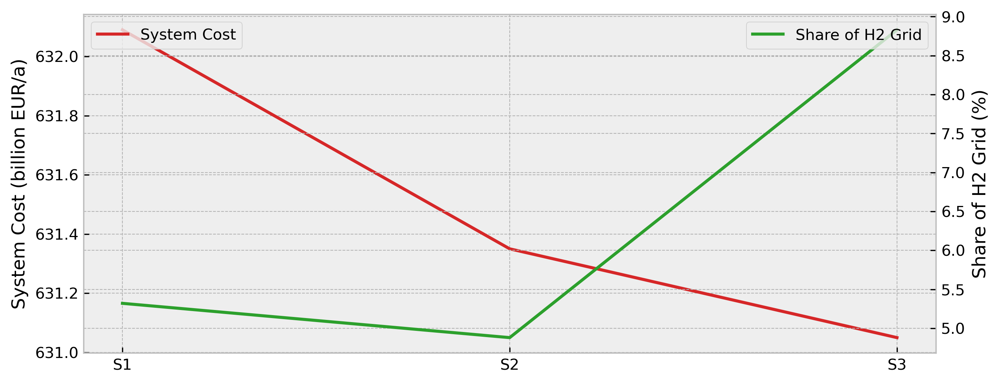

In [58]:
# Data to plot
cases = ['S1', 'S2', 'S3']
system_costs = [round(system_cost1,2),round(system_cost2,2), round(system_cost3,2), ]  # in billion EUR/a
h2_shares = [round(share1,2) , round(share2,2), round(share3,2)]  # in percentage

fig, ax1 = plt.subplots(figsize=(10,4), dpi=300)

# Plotting the system cost
color = 'tab:red'
#ax1.set_xlabel('Scenarios')
ax1.set_ylabel('System Cost (billion EUR/a)', fontsize=12)
ax1.plot(cases, system_costs, color=color, label='System Cost')
ax1.tick_params(axis='y', labelsize=10)

# Create a twin Axes sharing the xaxis
ax2 = ax1.twinx()  

# Plotting the H2 share
color = 'tab:green'
ax2.set_ylabel('Share of H2 Grid (%)', fontsize=12)
ax2.plot(cases, h2_shares, color=color, label='Share of H2 Grid')
ax2.tick_params(axis='y', labelsize=10)

# Title of the plot
#plt.title('System Cost and H2 Share for Each Scenario', fontsize=12)

# Show legend
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

# Show the plot
plt.show()